# Another Simple GAN - MNIST Data set

In this notebook we are going to implement another simple GAN. We will use MNIST Dataset for this model and generate handwritten digits based on the dataset. the deep learning framework used for this task is PyTorch.

## Importing and utility functions

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST # Training dataset
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in a uniform grid.
    '''
    image_unflat = image_tensor.detach().cpu().view(-1, *size)
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

## Creating Generator

The generator class takes 3 inputs; 1. noise vector dimension, 2. image dimension, 3. inner dimension.

For this task we will use a 5-layered network. First 4 layers are similar, they will apply non-linear transformation until the output dimension is as similiar as the MNIST images (which is 28 * 28). The last layer of this network is different from the others. In this layer we don't need batch normlization or activation function, but it should be scaled. In the end we will implement forward function.

In [2]:
class Generator(nn.Module):
    '''
        This is our Generator Class.
        Inputs ->
            noise_dim = dimension of noise vector.
            image_dim = dimension of images fitted for the dataset use,
                mnist use 28 * 28 grayscale images, thus 28 * 28 * 1 = 784
            hidden_dim = default value of inner dimension
    '''
    def __init__(self, noise_dim=10, image_dim=784, hidden_dim=128):
        super(Generator, self).__init__()
        self.block1 = nn.Sequential(
            nn.Linear(noise_dim, hidden_dim),
            nn.BatchNorm1d(hidden_dim),
            nn.ReLU(inplace=True)
        )
        self.block2 = nn.Sequential(
            nn.Linear(hidden_dim, hidden_dim * 2),
            nn.BatchNorm1d(hidden_dim * 2),
            nn.ReLU(inplace=True)
        )
        self.block3 = nn.Sequential(
            nn.Linear(hidden_dim * 2, hidden_dim * 4),
            nn.BatchNorm1d(hidden_dim * 4),
            nn.ReLU(inplace=True)
        )
        self.block4 = nn.Sequential(
            nn.Linear(hidden_dim * 4, hidden_dim * 8),
            nn.BatchNorm1d(hidden_dim * 8),
            nn.ReLU(inplace=True)
        )
        self.block5 = nn.Sequential(
            nn.Linear(hidden_dim * 8, image_dim),
            nn.Sigmoid()
        )
    
    def forward(self, noise):
        '''
            Function for froward pass in our network.
            takes noise as input and returns the image.
            Input ->
                noise = a noise tensor with dimension of (number_samples, noise_dim)
        '''
        out = self.block1(noise)
        out = self.block2(out)
        out = self.block3(out)
        out = self.block4(out)
        out = self.block5(out)
        
        return out



## Creating Noise

To be able to use generator, we need to be able to create noise vector. this noise vector plays an important role, with apropriate use of this concept we can make sure that our generated images are not from a class all the time. Since we are using batch approach, in each step we need to be able to generate multiple noise vectors, thus we will use a function to achieve this.

In [3]:
def get_noise(number_samples, noise_dim, device):
    '''
        Function for creating noise vector with given dimension
            (number_samples, noise_dim),
        Inputs ->
            number_samples = number of samples to geneare
            noise_dim = dimension of the noise vector
    '''
    return torch.randn(number_samples, noise_dim, device=device)

# Creating Discriminator

In this section we are going to create the second component of the network, Discriminator. The Discriminator will take 2 inputs: 1. image dimension, 2. hidden dimension.

For this example we will use a 4-layered discriminator. It start with image tensor and transforms it until it returns a single number or in other words, 1-dimension tensor. this outputs simply classifies that whether the input image is original or generated, and finally in forward pass of this network, that takes an image tensor to be classified.

Have in mind that we don't need a sigmoid function after output layer since its already implemented in loss function.

In [4]:
class Discriminator(nn.Module):
    '''
        The Discriminator Class
        Inputs ->
            image_dim = dimension of images fitted for the dataset use,
                mnist use 28 * 28 grayscale images, thus 28 * 28 * 1 = 784
            hidden_dim = default value of inner dimension
    '''
    def __init__(self, image_dim=784, hidden_dim=128):
        super(Discriminator, self).__init__()
        self.block1 = nn.Sequential(
            nn.Linear(image_dim, hidden_dim * 4),
            nn.LeakyReLU(negative_slope=.2)
        )
        self.block2 = nn.Sequential(
            nn.Linear(hidden_dim * 4, hidden_dim * 2),
            nn.LeakyReLU(negative_slope=.2)
        )
        self.block3 = nn.Sequential(
            nn.Linear(hidden_dim * 2, hidden_dim),
            nn.LeakyReLU(negative_slope=.2)
        )
        self.block4 = nn.Linear(hidden_dim, 1)
    
    def forward(self, image):
        '''
            This function is for forward pass of the discriminator.
            Given an image tensor, it returs a 1-dimension tensor representing
            wheteher an image is original or generated.
            Inputs ->
                Flattened image tensor with dimension of (image_dim)
        '''
        out = self.block1(image)
        out = self.block2(out)
        out = self.block3(out)
        out = self.block4(out)
        return out

## Training Phase

Before we start the training phase, we need to address some hyperparameters which is listed below:

- criterion: the loss function we want to use.
- n_epochs: the number of times we want to iterate through the entire dataset in training phase, epochs
- noise_dim: dimension of the noise vector
- display_step: in what frequency model show the generated images from trained generator
- batch_size: number of images for each batch (per forward/backward pass)
- lr: the learning rate
- device: the device type which we wants to perform training on

also in this step we will load the MNIST dataset as tensors using a data loader.

In [5]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 500
noise_dim = 64
display_step = 500
batch_size = 128
lr = .00001
device = 'cuda'

dataloader = DataLoader(
    MNIST('./data', download=True, transform=transforms.ToTensor()),
    batch_size=batch_size, shuffle=True)


Now, we can initialize! we need to initialize generator, discriminator and optimizers. Since each optimizer only takes the parameters of one particular model, we need 2 optimizers; one for generator and one for discriminator.

In [6]:
gen = Generator(noise_dim).to(device)
disc = Discriminator().to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

Before we train the GAN, we might need to calculate the discriminator's and generator's loss. this is the way how we, discriminator and generator will know how well they are performing and improve themselves.

**IMPORTANT**: generator is needed when want to calculate discriminator's loss, so we have to use .detach() on the generator result so we its parameters won't get updated in discriminator's backward pass.

In [7]:
def disc_loss(gen, disc, criterion, original, num_images, noise_dim, device):
    '''
        Return the loss of discriminator
        Inputs -> 
            gen = generator model, this returns an image given noise
            disc = discriminator model, this returns prediction
            criterion = loss function, this is used for comparing discriminator's
                prediction to the ground truth; generated = 0 and original = 1
            original = a batch of original images
            num_images = number of images generated should produce. also the length
                of original images.
            noise_dim = dimension of noise vector
            device = the device type
        Returns ->
            disc_loss = loss value for current batch, torch scaler type
    '''
    noise_vec = get_noise(num_images, noise_dim, device)
    gen_image = gen(noise_vec).detach()
    gen_labels = torch.zeros(num_images, 1, device=device)
    gen_pred = disc(gen_image)
    gen_img_loss = criterion(gen_pred, gen_labels)
    org_labels = torch.ones(num_images, 1, device=device)
    org_pred = disc(original)
    org_img_loss = criterion(org_pred, org_labels)
    disc_loss = (org_img_loss + gen_img_loss) / 2
    return disc_loss

In [8]:
def gen_loss(gen, disc, criterion, num_images, noise_dim, device):
    '''
        Return the loss of generator
        Inputs -> 
            gen = generator model, this returns an image given noise
            disc = discriminator model, this returns prediction
            criterion = loss function, this is used for comparing discriminator's
                prediction to the ground truth; generated = 0 and original = 1
            num_images = number of images generated should produce. also the length
                of original images.
            noise_dim = dimension of noise vector
            device = the device type
        Returns ->
            gen_loss = loss value for current batch, torch scaler type
    '''
    noise_vec = get_noise(num_images, noise_dim, device)
    gen_img = gen(noise_vec)
    gen_img_pred = disc(gen_img)
    gen_labels = torch.ones(num_images, 1, device=device)
    gen_loss = criterion(gen_img_pred, gen_labels)
    return gen_loss

## Putting everything together

Finally we can put everything together! in each epoch, we will process the entire dataset in batches, and for each batch we need to update the discriminator and generator, with utilizing their loss. batches are sets of images that will be predicted on before the loss functions are calculated instead of calculating the loss function for each image. a loss greater than 1 is okay, since BCE can be any positive number for a sufficiently confident wrong guess.

Often in the beginning the discriminator will outperform the generator, because its job is easier. it's important that neither of them gets too good, since this might cause the entire model to stop learning. balancing the two models is actually very hard to do in a standatd GAN.

  6%|▋         | 30/469 [00:00<00:12, 34.29it/s]

Epoch 1, step 500 -> generator loss: 0.5948855748176572, discriminator loss: 0.5996641601324079


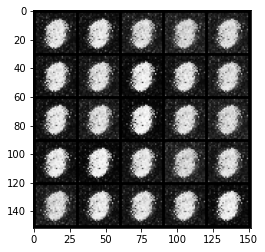

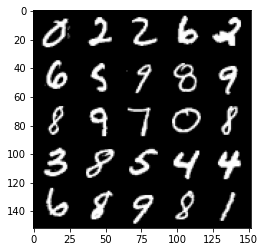

 13%|█▎        | 59/469 [00:01<00:11, 36.32it/s]

Epoch 2, step 1000 -> generator loss: 0.6145435650348663, discriminator loss: 0.5045280783772468


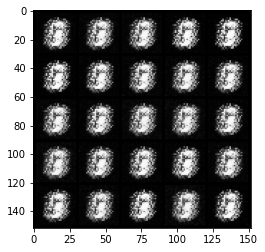

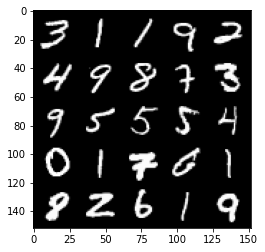

 19%|█▉        | 89/469 [00:02<00:09, 39.60it/s]

Epoch 3, step 1500 -> generator loss: 0.6293495990037916, discriminator loss: 0.443929185450077


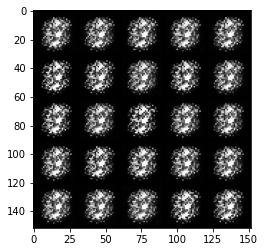

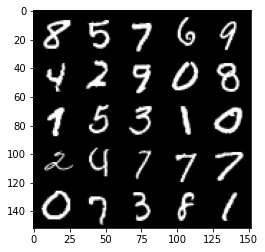

 26%|██▌       | 120/469 [00:03<00:08, 39.38it/s]

Epoch 4, step 2000 -> generator loss: 0.6470194835662839, discriminator loss: 0.41022572678327557


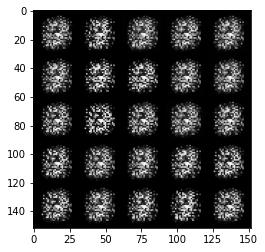

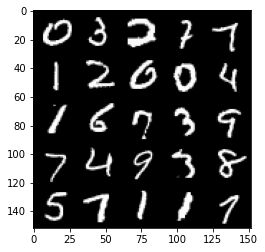

 33%|███▎      | 154/469 [00:04<00:09, 32.76it/s]

Epoch 5, step 2500 -> generator loss: 0.6528190158605572, discriminator loss: 0.40459674501419074


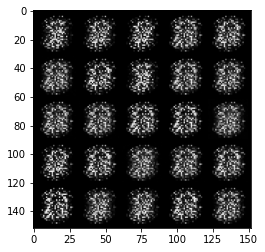

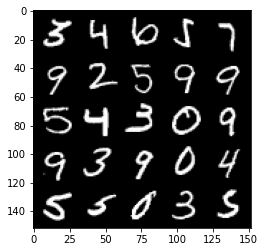

 40%|███▉      | 186/469 [00:04<00:07, 39.51it/s]

Epoch 6, step 3000 -> generator loss: 0.6332929872274397, discriminator loss: 0.42416767030954355


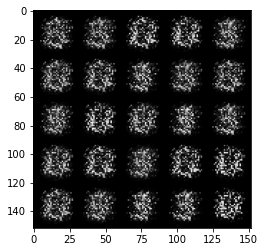

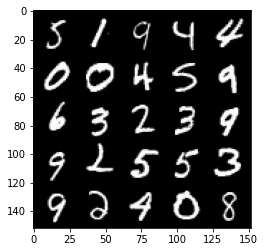

 46%|████▋     | 217/469 [00:06<00:07, 34.46it/s]

Epoch 7, step 3500 -> generator loss: 0.6181684705018995, discriminator loss: 0.4367116614580157


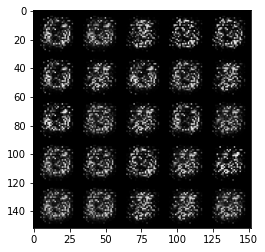

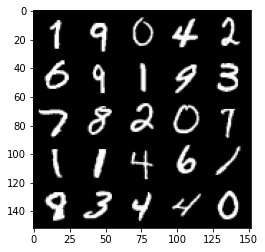

 53%|█████▎    | 248/469 [00:07<00:06, 35.77it/s]

Epoch 8, step 4000 -> generator loss: 0.6183012154102324, discriminator loss: 0.4383009875416753


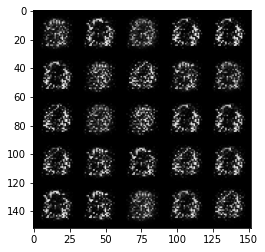

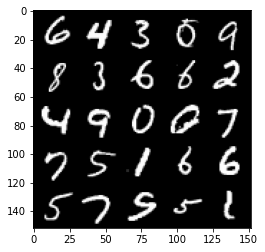

 59%|█████▉    | 278/469 [00:07<00:04, 40.34it/s]

Epoch 9, step 4500 -> generator loss: 0.6061657412052163, discriminator loss: 0.44018149769306186


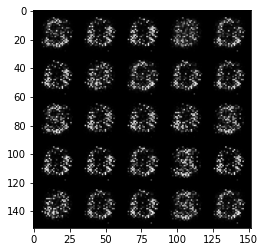

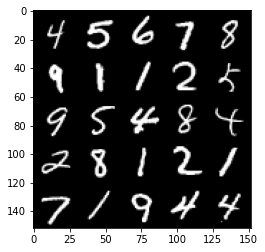

 66%|██████▌   | 310/469 [00:07<00:03, 41.15it/s]

Epoch 10, step 5000 -> generator loss: 0.6110904631614683, discriminator loss: 0.432901383519173


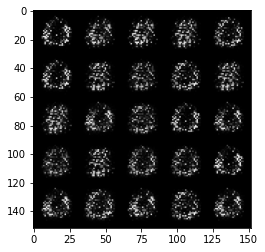

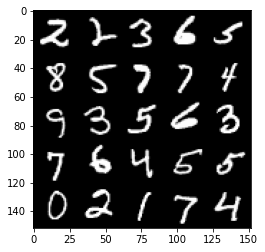

 72%|███████▏  | 339/469 [00:08<00:03, 38.84it/s]

Epoch 11, step 5500 -> generator loss: 0.603507486701012, discriminator loss: 0.4326333569884303


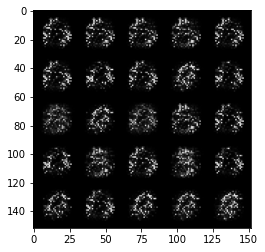

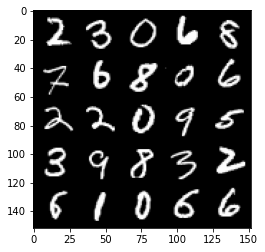

 79%|███████▉  | 371/469 [00:09<00:02, 38.23it/s]

Epoch 12, step 6000 -> generator loss: 0.6211293803453437, discriminator loss: 0.415567432463169


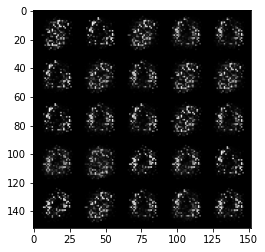

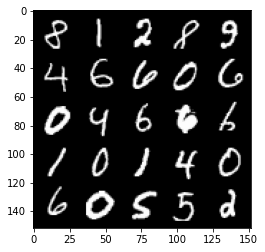

 86%|████████▌ | 403/469 [00:10<00:01, 39.67it/s]

Epoch 13, step 6500 -> generator loss: 0.6287922409772876, discriminator loss: 0.4089787392616271


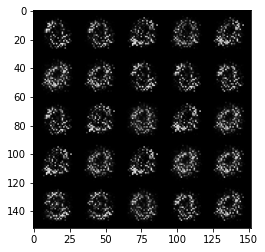

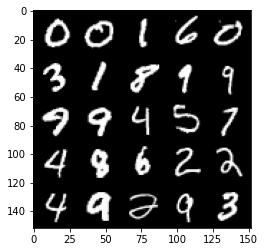

 93%|█████████▎| 434/469 [00:11<00:00, 38.72it/s]

Epoch 14, step 7000 -> generator loss: 0.6277744151353839, discriminator loss: 0.41991701936721776


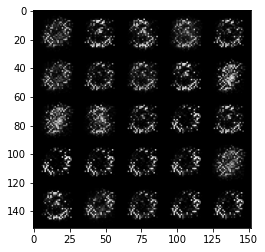

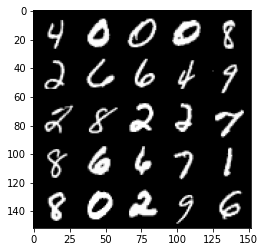

 99%|█████████▊| 463/469 [00:12<00:00, 36.18it/s]

Epoch 15, step 7500 -> generator loss: 0.6357353156805037, discriminator loss: 0.41030063003301614


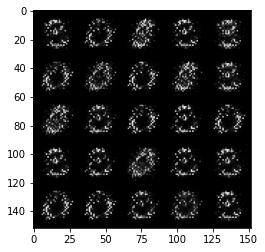

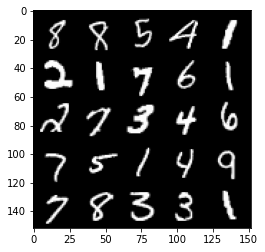

  5%|▌         | 25/469 [00:00<00:13, 33.33it/s]

Epoch 17, step 8000 -> generator loss: 0.6480212491750714, discriminator loss: 0.4006625426411628


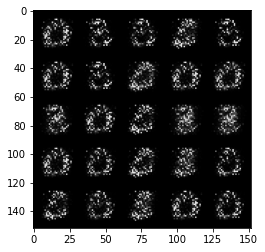

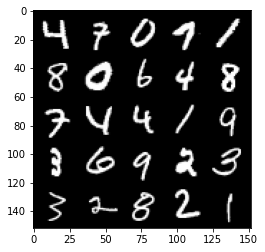

 12%|█▏        | 56/469 [00:02<00:17, 24.01it/s]

Epoch 18, step 8500 -> generator loss: 0.6508094284534455, discriminator loss: 0.3988521857857703


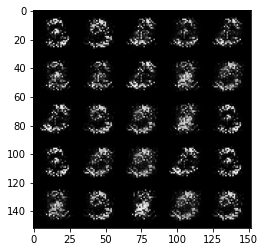

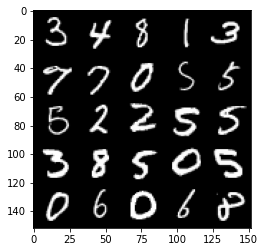

 19%|█▊        | 87/469 [00:02<00:12, 29.86it/s]

Epoch 19, step 9000 -> generator loss: 0.6476687543392179, discriminator loss: 0.40547049945592867


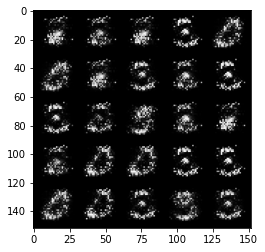

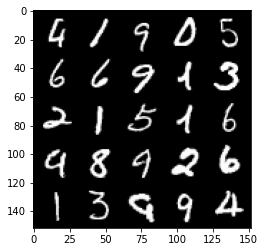

 25%|██▍       | 117/469 [00:03<00:11, 30.65it/s]

Epoch 20, step 9500 -> generator loss: 0.6263773965835563, discriminator loss: 0.429028780758381


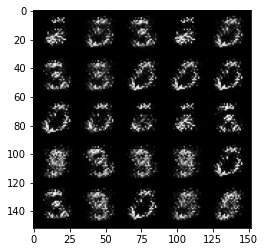

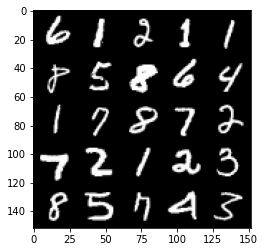

 32%|███▏      | 150/469 [00:04<00:10, 30.78it/s]

Epoch 21, step 10000 -> generator loss: 0.6378188629150393, discriminator loss: 0.4178033574223518


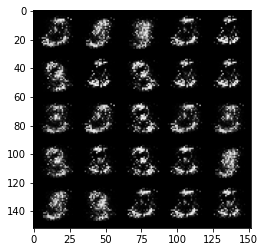

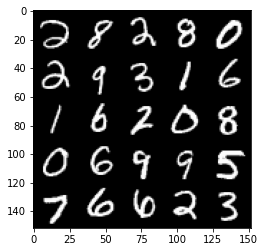

 38%|███▊      | 180/469 [00:05<00:09, 30.72it/s]

Epoch 22, step 10500 -> generator loss: 0.6371684826612473, discriminator loss: 0.4204883126020428


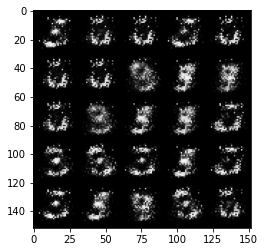

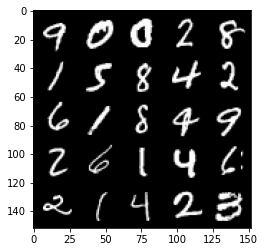

 45%|████▍     | 210/469 [00:06<00:08, 29.98it/s]

Epoch 23, step 11000 -> generator loss: 0.6414808001518248, discriminator loss: 0.416898495972157


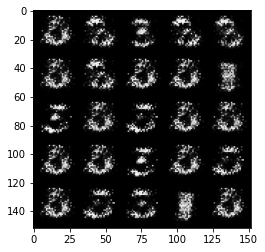

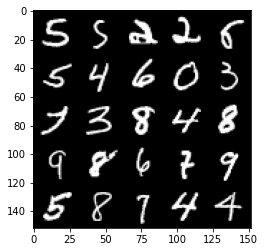

 52%|█████▏    | 242/469 [00:10<00:09, 24.55it/s]

Epoch 24, step 11500 -> generator loss: 0.6606048482656481, discriminator loss: 0.3999517684578898


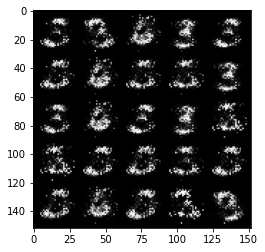

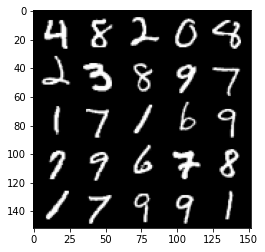

 58%|█████▊    | 272/469 [00:09<00:06, 31.30it/s]

Epoch 25, step 12000 -> generator loss: 0.6545762331485752, discriminator loss: 0.4011338326334951


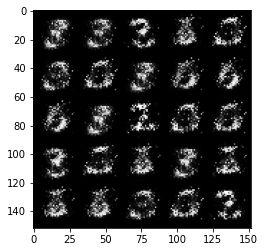

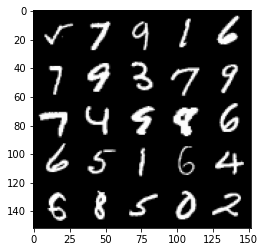

 65%|██████▍   | 303/469 [00:10<00:05, 28.68it/s]

Epoch 26, step 12500 -> generator loss: 0.6443395385742186, discriminator loss: 0.42547081577777823


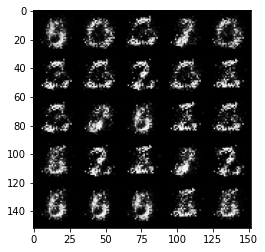

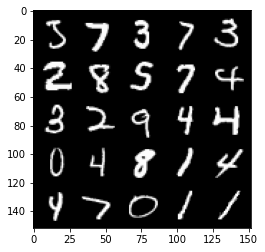

 71%|███████▏  | 335/469 [00:13<00:05, 24.68it/s]

Epoch 27, step 13000 -> generator loss: 0.6299353835582733, discriminator loss: 0.4443223392367364


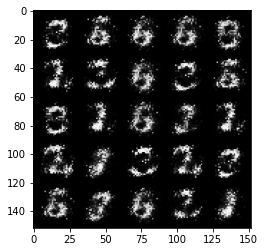

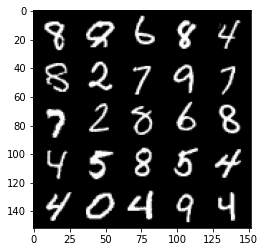

 78%|███████▊  | 366/469 [00:12<00:03, 30.39it/s]

Epoch 28, step 13500 -> generator loss: 0.6209506373405462, discriminator loss: 0.44798459279537195


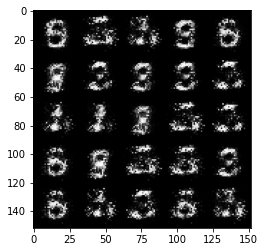

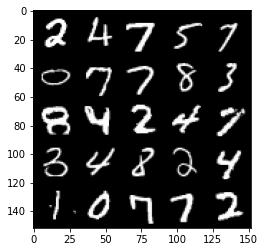

 85%|████████▍ | 398/469 [00:13<00:02, 26.17it/s]

Epoch 29, step 14000 -> generator loss: 0.6310543112754816, discriminator loss: 0.43897360658645623


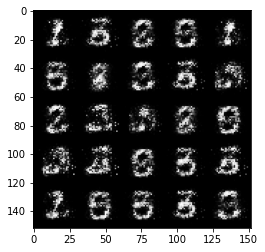

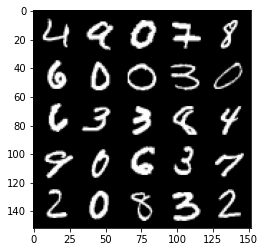

 91%|█████████▏| 428/469 [00:17<00:01, 24.27it/s]

Epoch 30, step 14500 -> generator loss: 0.6266686946153641, discriminator loss: 0.4553236822485924


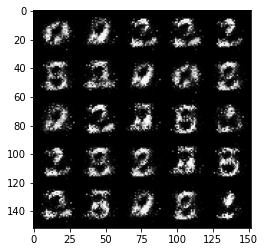

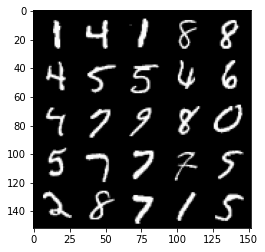

 98%|█████████▊| 461/469 [00:15<00:00, 30.41it/s]

Epoch 31, step 15000 -> generator loss: 0.6066862144470211, discriminator loss: 0.47411594843864446


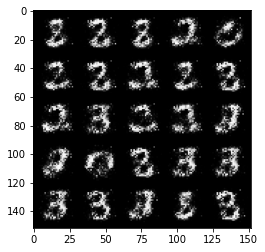

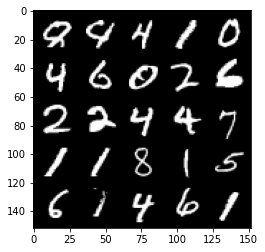

  5%|▍         | 23/469 [00:00<00:18, 23.84it/s]

Epoch 33, step 15500 -> generator loss: 0.5994029290676121, discriminator loss: 0.4808064251542088


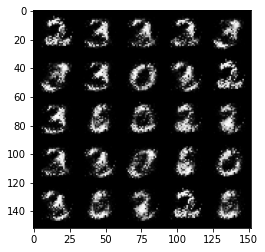

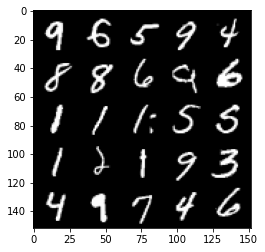

 11%|█▏        | 53/469 [00:02<00:17, 24.08it/s]

Epoch 34, step 16000 -> generator loss: 0.5961151829957962, discriminator loss: 0.47980305391550077


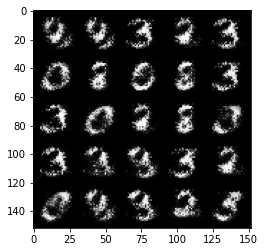

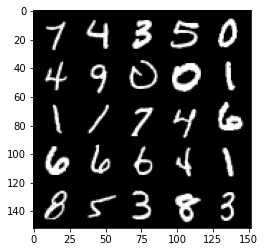

 17%|█▋        | 82/469 [00:02<00:13, 28.75it/s]

Epoch 35, step 16500 -> generator loss: 0.6093529907464981, discriminator loss: 0.4700589360594748


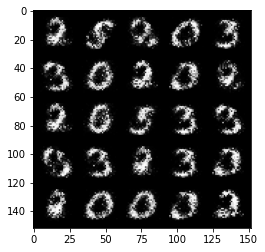

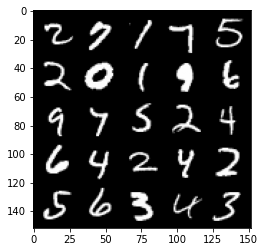

 25%|██▍       | 116/469 [00:04<00:14, 24.48it/s]

Epoch 36, step 17000 -> generator loss: 0.6024282143116003, discriminator loss: 0.47817954123020173


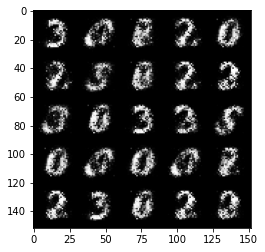

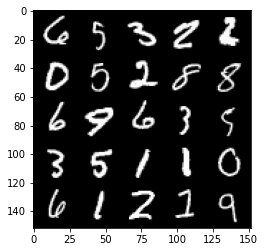

 31%|███       | 146/469 [00:05<00:13, 24.18it/s]

Epoch 37, step 17500 -> generator loss: 0.5966025148630136, discriminator loss: 0.48661419409513457


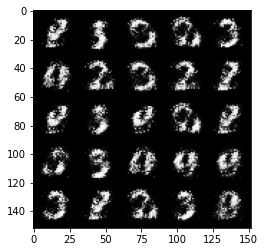

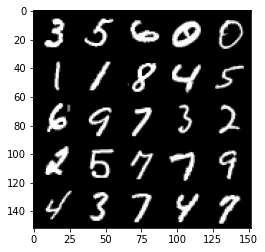

 38%|███▊      | 177/469 [00:07<00:11, 24.38it/s]

Epoch 38, step 18000 -> generator loss: 0.5923645761013037, discriminator loss: 0.49305118447542184


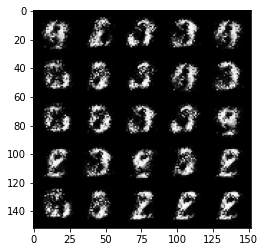

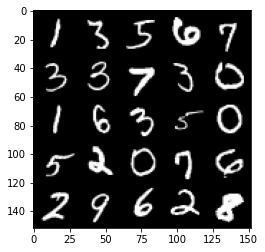

 44%|████▍     | 207/469 [00:06<00:08, 30.56it/s]

Epoch 39, step 18500 -> generator loss: 0.6025603252649305, discriminator loss: 0.4847050079703329


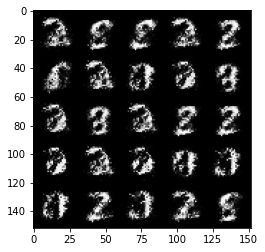

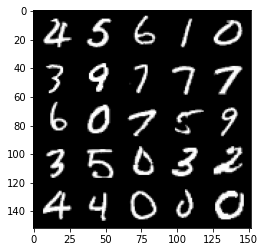

 51%|█████     | 239/469 [00:09<00:09, 24.08it/s]

Epoch 40, step 19000 -> generator loss: 0.6118870463371276, discriminator loss: 0.46719223231077217


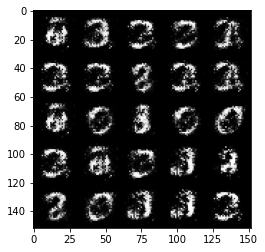

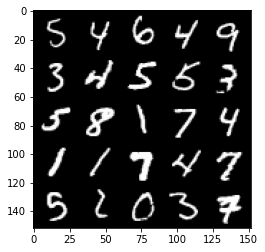

 58%|█████▊    | 270/469 [00:10<00:07, 24.91it/s]

Epoch 41, step 19500 -> generator loss: 0.6090959961414342, discriminator loss: 0.46739683914184554


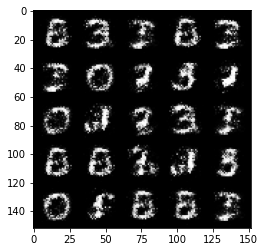

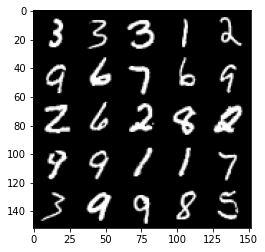

 64%|██████▍   | 300/469 [00:11<00:07, 23.95it/s]

Epoch 42, step 20000 -> generator loss: 0.6064034118652339, discriminator loss: 0.47717352026700965


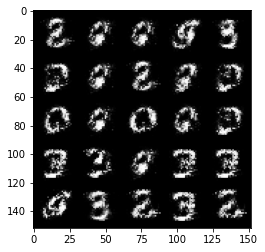

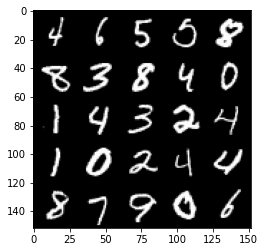

 71%|███████   | 331/469 [00:11<00:05, 24.22it/s]

Epoch 43, step 20500 -> generator loss: 0.6003034179210667, discriminator loss: 0.4817553200721743


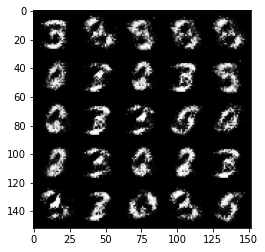

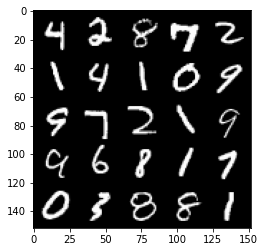

 77%|███████▋  | 363/469 [00:13<00:04, 23.05it/s]

Epoch 44, step 21000 -> generator loss: 0.6030395020246505, discriminator loss: 0.4832029744982718


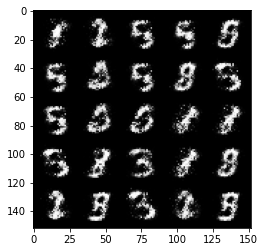

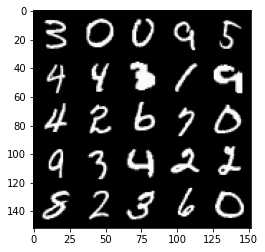

 84%|████████▍ | 394/469 [00:14<00:02, 28.30it/s]

Epoch 45, step 21500 -> generator loss: 0.6041541168689719, discriminator loss: 0.4837688566446303


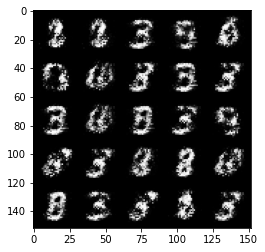

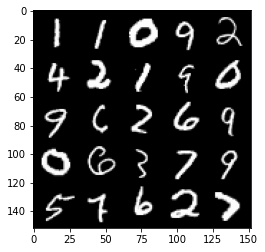

 91%|█████████ | 426/469 [00:17<00:01, 23.90it/s]

Epoch 46, step 22000 -> generator loss: 0.5994977558851241, discriminator loss: 0.48970739644765876


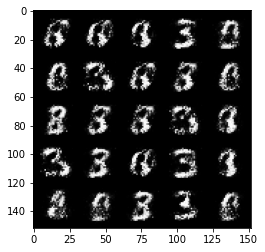

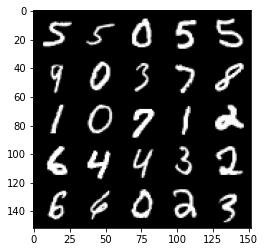

 97%|█████████▋| 455/469 [00:15<00:00, 25.38it/s]

Epoch 47, step 22500 -> generator loss: 0.592419753670693, discriminator loss: 0.49336460965871837


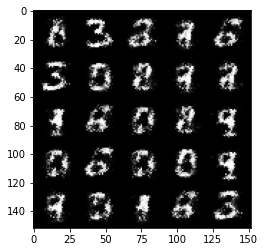

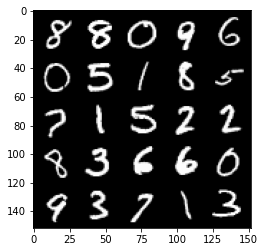

  4%|▎         | 17/469 [00:00<00:18, 24.04it/s]

Epoch 49, step 23000 -> generator loss: 0.5991580364704132, discriminator loss: 0.48379037511348727


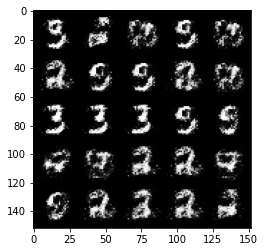

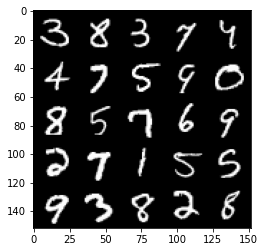

 10%|█         | 48/469 [00:01<00:15, 27.17it/s]

Epoch 50, step 23500 -> generator loss: 0.5954998936653138, discriminator loss: 0.4901607058644295


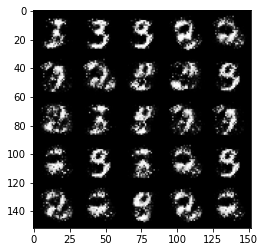

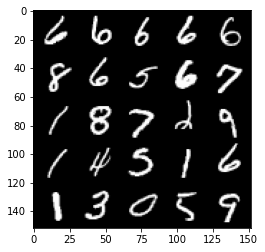

 17%|█▋        | 80/469 [00:03<00:15, 24.40it/s]

Epoch 51, step 24000 -> generator loss: 0.5994098718166357, discriminator loss: 0.49040900659561143


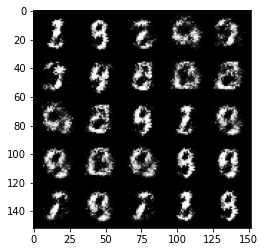

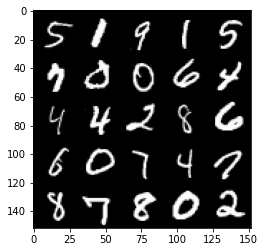

 24%|██▍       | 112/469 [00:04<00:14, 24.38it/s]

Epoch 52, step 24500 -> generator loss: 0.5926110931634897, discriminator loss: 0.494263038337231


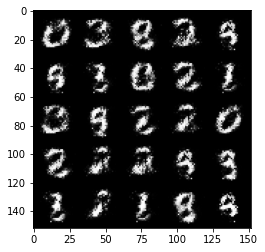

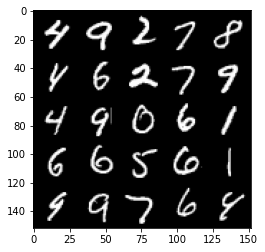

 30%|███       | 141/469 [00:06<00:13, 24.35it/s]

Epoch 53, step 25000 -> generator loss: 0.6057663433551781, discriminator loss: 0.4869524683952327


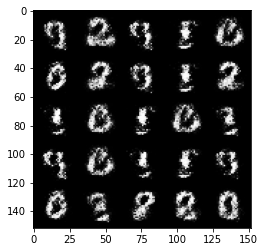

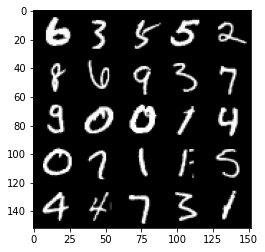

 37%|███▋      | 173/469 [00:06<00:12, 23.21it/s]

Epoch 54, step 25500 -> generator loss: 0.5989289593696588, discriminator loss: 0.49274000465869905


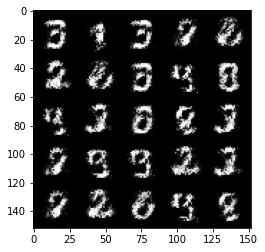

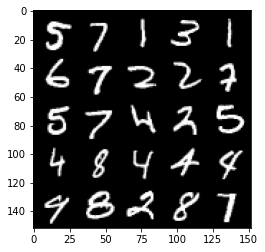

 43%|████▎     | 204/469 [00:08<00:10, 24.40it/s]

Epoch 55, step 26000 -> generator loss: 0.5906536033153537, discriminator loss: 0.5029146701693537


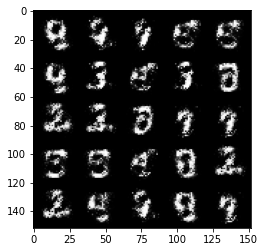

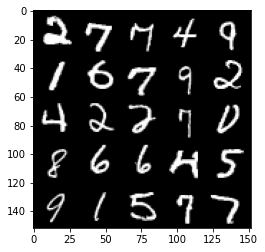

 50%|█████     | 236/469 [00:08<00:09, 24.71it/s]

Epoch 56, step 26500 -> generator loss: 0.6070709888935091, discriminator loss: 0.47324947029352216


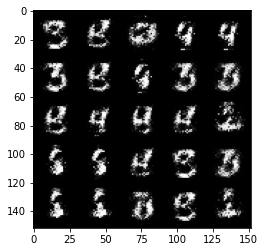

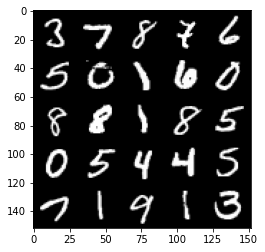

 57%|█████▋    | 267/469 [00:10<00:08, 24.52it/s]

Epoch 57, step 27000 -> generator loss: 0.5962168501615522, discriminator loss: 0.492283486068248


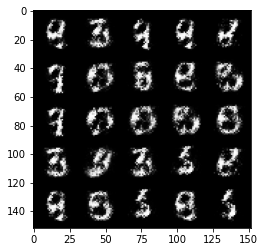

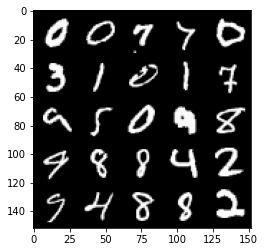

 63%|██████▎   | 296/469 [00:10<00:07, 24.42it/s]

Epoch 58, step 27500 -> generator loss: 0.593321867108345, discriminator loss: 0.4984168100953102


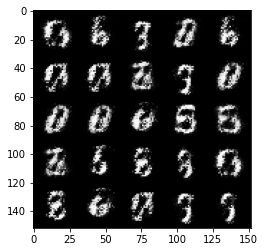

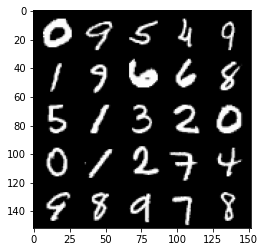

 70%|███████   | 329/469 [00:13<00:05, 25.23it/s]

Epoch 59, step 28000 -> generator loss: 0.5919988139867781, discriminator loss: 0.5018850980997088


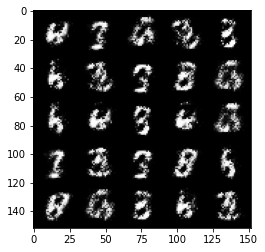

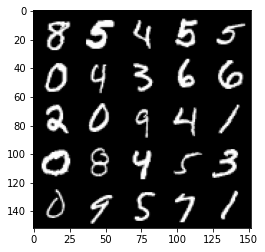

 77%|███████▋  | 359/469 [00:12<00:04, 27.07it/s]

Epoch 60, step 28500 -> generator loss: 0.597895867347717, discriminator loss: 0.4943495407700538


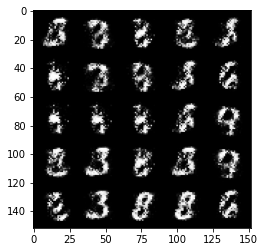

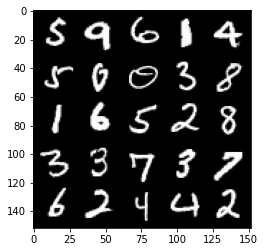

 83%|████████▎ | 389/469 [00:20<00:03, 23.18it/s]

Epoch 61, step 29000 -> generator loss: 0.5966769526004788, discriminator loss: 0.4961395910382273


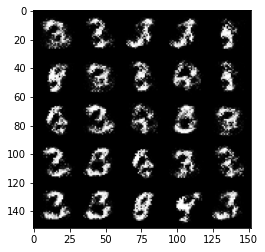

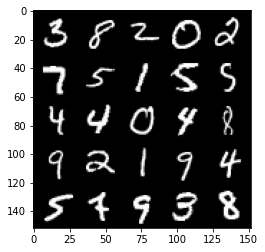

 90%|████████▉ | 422/469 [00:16<00:01, 23.92it/s]

Epoch 62, step 29500 -> generator loss: 0.5925902830362325, discriminator loss: 0.5094749186635018


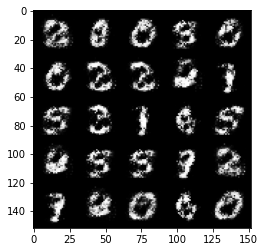

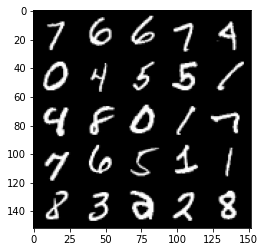

 97%|█████████▋| 453/469 [00:17<00:00, 23.75it/s]

Epoch 63, step 30000 -> generator loss: 0.5846916923522949, discriminator loss: 0.5058313349485394


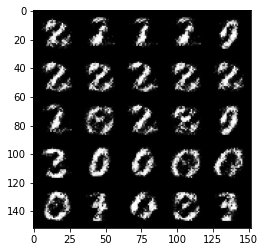

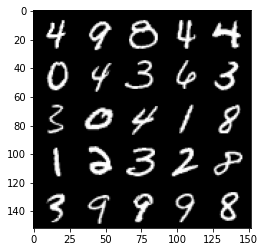

  3%|▎         | 13/469 [00:00<00:20, 22.25it/s]

Epoch 65, step 30500 -> generator loss: 0.5890660679340365, discriminator loss: 0.506698072254658


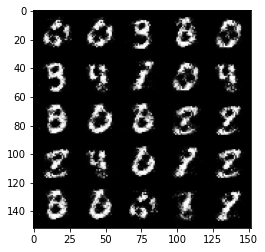

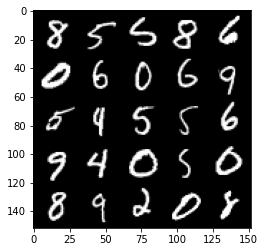

 10%|▉         | 46/469 [00:02<00:19, 21.59it/s]

Epoch 66, step 31000 -> generator loss: 0.5737300561666488, discriminator loss: 0.5171760835647584


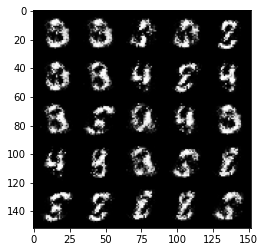

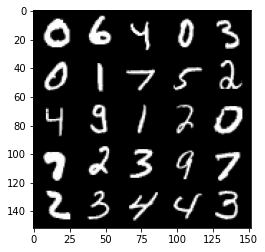

 16%|█▌        | 76/469 [00:03<00:17, 22.00it/s]

Epoch 67, step 31500 -> generator loss: 0.6098539537191393, discriminator loss: 0.48193572276830715


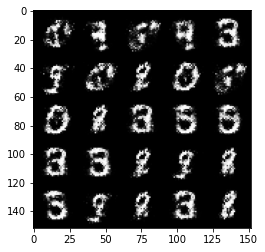

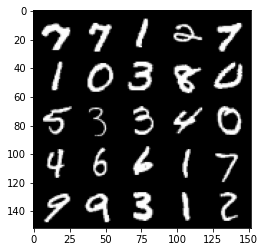

 23%|██▎       | 108/469 [00:04<00:16, 22.09it/s]

Epoch 68, step 32000 -> generator loss: 0.5915172371864319, discriminator loss: 0.5085232304930684


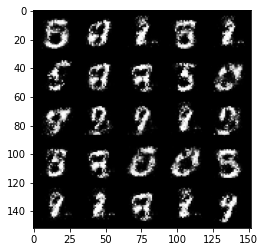

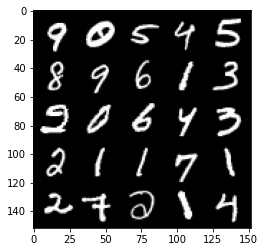

 30%|██▉       | 139/469 [00:06<00:15, 21.94it/s]

Epoch 69, step 32500 -> generator loss: 0.5876320290565489, discriminator loss: 0.5030332096815111


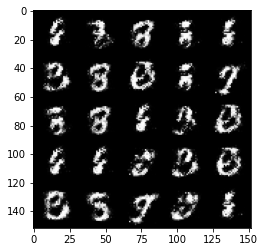

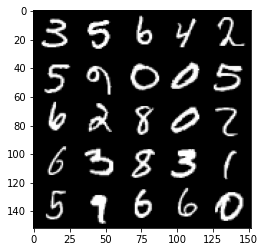

 36%|███▌      | 168/469 [00:07<00:13, 21.99it/s]

Epoch 70, step 33000 -> generator loss: 0.5880890747308732, discriminator loss: 0.5050341458320611


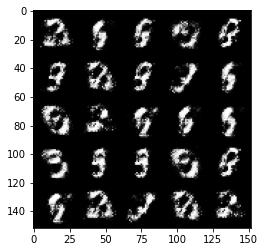

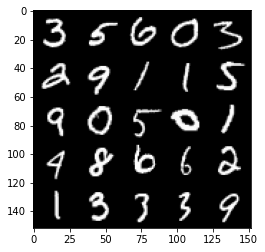

 43%|████▎     | 201/469 [00:09<00:11, 23.10it/s]

Epoch 71, step 33500 -> generator loss: 0.5841212772130964, discriminator loss: 0.5130426304340362


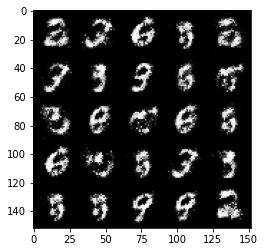

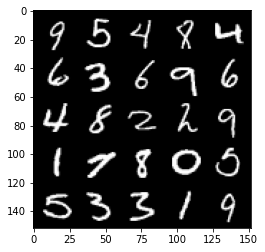

 49%|████▉     | 230/469 [00:10<00:10, 21.96it/s]

Epoch 72, step 34000 -> generator loss: 0.5839737896919253, discriminator loss: 0.5085052753686906


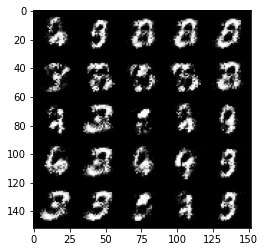

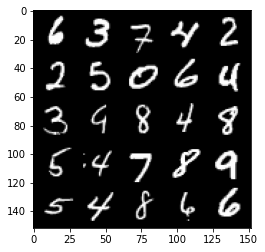

 56%|█████▌    | 261/469 [00:11<00:09, 22.40it/s]

Epoch 73, step 34500 -> generator loss: 0.5890272778272629, discriminator loss: 0.5004801898002627


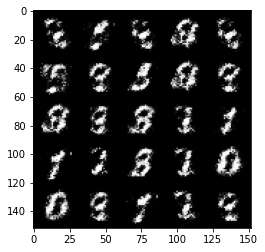

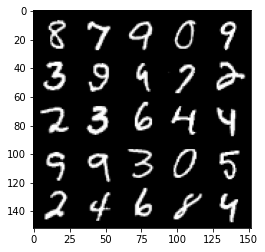

 63%|██████▎   | 294/469 [00:13<00:08, 21.83it/s]

Epoch 74, step 35000 -> generator loss: 0.6035534121990207, discriminator loss: 0.48424505025148384


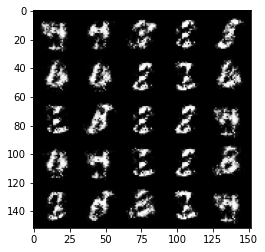

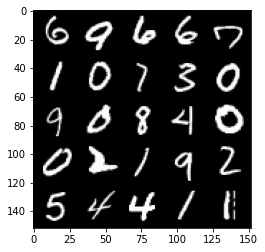

 69%|██████▉   | 325/469 [00:14<00:09, 14.51it/s]

Epoch 75, step 35500 -> generator loss: 0.5869450916051867, discriminator loss: 0.5133112533688549


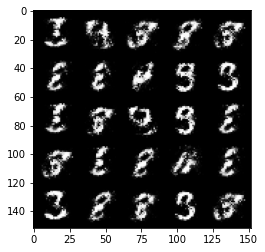

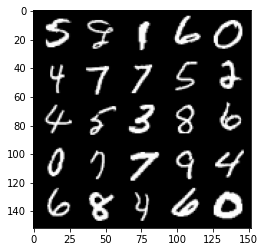

 75%|███████▌  | 354/469 [00:15<00:04, 23.17it/s]

Epoch 76, step 36000 -> generator loss: 0.5846157091856001, discriminator loss: 0.5093807786703112


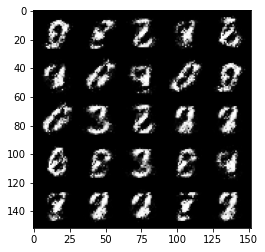

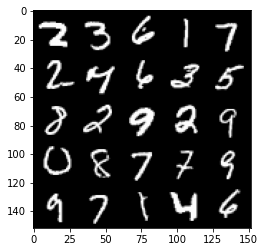

 82%|████████▏ | 386/469 [00:17<00:03, 20.81it/s]

Epoch 77, step 36500 -> generator loss: 0.5799421908855433, discriminator loss: 0.5216693023443223


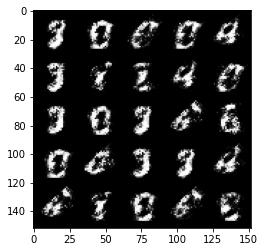

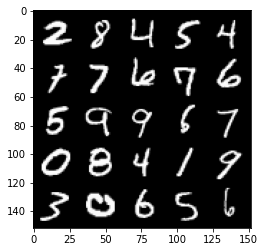

 89%|████████▊ | 416/469 [00:20<00:02, 20.17it/s]

Epoch 78, step 37000 -> generator loss: 0.5848753659725184, discriminator loss: 0.516004329442978


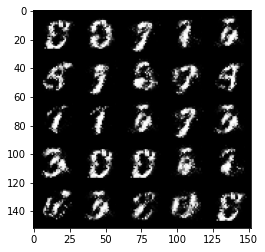

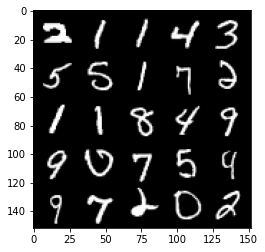

 96%|█████████▌| 448/469 [00:22<00:00, 22.69it/s]

Epoch 79, step 37500 -> generator loss: 0.5549948764443398, discriminator loss: 0.5514027090072631


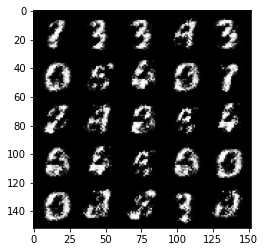

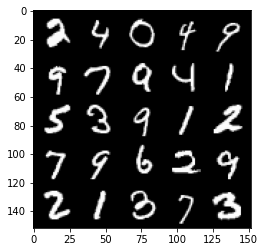

  2%|▏         | 10/469 [00:00<00:21, 21.23it/s]

Epoch 81, step 38000 -> generator loss: 0.5695260059237482, discriminator loss: 0.5231181144118308


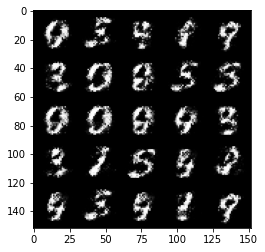

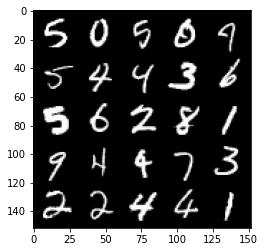

  9%|▊         | 41/469 [00:01<00:21, 19.63it/s]

Epoch 82, step 38500 -> generator loss: 0.5668572012186047, discriminator loss: 0.5401012036800388


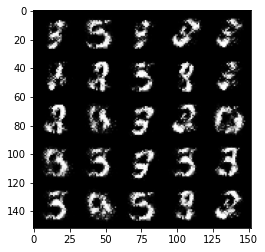

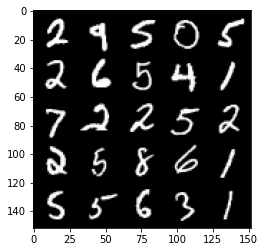

 16%|█▌        | 73/469 [00:03<00:17, 23.18it/s]

Epoch 83, step 39000 -> generator loss: 0.5803369958400727, discriminator loss: 0.5176255088448525


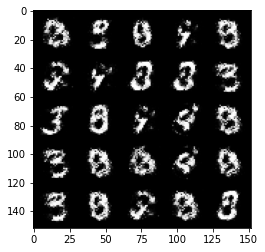

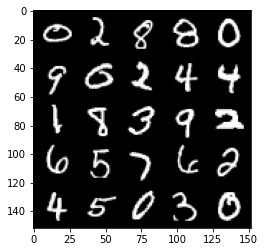

 22%|██▏       | 103/469 [00:04<00:15, 23.03it/s]

Epoch 84, step 39500 -> generator loss: 0.5839544268846509, discriminator loss: 0.5246982049345965


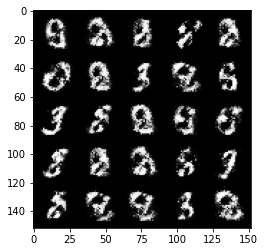

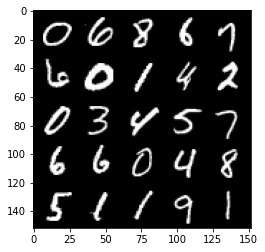

 28%|██▊       | 133/469 [00:06<00:14, 22.47it/s]

Epoch 85, step 40000 -> generator loss: 0.5556564419269561, discriminator loss: 0.5547613257169726


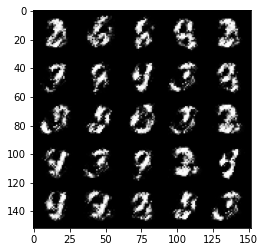

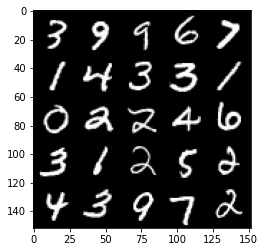

 35%|███▌      | 166/469 [00:07<00:13, 22.25it/s]

Epoch 86, step 40500 -> generator loss: 0.5538050918579097, discriminator loss: 0.5510585405826568


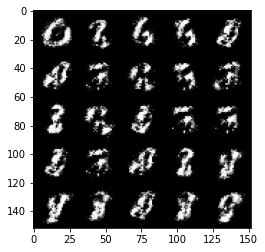

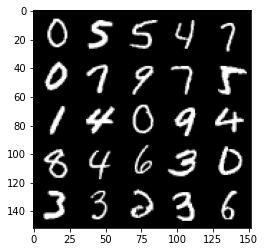

 42%|████▏     | 196/469 [00:09<00:12, 22.05it/s]

Epoch 87, step 41000 -> generator loss: 0.5790339196920398, discriminator loss: 0.5140996580123901


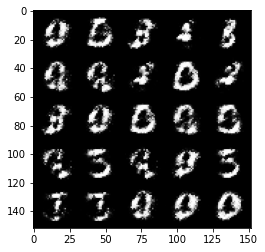

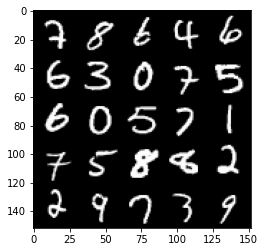

 48%|████▊     | 226/469 [00:10<00:10, 23.04it/s]

Epoch 88, step 41500 -> generator loss: 0.5914214522838596, discriminator loss: 0.5006509964466088


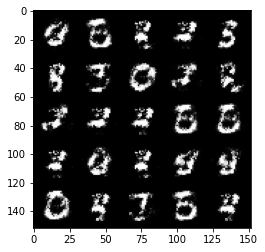

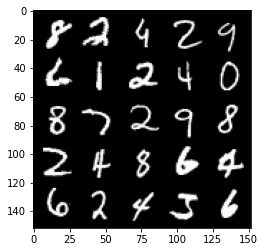

 55%|█████▌    | 259/469 [00:11<00:09, 22.50it/s]

Epoch 89, step 42000 -> generator loss: 0.5904327313899997, discriminator loss: 0.5084817345142364


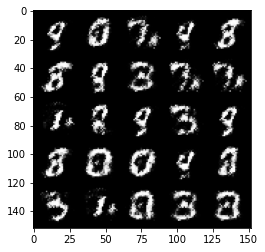

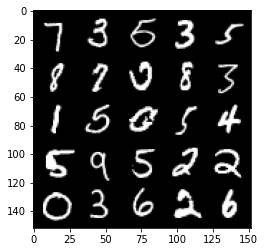

 62%|██████▏   | 289/469 [00:13<00:07, 23.03it/s]

Epoch 90, step 42500 -> generator loss: 0.5740868813991546, discriminator loss: 0.5302362167239189


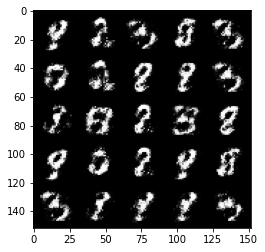

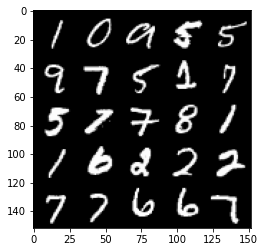

 68%|██████▊   | 320/469 [00:14<00:06, 22.27it/s]

Epoch 91, step 43000 -> generator loss: 0.5729497869014741, discriminator loss: 0.5250138062834739


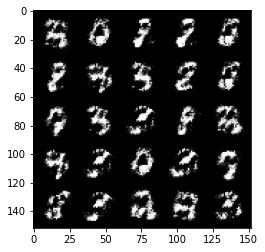

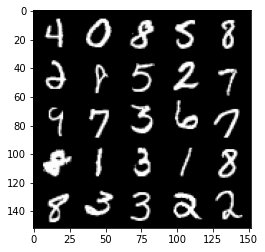

 75%|███████▍  | 350/469 [00:15<00:05, 23.33it/s]

Epoch 92, step 43500 -> generator loss: 0.5689294277429574, discriminator loss: 0.5332945238351822


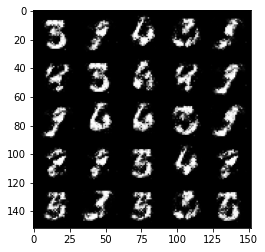

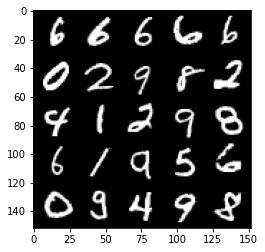

 81%|████████  | 381/469 [00:16<00:03, 23.64it/s]

Epoch 93, step 44000 -> generator loss: 0.5660198125839239, discriminator loss: 0.5335057221055032


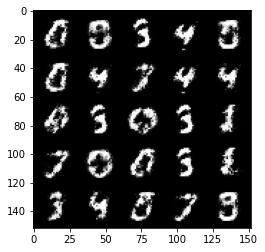

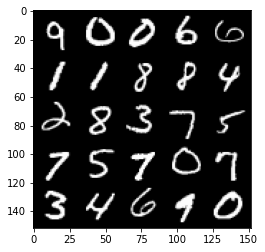

 88%|████████▊ | 412/469 [00:19<00:02, 25.38it/s]

Epoch 94, step 44500 -> generator loss: 0.5749747755527495, discriminator loss: 0.5327346301078798


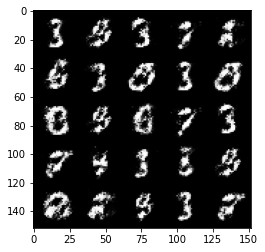

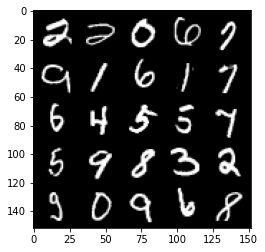

 95%|█████████▍| 444/469 [00:17<00:00, 25.52it/s]

Epoch 95, step 45000 -> generator loss: 0.5720065878033636, discriminator loss: 0.5332185526490208


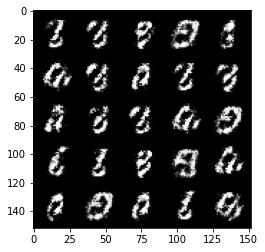

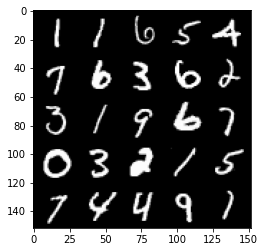

  1%|▏         | 7/469 [00:00<00:25, 18.17it/s]

Epoch 97, step 45500 -> generator loss: 0.5683961538672454, discriminator loss: 0.5393603523373598


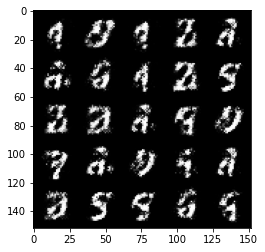

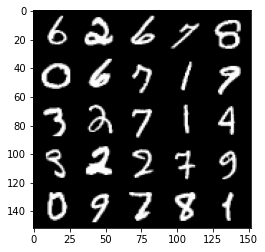

  8%|▊         | 37/469 [00:01<00:17, 24.92it/s]

Epoch 98, step 46000 -> generator loss: 0.5547966247797017, discriminator loss: 0.5544083831906319


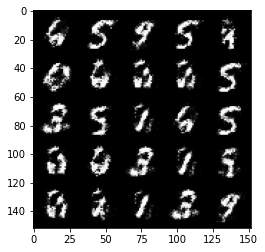

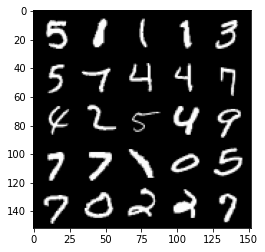

 14%|█▍        | 68/469 [00:02<00:15, 25.42it/s]

Epoch 99, step 46500 -> generator loss: 0.5742596648931502, discriminator loss: 0.5258925693035129


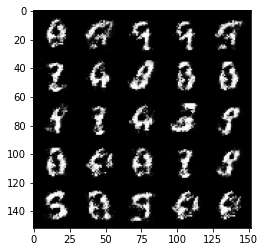

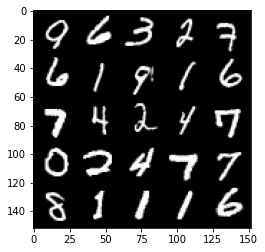

 21%|██        | 99/469 [00:04<00:14, 25.22it/s]

Epoch 100, step 47000 -> generator loss: 0.5624471329450601, discriminator loss: 0.5477348699569706


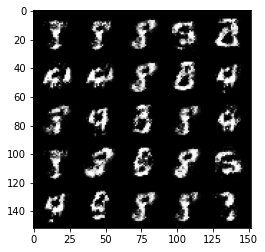

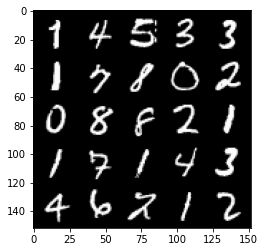

 28%|██▊       | 129/469 [00:05<00:13, 24.61it/s]

Epoch 101, step 47500 -> generator loss: 0.5530683525800708, discriminator loss: 0.5515791177153588


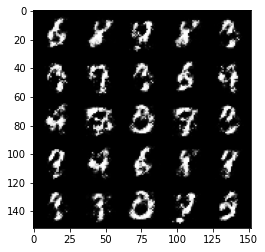

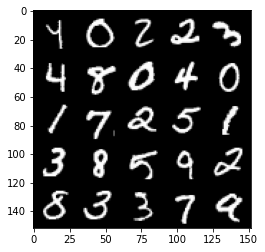

 34%|███▍      | 161/469 [00:06<00:12, 25.09it/s]

Epoch 102, step 48000 -> generator loss: 0.5662748281955717, discriminator loss: 0.5341101984977721


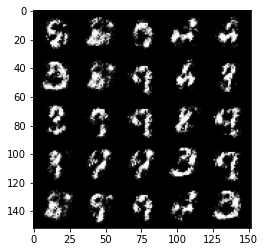

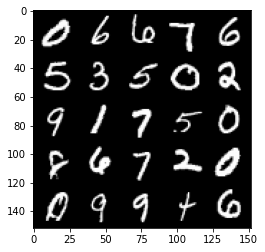

 41%|████      | 192/469 [00:07<00:10, 25.35it/s]

Epoch 103, step 48500 -> generator loss: 0.5652880902290345, discriminator loss: 0.5349289259910582


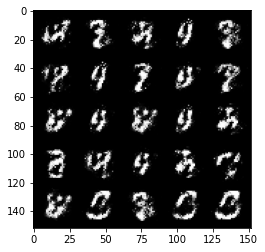

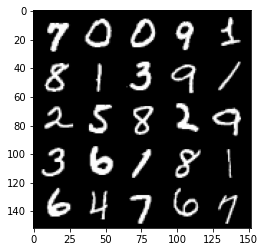

 48%|████▊     | 223/469 [00:09<00:10, 23.07it/s]

Epoch 104, step 49000 -> generator loss: 0.5603371345996858, discriminator loss: 0.5451831000447273


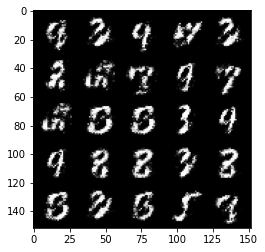

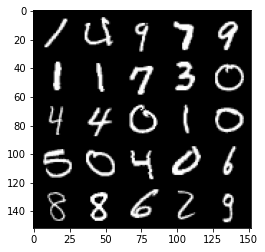

 54%|█████▍    | 254/469 [00:08<00:07, 29.89it/s]

Epoch 105, step 49500 -> generator loss: 0.5683039389848707, discriminator loss: 0.5331215382218358


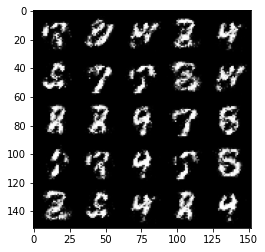

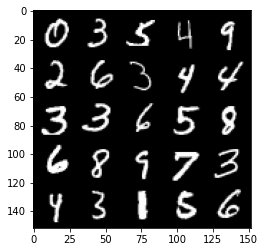

 61%|██████    | 285/469 [00:11<00:07, 24.86it/s]

Epoch 106, step 50000 -> generator loss: 0.5581497374773035, discriminator loss: 0.5516208670139312


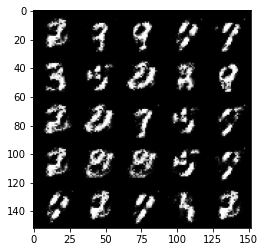

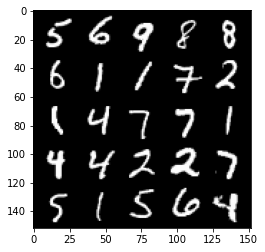

 67%|██████▋   | 315/469 [00:12<00:06, 25.23it/s]

Epoch 107, step 50500 -> generator loss: 0.5496365603804584, discriminator loss: 0.5650648772716516


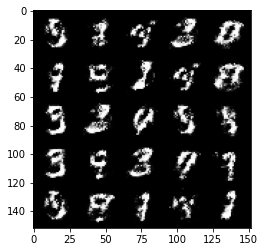

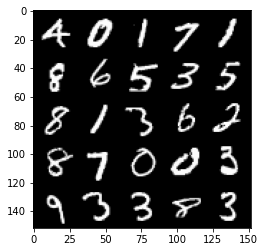

 74%|███████▍  | 346/469 [00:13<00:04, 25.10it/s]

Epoch 108, step 51000 -> generator loss: 0.5499089691638949, discriminator loss: 0.5678755524158474


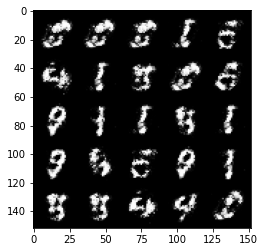

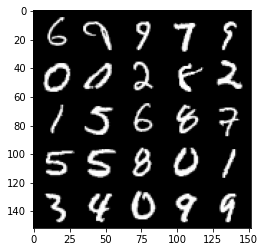

 80%|████████  | 377/469 [00:14<00:03, 24.92it/s]

Epoch 109, step 51500 -> generator loss: 0.5403893942832946, discriminator loss: 0.5757975113391872


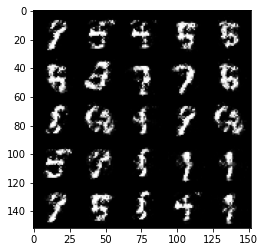

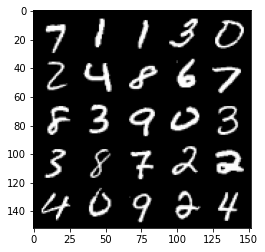

 87%|████████▋ | 409/469 [00:16<00:02, 23.94it/s]

Epoch 110, step 52000 -> generator loss: 0.5577418020367625, discriminator loss: 0.5462472981214526


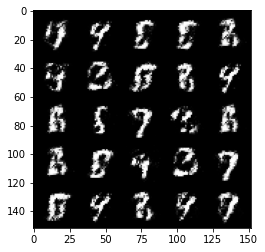

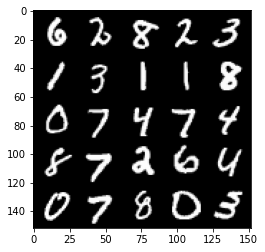

 94%|█████████▍| 440/469 [00:18<00:01, 23.96it/s]

Epoch 111, step 52500 -> generator loss: 0.539294751167297, discriminator loss: 0.5800448429584506


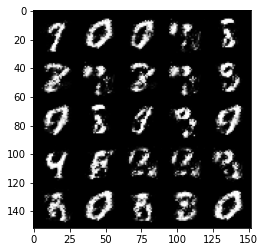

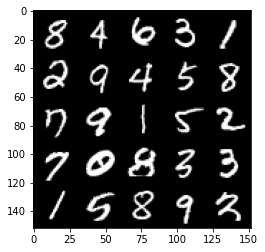

  1%|          | 3/469 [00:00<00:22, 21.04it/s]

Epoch 113, step 53000 -> generator loss: 0.5461620514392853, discriminator loss: 0.5644370042085647


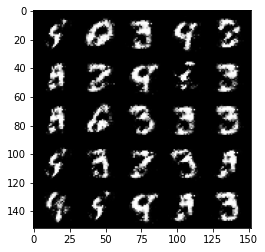

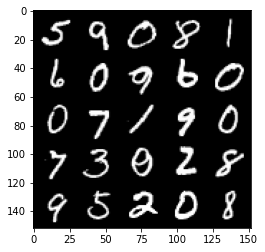

  7%|▋         | 34/469 [00:01<00:17, 24.61it/s]

Epoch 114, step 53500 -> generator loss: 0.5541857323050504, discriminator loss: 0.5583760432004923


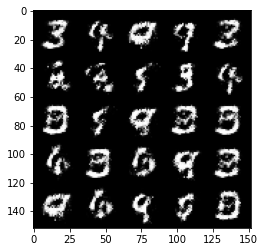

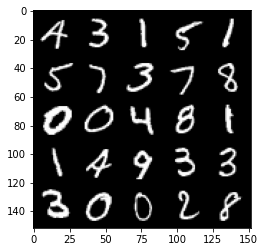

 14%|█▎        | 64/469 [00:02<00:16, 24.49it/s]

Epoch 115, step 54000 -> generator loss: 0.5579078735113145, discriminator loss: 0.5550444864034646


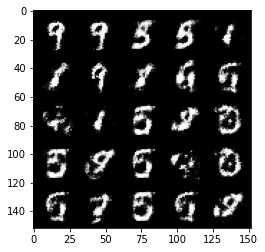

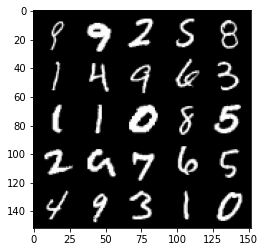

 20%|██        | 94/469 [00:04<00:15, 24.34it/s]

Epoch 116, step 54500 -> generator loss: 0.5415250030755997, discriminator loss: 0.5659493800401689


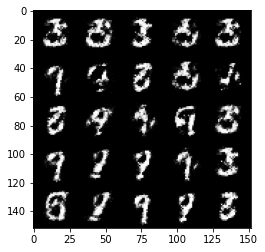

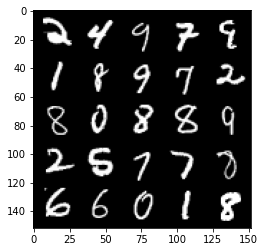

 27%|██▋       | 127/469 [00:05<00:14, 24.02it/s]

Epoch 117, step 55000 -> generator loss: 0.5444031342267991, discriminator loss: 0.5767275478839884


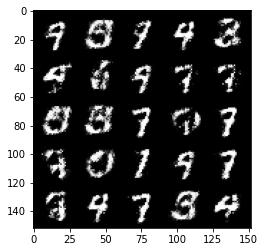

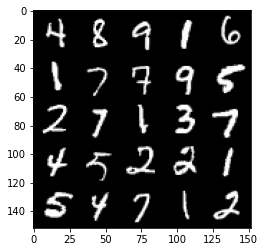

 33%|███▎      | 156/469 [00:07<00:13, 23.56it/s]

Epoch 118, step 55500 -> generator loss: 0.5401220606565473, discriminator loss: 0.5830296055078497


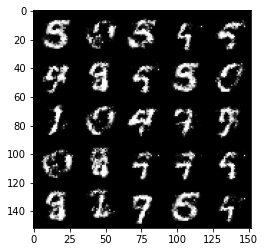

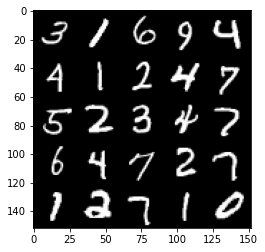

 40%|████      | 189/469 [00:07<00:11, 23.86it/s]

Epoch 119, step 56000 -> generator loss: 0.538720330715179, discriminator loss: 0.5840179944038394


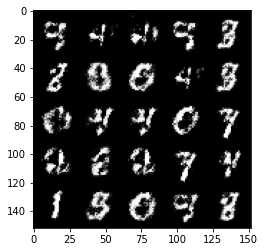

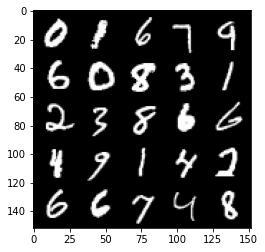

 47%|████▋     | 220/469 [00:09<00:10, 23.45it/s]

Epoch 120, step 56500 -> generator loss: 0.5374801612496375, discriminator loss: 0.5792878718376162


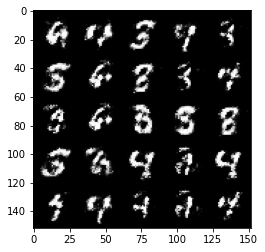

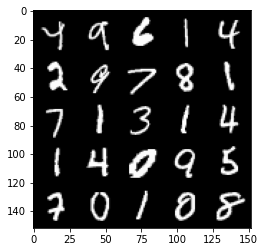

 53%|█████▎    | 250/469 [00:10<00:08, 24.52it/s]

Epoch 121, step 57000 -> generator loss: 0.5379684314131732, discriminator loss: 0.5731045190095903


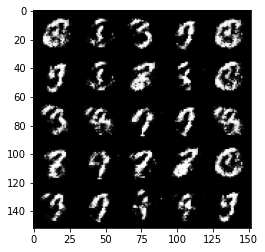

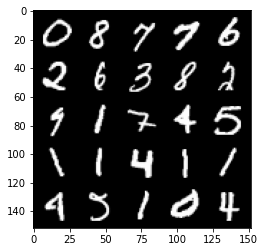

 60%|█████▉    | 281/469 [00:11<00:07, 24.26it/s]

Epoch 122, step 57500 -> generator loss: 0.5510578346848486, discriminator loss: 0.5592080671787262


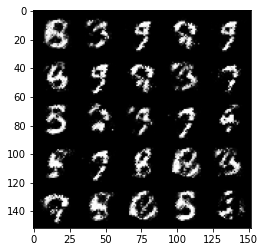

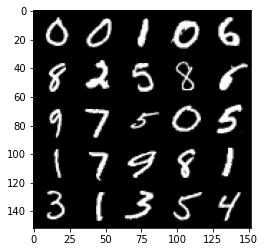

 67%|██████▋   | 313/469 [00:13<00:06, 23.91it/s]

Epoch 123, step 58000 -> generator loss: 0.5602129258513456, discriminator loss: 0.5491293878555299


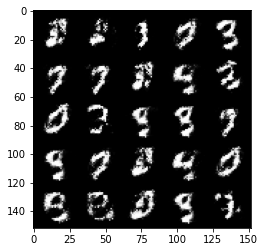

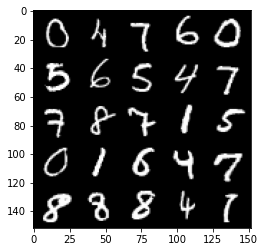

 73%|███████▎  | 342/469 [00:14<00:05, 23.60it/s]

Epoch 124, step 58500 -> generator loss: 0.5499711406826969, discriminator loss: 0.5589152003526688


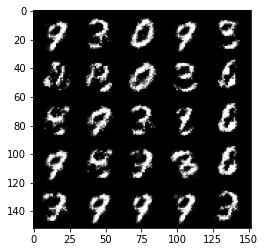

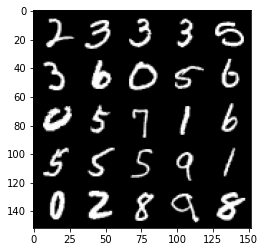

 80%|███████▉  | 373/469 [00:15<00:03, 24.13it/s]

Epoch 125, step 59000 -> generator loss: 0.5578896545171738, discriminator loss: 0.5477132925987243


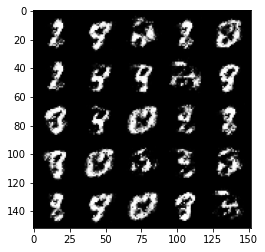

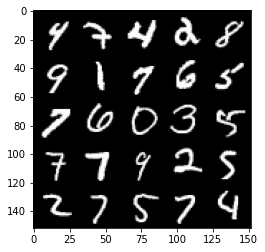

 87%|████████▋ | 406/469 [00:17<00:03, 19.72it/s]

Epoch 126, step 59500 -> generator loss: 0.5615510421991341, discriminator loss: 0.556707210123539


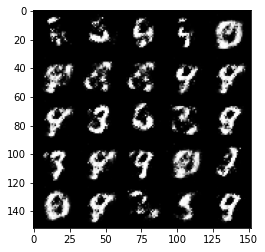

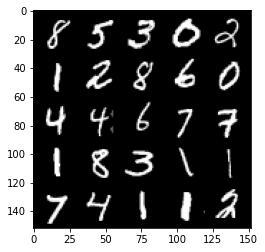

 93%|█████████▎| 437/469 [00:18<00:01, 22.52it/s]

Epoch 127, step 60000 -> generator loss: 0.5265029464960097, discriminator loss: 0.597244152545929


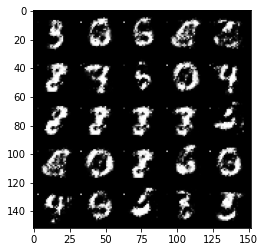

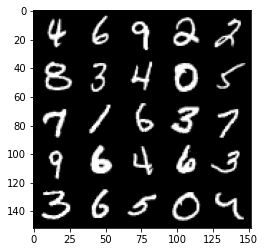

 99%|█████████▉| 466/469 [00:19<00:00, 23.86it/s]

Epoch 128, step 60500 -> generator loss: 0.5608718938827503, discriminator loss: 0.5478917763233185


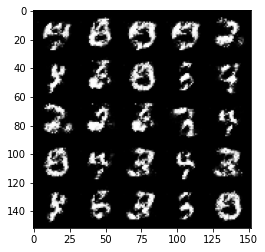

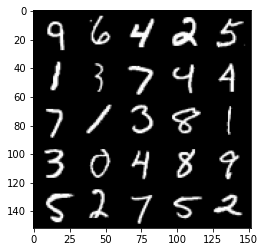

  6%|▌         | 28/469 [00:01<00:19, 22.43it/s]

Epoch 130, step 61000 -> generator loss: 0.5580150972008707, discriminator loss: 0.5462517779469496


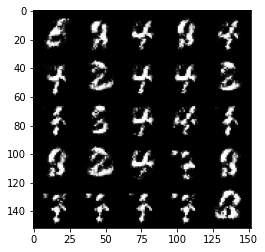

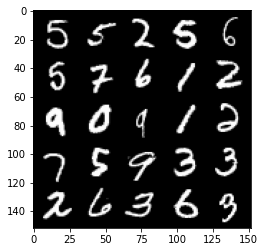

 13%|█▎        | 61/469 [00:02<00:17, 23.90it/s]

Epoch 131, step 61500 -> generator loss: 0.5495653010606769, discriminator loss: 0.5583663027286534


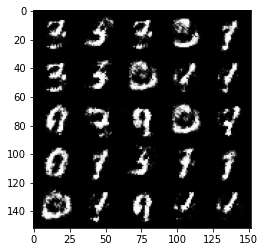

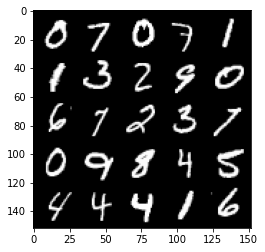

 19%|█▉        | 91/469 [00:03<00:16, 23.04it/s]

Epoch 132, step 62000 -> generator loss: 0.5565500446558, discriminator loss: 0.5488874387145043


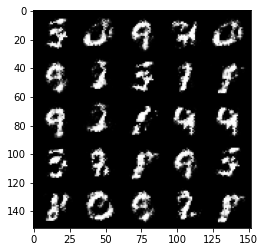

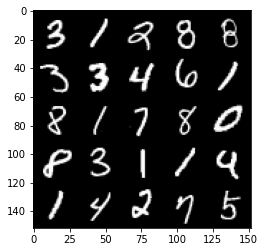

 26%|██▌       | 122/469 [00:06<00:15, 23.08it/s]

Epoch 133, step 62500 -> generator loss: 0.5564624733924868, discriminator loss: 0.5505342693924906


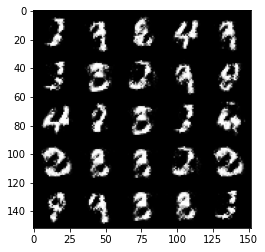

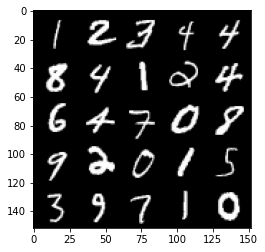

 33%|███▎      | 154/469 [00:06<00:13, 24.20it/s]

Epoch 134, step 63000 -> generator loss: 0.556197786211967, discriminator loss: 0.5509800612926486


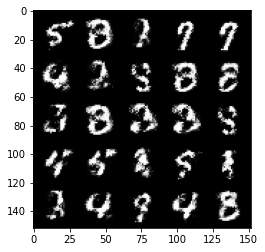

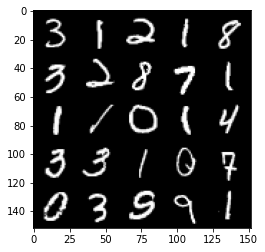

 39%|███▉      | 184/469 [00:08<00:12, 22.83it/s]

Epoch 135, step 63500 -> generator loss: 0.5551094143986703, discriminator loss: 0.5547426737546926


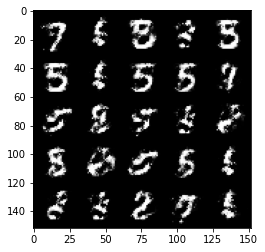

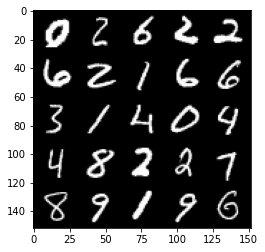

 46%|████▌     | 216/469 [00:08<00:10, 24.91it/s]

Epoch 136, step 64000 -> generator loss: 0.5509261054992676, discriminator loss: 0.5602114173173901


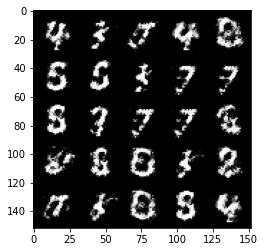

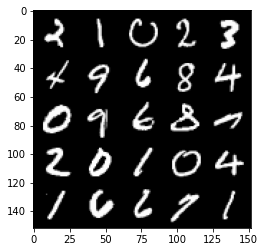

 52%|█████▏    | 246/469 [00:09<00:08, 25.35it/s]

Epoch 137, step 64500 -> generator loss: 0.5650999717116358, discriminator loss: 0.5407495300173757


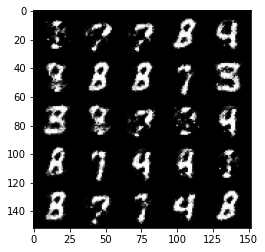

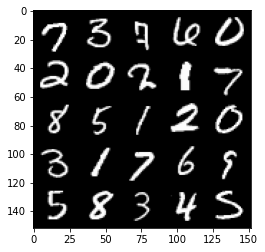

 59%|█████▉    | 278/469 [00:11<00:08, 23.76it/s]

Epoch 138, step 65000 -> generator loss: 0.5600499941706656, discriminator loss: 0.5494628366231917


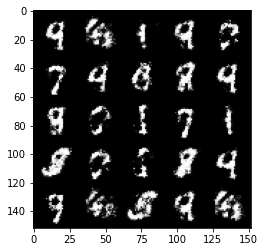

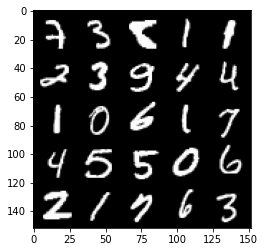

 65%|██████▌   | 307/469 [00:12<00:06, 25.05it/s]

Epoch 139, step 65500 -> generator loss: 0.5621276243925099, discriminator loss: 0.5508190870881078


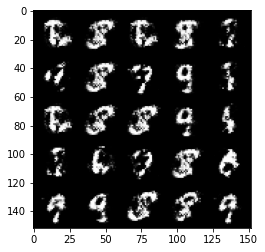

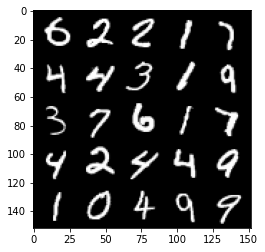

 72%|███████▏  | 338/469 [00:13<00:05, 25.37it/s]

Epoch 140, step 66000 -> generator loss: 0.5575312986969947, discriminator loss: 0.5493110373020175


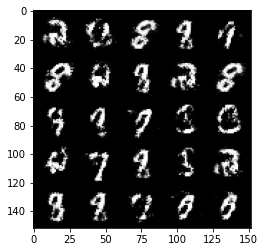

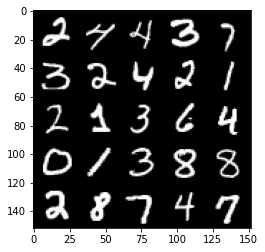

 79%|███████▊  | 369/469 [00:14<00:04, 24.52it/s]

Epoch 141, step 66500 -> generator loss: 0.5321767386794092, discriminator loss: 0.5946503630876535


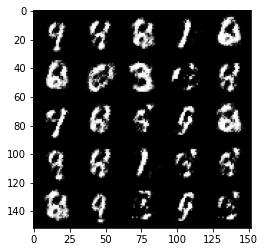

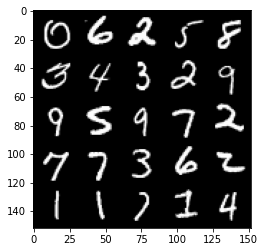

 85%|████████▌ | 400/469 [00:15<00:02, 24.80it/s]

Epoch 142, step 67000 -> generator loss: 0.53850836622715, discriminator loss: 0.5741789369583132


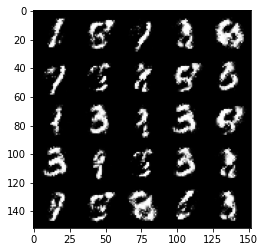

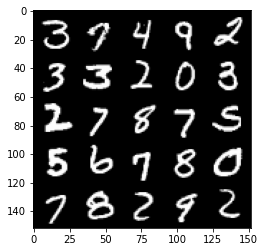

 92%|█████████▏| 431/469 [00:17<00:01, 25.21it/s]

Epoch 143, step 67500 -> generator loss: 0.5502164219617847, discriminator loss: 0.5608575570583347


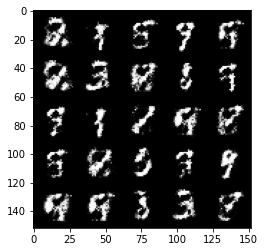

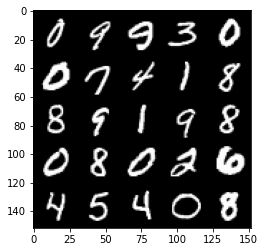

 99%|█████████▉| 464/469 [00:17<00:00, 25.39it/s]

Epoch 144, step 68000 -> generator loss: 0.5471644197106362, discriminator loss: 0.5645908801555634


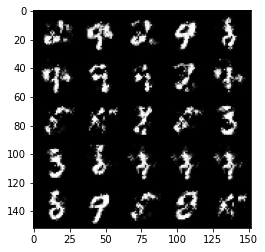

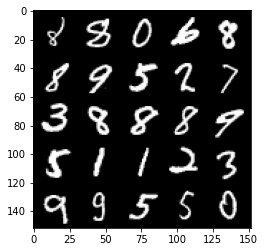

  5%|▌         | 25/469 [00:01<00:24, 18.45it/s]

Epoch 146, step 68500 -> generator loss: 0.5499033217430118, discriminator loss: 0.5588564218282696


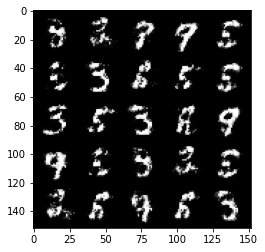

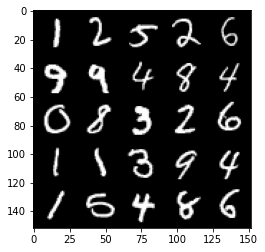

 12%|█▏        | 56/469 [00:02<00:17, 24.19it/s]

Epoch 147, step 69000 -> generator loss: 0.5516617665290834, discriminator loss: 0.5665832636952401


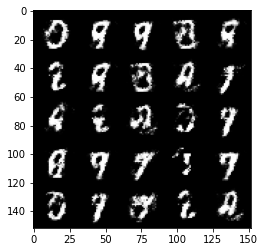

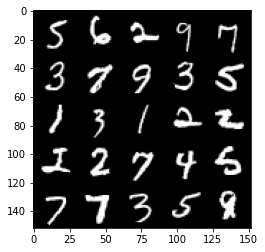

 19%|█▉        | 88/469 [00:03<00:16, 23.64it/s]

Epoch 148, step 69500 -> generator loss: 0.5483504269719125, discriminator loss: 0.5661957478523254


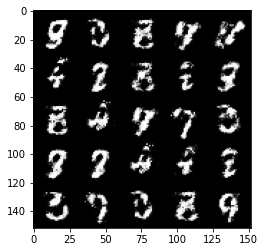

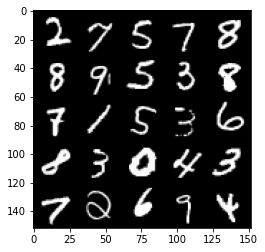

 25%|██▍       | 117/469 [00:05<00:17, 20.06it/s]

Epoch 149, step 70000 -> generator loss: 0.5568643882274623, discriminator loss: 0.5545377326011662


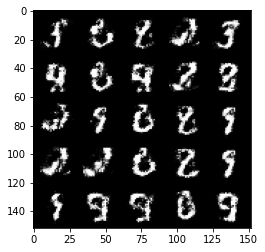

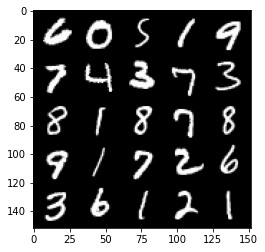

 32%|███▏      | 150/469 [00:06<00:16, 19.14it/s]

Epoch 150, step 70500 -> generator loss: 0.5510544778108597, discriminator loss: 0.55774894964695


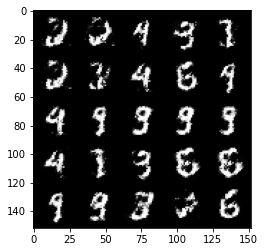

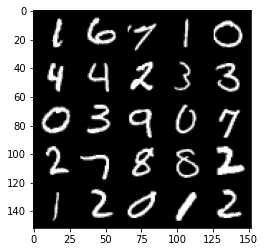

 39%|███▊      | 181/469 [00:07<00:12, 23.64it/s]

Epoch 151, step 71000 -> generator loss: 0.5450199034214018, discriminator loss: 0.5658339718580245


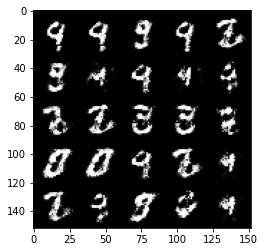

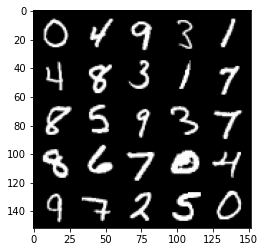

 45%|████▍     | 211/469 [00:09<00:11, 23.24it/s]

Epoch 152, step 71500 -> generator loss: 0.5045864817500118, discriminator loss: 0.6450838148593901


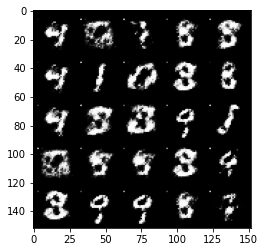

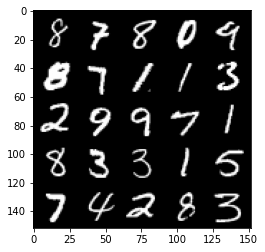

 52%|█████▏    | 242/469 [00:10<00:09, 22.85it/s]

Epoch 153, step 72000 -> generator loss: 0.5568604680299759, discriminator loss: 0.5448223068714143


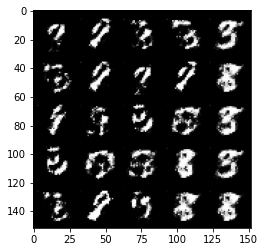

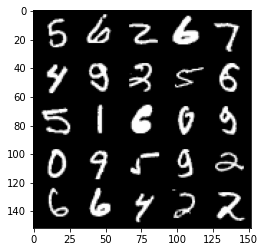

 58%|█████▊    | 272/469 [00:12<00:13, 14.40it/s]

Epoch 154, step 72500 -> generator loss: 0.5664649204611779, discriminator loss: 0.5394986699223517


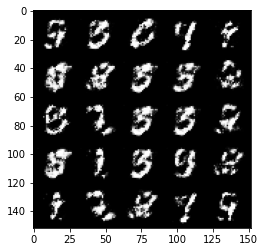

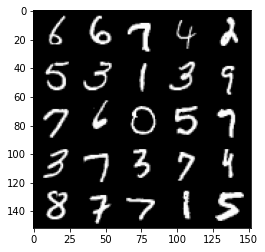

 65%|██████▍   | 303/469 [00:13<00:07, 23.54it/s]

Epoch 155, step 73000 -> generator loss: 0.5639848869442937, discriminator loss: 0.5392137691974637


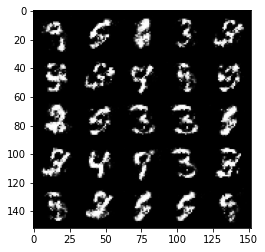

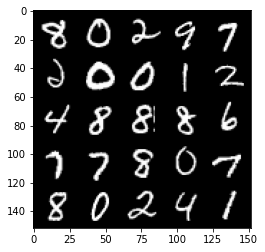

 71%|███████▏  | 335/469 [00:14<00:05, 22.85it/s]

Epoch 156, step 73500 -> generator loss: 0.5453187875747676, discriminator loss: 0.563089955568314


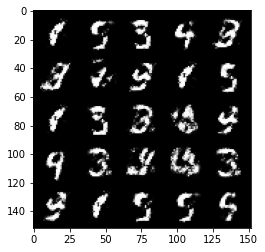

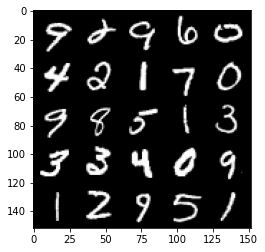

 78%|███████▊  | 367/469 [00:15<00:04, 20.69it/s]

Epoch 157, step 74000 -> generator loss: 0.5489290683269502, discriminator loss: 0.5547171846628184


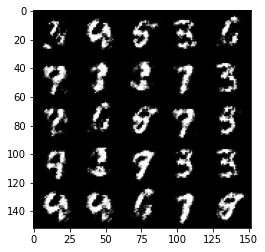

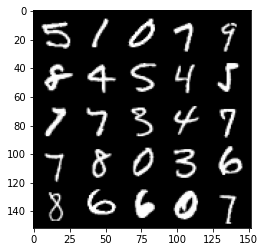

 85%|████████▍ | 397/469 [00:16<00:03, 23.97it/s]

Epoch 158, step 74500 -> generator loss: 0.5531635130643844, discriminator loss: 0.554930386304855


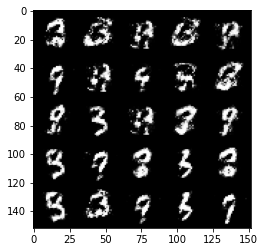

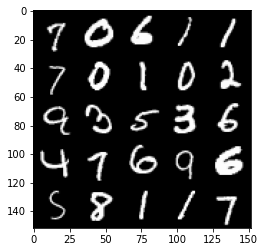

 91%|█████████ | 427/469 [00:17<00:01, 24.27it/s]

Epoch 159, step 75000 -> generator loss: 0.5754752386808393, discriminator loss: 0.5235391470193868


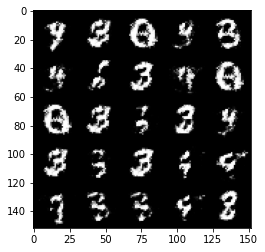

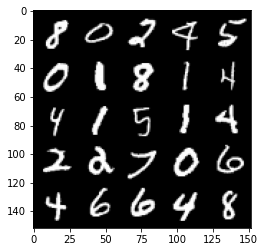

 98%|█████████▊| 460/469 [00:19<00:00, 21.28it/s]

Epoch 160, step 75500 -> generator loss: 0.5557635307908055, discriminator loss: 0.554779511690139


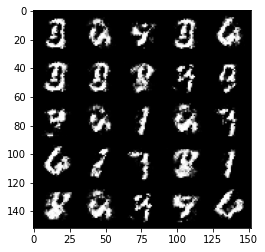

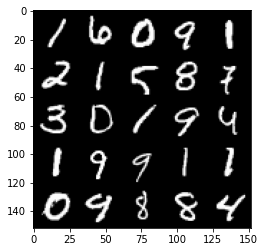

  4%|▍         | 21/469 [00:00<00:19, 23.06it/s]

Epoch 162, step 76000 -> generator loss: 0.549057322025299, discriminator loss: 0.563931549429894


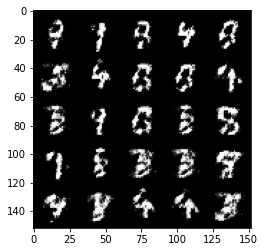

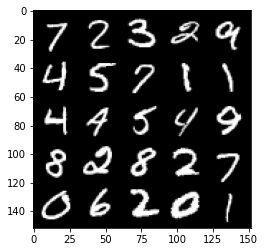

 11%|█         | 52/469 [00:02<00:17, 23.24it/s]

Epoch 163, step 76500 -> generator loss: 0.5447208263278006, discriminator loss: 0.5629254649281498


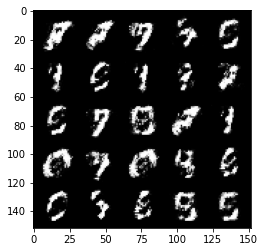

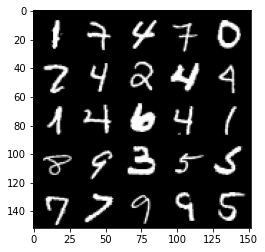

 18%|█▊        | 84/469 [00:03<00:15, 24.52it/s]

Epoch 164, step 77000 -> generator loss: 0.5468920717239382, discriminator loss: 0.5690602027773858


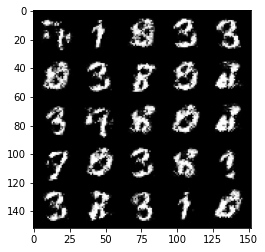

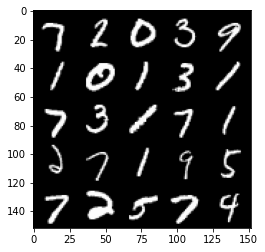

 24%|██▍       | 113/469 [00:05<00:17, 20.87it/s]

Epoch 165, step 77500 -> generator loss: 0.5401956515908246, discriminator loss: 0.5771714657545086


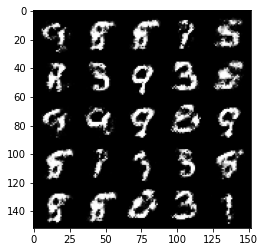

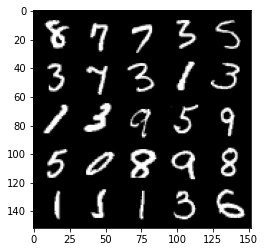

 31%|███       | 146/469 [00:06<00:13, 23.46it/s]

Epoch 166, step 78000 -> generator loss: 0.5517974932789803, discriminator loss: 0.5589993519186974


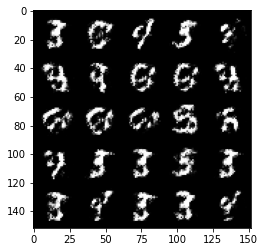

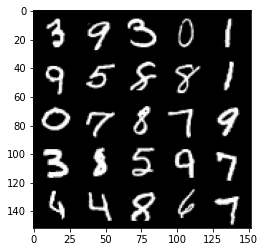

 38%|███▊      | 176/469 [00:07<00:11, 24.89it/s]

Epoch 167, step 78500 -> generator loss: 0.5470673528909683, discriminator loss: 0.5610170676708225


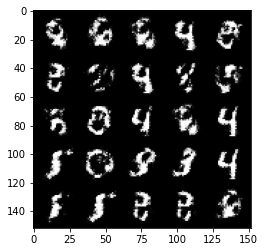

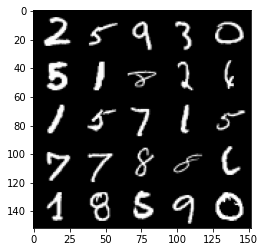

 44%|████▍     | 206/469 [00:08<00:10, 25.62it/s]

Epoch 168, step 79000 -> generator loss: 0.567346909999848, discriminator loss: 0.531918842673302


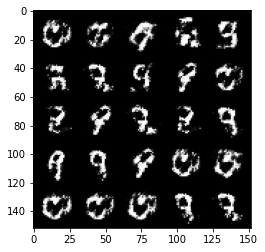

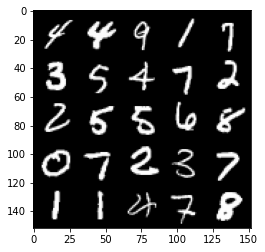

 51%|█████     | 237/469 [00:09<00:09, 23.81it/s]

Epoch 169, step 79500 -> generator loss: 0.5581859834790227, discriminator loss: 0.5550641056895257


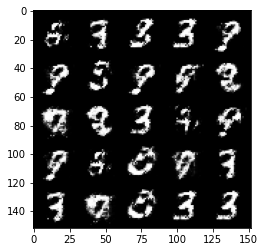

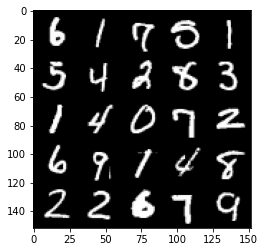

 58%|█████▊    | 270/469 [00:10<00:08, 24.77it/s]

Epoch 170, step 80000 -> generator loss: 0.5679827809929847, discriminator loss: 0.5387342306971544


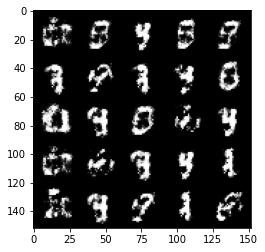

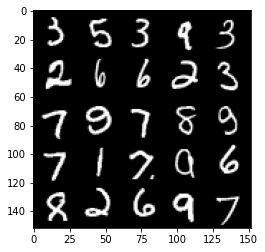

 64%|██████▍   | 299/469 [00:12<00:06, 25.13it/s]

Epoch 171, step 80500 -> generator loss: 0.5481109777092932, discriminator loss: 0.5622203744649883


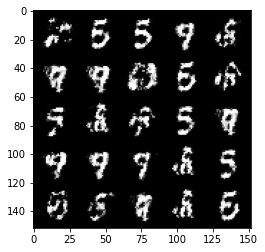

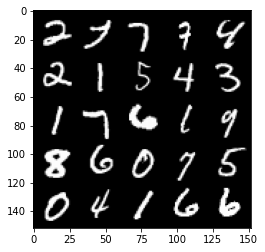

 70%|███████   | 330/469 [00:13<00:05, 25.23it/s]

Epoch 172, step 81000 -> generator loss: 0.5545901777744299, discriminator loss: 0.5569173383712769


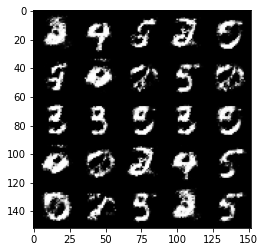

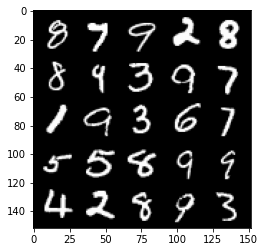

 77%|███████▋  | 363/469 [00:14<00:04, 25.53it/s]

Epoch 173, step 81500 -> generator loss: 0.5621906911730769, discriminator loss: 0.5459999051690096


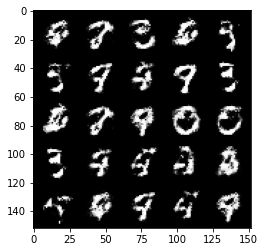

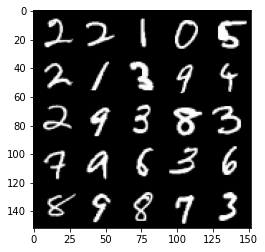

 84%|████████▍ | 393/469 [00:14<00:03, 23.75it/s]

Epoch 174, step 82000 -> generator loss: 0.5652240893840788, discriminator loss: 0.5371344984173779


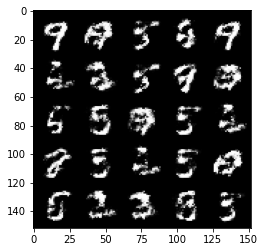

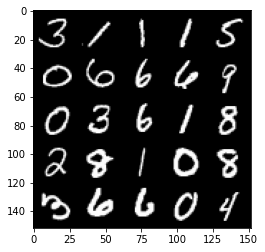

 91%|█████████ | 425/469 [00:16<00:01, 25.21it/s]

Epoch 175, step 82500 -> generator loss: 0.5453836107850071, discriminator loss: 0.5654402573704722


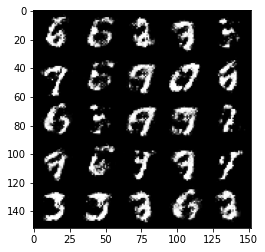

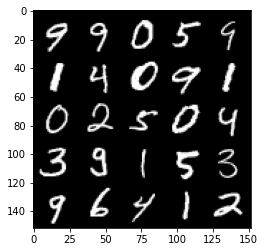

 97%|█████████▋| 454/469 [00:16<00:00, 24.95it/s]

Epoch 176, step 83000 -> generator loss: 0.5571546015739443, discriminator loss: 0.5473409009575844


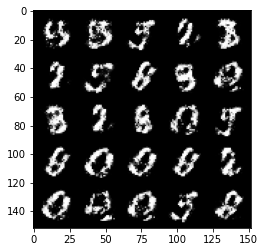

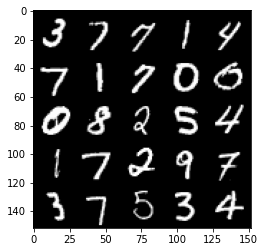

  4%|▎         | 17/469 [00:00<00:18, 25.05it/s]

Epoch 178, step 83500 -> generator loss: 0.5696665742397318, discriminator loss: 0.5323193703293801


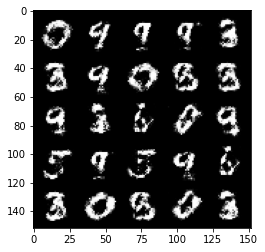

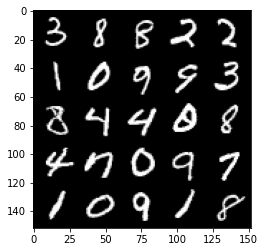

 10%|█         | 48/469 [00:01<00:16, 25.49it/s]

Epoch 179, step 84000 -> generator loss: 0.556859975993633, discriminator loss: 0.5576193355917932


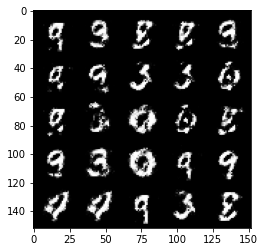

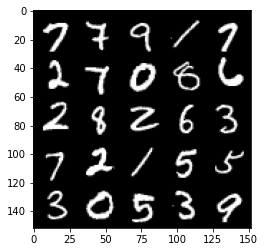

 17%|█▋        | 80/469 [00:03<00:15, 25.27it/s]

Epoch 180, step 84500 -> generator loss: 0.5453346709609036, discriminator loss: 0.5709502172470093


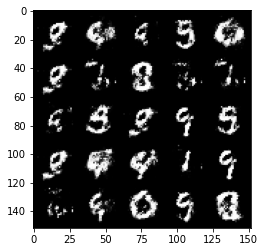

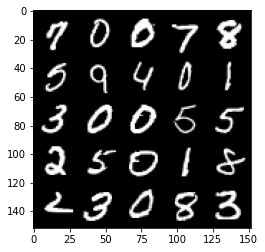

 24%|██▎       | 111/469 [00:04<00:14, 25.41it/s]

Epoch 181, step 85000 -> generator loss: 0.5401481863856313, discriminator loss: 0.5783859038352968


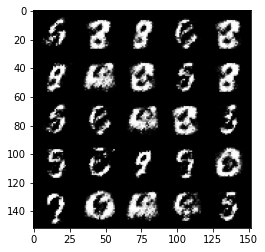

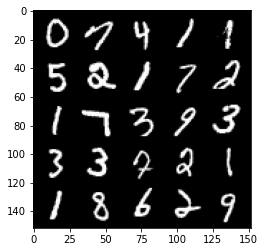

 30%|███       | 141/469 [00:05<00:13, 25.18it/s]

Epoch 182, step 85500 -> generator loss: 0.5435998747348785, discriminator loss: 0.5655972512960435


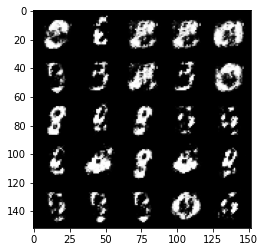

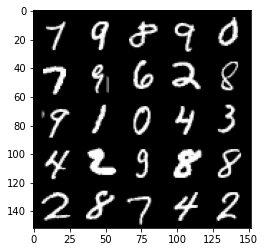

 36%|███▋      | 171/469 [00:06<00:12, 24.42it/s]

Epoch 183, step 86000 -> generator loss: 0.5570981116890908, discriminator loss: 0.5479665336608887


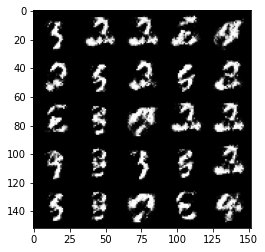

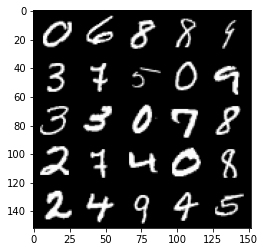

 43%|████▎     | 204/469 [00:08<00:10, 24.80it/s]

Epoch 184, step 86500 -> generator loss: 0.5265006709098813, discriminator loss: 0.5908718696832655


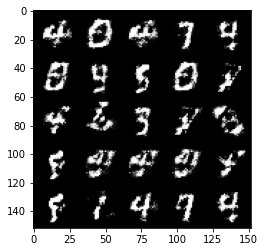

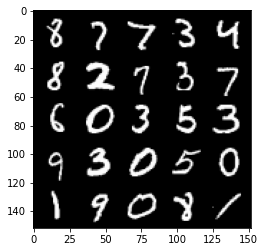

 50%|████▉     | 234/469 [00:09<00:09, 25.37it/s]

Epoch 185, step 87000 -> generator loss: 0.5542077602744107, discriminator loss: 0.5503482843637466


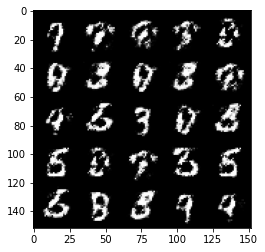

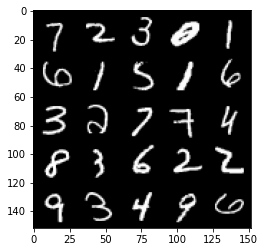

 56%|█████▋    | 264/469 [00:10<00:08, 25.50it/s]

Epoch 186, step 87500 -> generator loss: 0.5558705205321309, discriminator loss: 0.5492103315591812


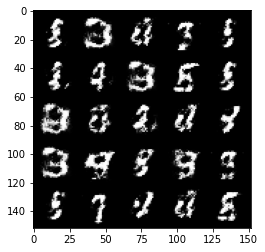

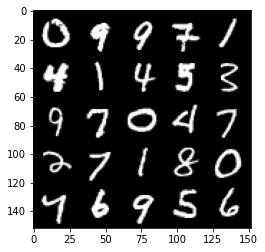

 63%|██████▎   | 296/469 [00:10<00:06, 25.05it/s]

Epoch 187, step 88000 -> generator loss: 0.5592843519449234, discriminator loss: 0.5435915099978448


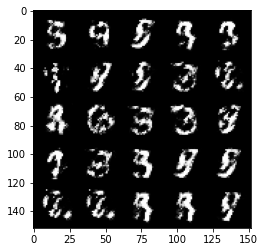

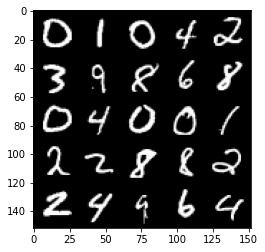

 70%|██████▉   | 327/469 [00:13<00:05, 24.72it/s]

Epoch 188, step 88500 -> generator loss: 0.5642601661682134, discriminator loss: 0.5423627067804334


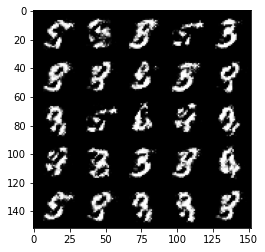

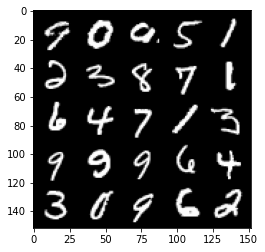

 76%|███████▌  | 357/469 [00:13<00:04, 25.24it/s]

Epoch 189, step 89000 -> generator loss: 0.5495764312148091, discriminator loss: 0.5657995055317876


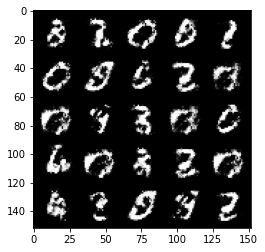

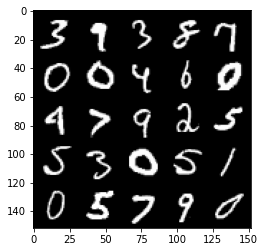

 83%|████████▎ | 390/469 [00:15<00:03, 24.84it/s]

Epoch 190, step 89500 -> generator loss: 0.5575258984565737, discriminator loss: 0.5554953151345251


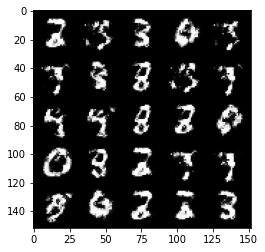

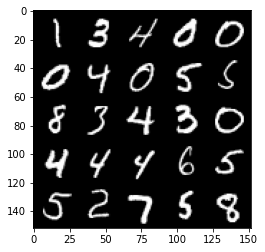

 90%|████████▉ | 420/469 [00:15<00:02, 24.50it/s]

Epoch 191, step 90000 -> generator loss: 0.54220506978035, discriminator loss: 0.5703180087804791


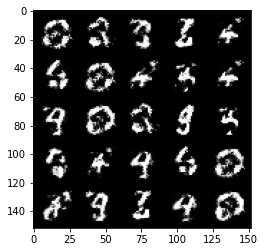

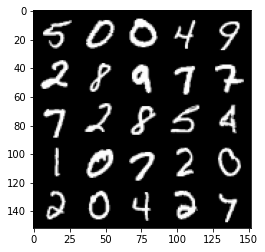

 96%|█████████▋| 452/469 [00:16<00:00, 24.80it/s]

Epoch 192, step 90500 -> generator loss: 0.5594052433371544, discriminator loss: 0.5559095341563227


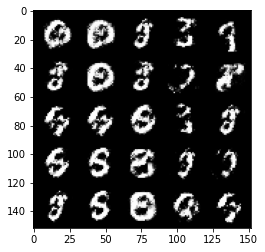

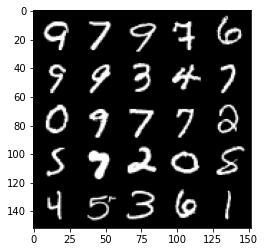

  3%|▎         | 14/469 [00:00<00:19, 22.94it/s]

Epoch 194, step 91000 -> generator loss: 0.5638341212272644, discriminator loss: 0.549172681868076


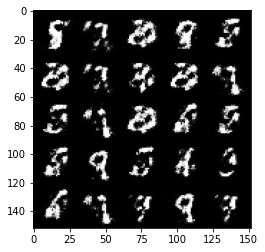

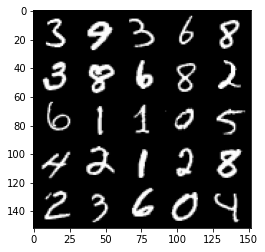

  9%|▉         | 44/469 [00:01<00:16, 25.25it/s]

Epoch 195, step 91500 -> generator loss: 0.5580569034814834, discriminator loss: 0.5536650358438487


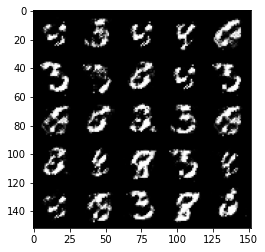

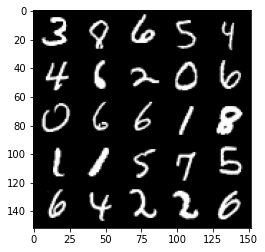

 16%|█▌        | 76/469 [00:03<00:22, 17.84it/s]

Epoch 196, step 92000 -> generator loss: 0.5528908993005758, discriminator loss: 0.5543963673710822


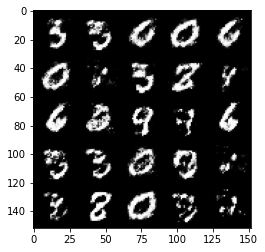

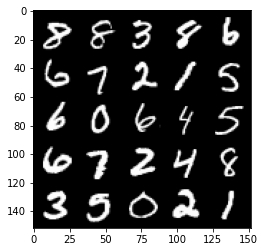

 22%|██▏       | 105/469 [00:04<00:16, 22.19it/s]

Epoch 197, step 92500 -> generator loss: 0.544017142176628, discriminator loss: 0.565476079821587


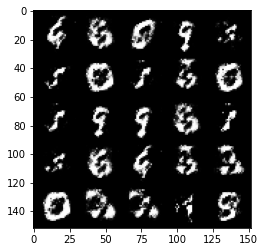

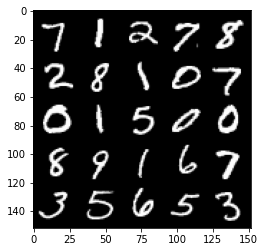

 29%|██▉       | 138/469 [00:05<00:13, 24.68it/s]

Epoch 198, step 93000 -> generator loss: 0.5494184359908101, discriminator loss: 0.5630921915769577


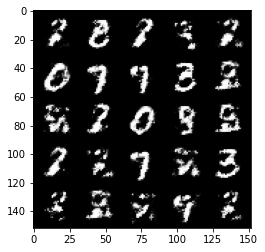

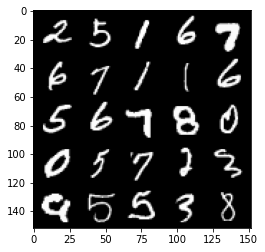

 36%|███▌      | 169/469 [00:07<00:12, 24.71it/s]

Epoch 199, step 93500 -> generator loss: 0.5553791772127149, discriminator loss: 0.5569664808511731


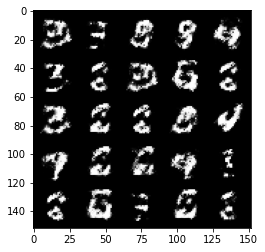

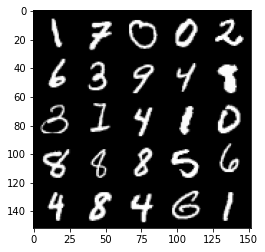

 42%|████▏     | 198/469 [00:08<00:11, 24.06it/s]

Epoch 200, step 94000 -> generator loss: 0.5640304871201521, discriminator loss: 0.5389449844360359


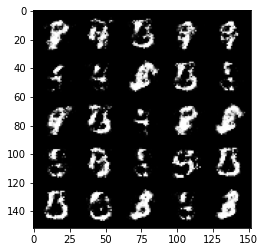

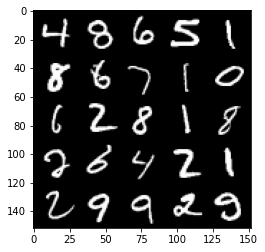

 49%|████▉     | 231/469 [00:09<00:09, 24.28it/s]

Epoch 201, step 94500 -> generator loss: 0.5599043775796886, discriminator loss: 0.5543832163810729


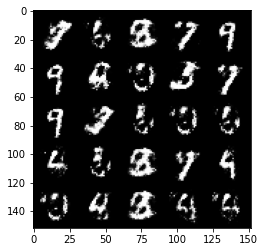

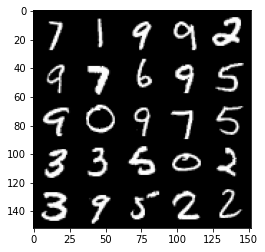

 56%|█████▌    | 261/469 [00:10<00:08, 25.52it/s]

Epoch 202, step 95000 -> generator loss: 0.5520145167708398, discriminator loss: 0.5611908001899716


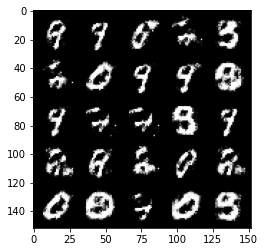

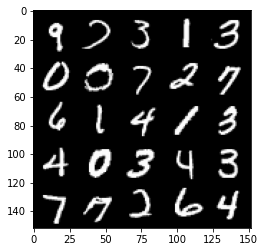

 62%|██████▏   | 291/469 [00:11<00:07, 24.59it/s]

Epoch 203, step 95500 -> generator loss: 0.5663604228496557, discriminator loss: 0.5406902768611906


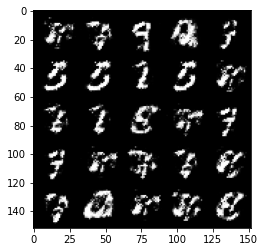

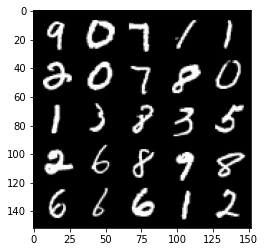

 69%|██████▊   | 322/469 [00:14<00:06, 24.39it/s]

Epoch 204, step 96000 -> generator loss: 0.5612798104286191, discriminator loss: 0.5366083846092219


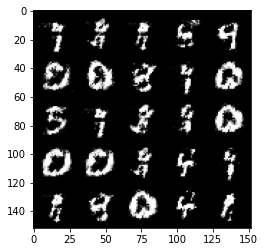

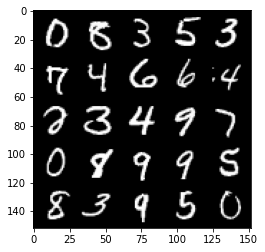

 75%|███████▌  | 353/469 [00:18<00:05, 22.97it/s]

Epoch 205, step 96500 -> generator loss: 0.5659440886974337, discriminator loss: 0.5378364306092269


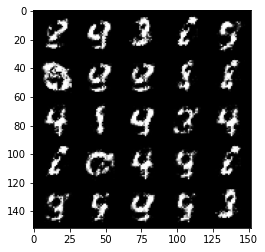

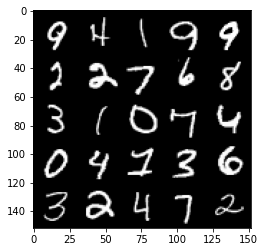

 82%|████████▏ | 384/469 [00:15<00:03, 24.02it/s]

Epoch 206, step 97000 -> generator loss: 0.5562176517844201, discriminator loss: 0.5473044901490208


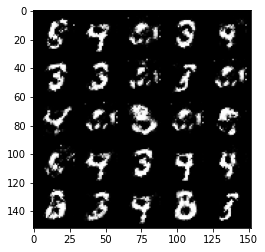

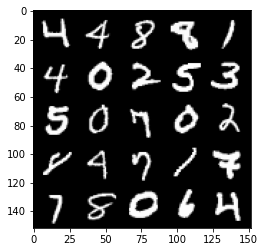

 88%|████████▊ | 415/469 [00:17<00:02, 24.84it/s]

Epoch 207, step 97500 -> generator loss: 0.5553923420906072, discriminator loss: 0.5527573413848875


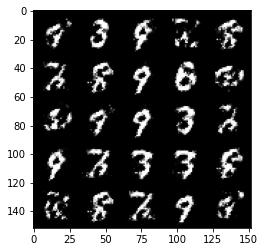

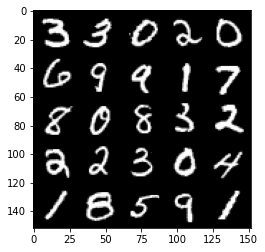

 95%|█████████▌| 446/469 [00:18<00:00, 23.89it/s]

Epoch 208, step 98000 -> generator loss: 0.5539226112365725, discriminator loss: 0.5524731556773189


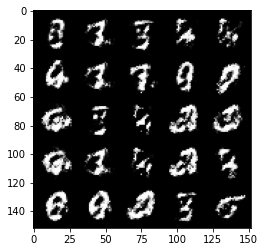

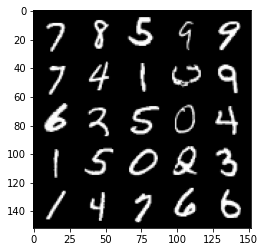

  2%|▏         | 9/469 [00:00<00:19, 23.34it/s]

Epoch 210, step 98500 -> generator loss: 0.5588827466368675, discriminator loss: 0.548680923104286


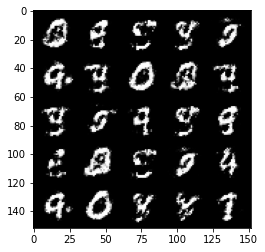

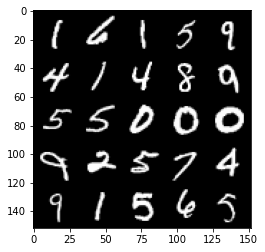

  8%|▊         | 39/469 [00:01<00:22, 18.85it/s]

Epoch 211, step 99000 -> generator loss: 0.5588639385104177, discriminator loss: 0.5488557989597312


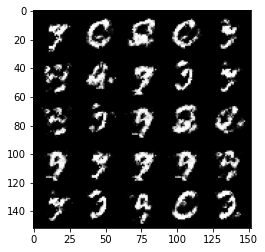

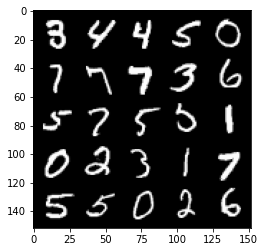

 15%|█▌        | 71/469 [00:02<00:16, 24.84it/s]

Epoch 212, step 99500 -> generator loss: 0.5570831350088123, discriminator loss: 0.547920340180397


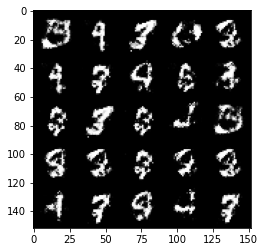

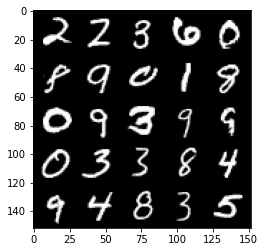

 22%|██▏       | 102/469 [00:04<00:14, 24.66it/s]

Epoch 213, step 100000 -> generator loss: 0.561263569414616, discriminator loss: 0.5477455108761792


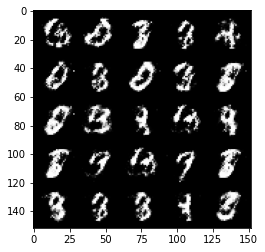

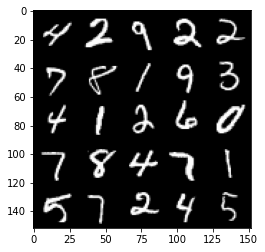

 29%|██▊       | 134/469 [00:05<00:13, 24.81it/s]

Epoch 214, step 100500 -> generator loss: 0.5489979995489116, discriminator loss: 0.5716269114613534


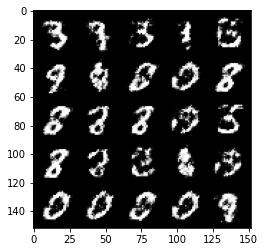

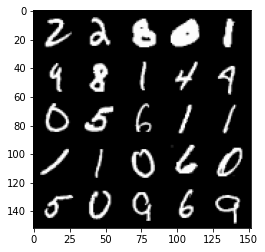

 35%|███▌      | 165/469 [00:06<00:12, 24.59it/s]

Epoch 215, step 101000 -> generator loss: 0.5497556649446483, discriminator loss: 0.5661820234656335


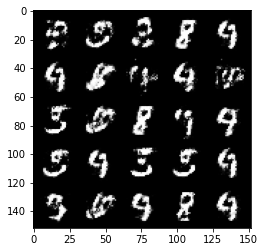

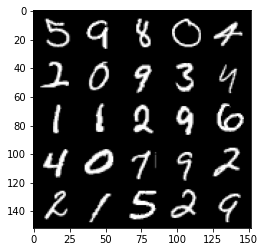

 42%|████▏     | 196/469 [00:08<00:12, 22.46it/s]

Epoch 216, step 101500 -> generator loss: 0.5499829009175297, discriminator loss: 0.5601906366944311


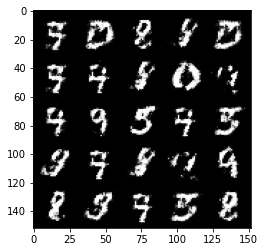

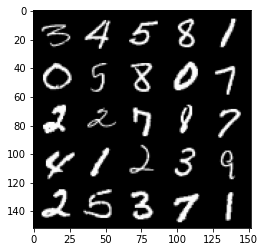

 48%|████▊     | 225/469 [00:09<00:10, 24.17it/s]

Epoch 217, step 102000 -> generator loss: 0.5684741357564925, discriminator loss: 0.542628688275814


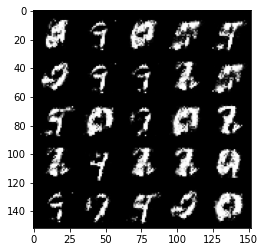

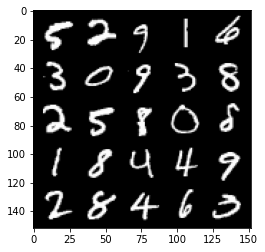

 55%|█████▌    | 258/469 [00:10<00:08, 24.77it/s]

Epoch 218, step 102500 -> generator loss: 0.5334180067777631, discriminator loss: 0.5856986534595491


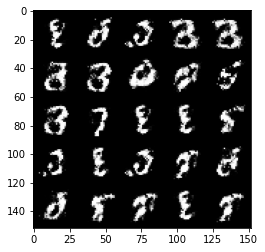

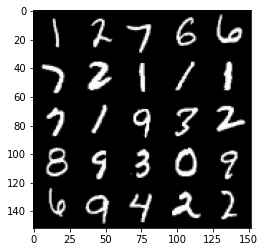

 61%|██████▏   | 288/469 [00:11<00:07, 24.28it/s]

Epoch 219, step 103000 -> generator loss: 0.5345004588961609, discriminator loss: 0.5744473748207087


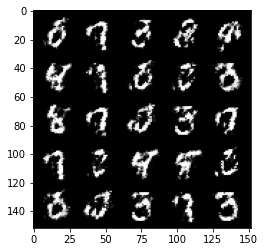

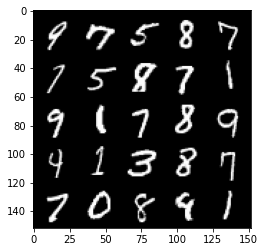

 68%|██████▊   | 318/469 [00:12<00:06, 24.89it/s]

Epoch 220, step 103500 -> generator loss: 0.533983821630478, discriminator loss: 0.5757088998556134


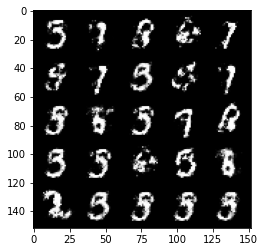

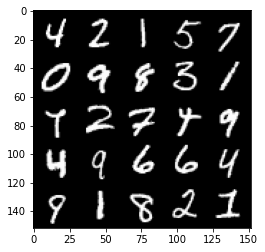

 75%|███████▍  | 350/469 [00:14<00:04, 25.30it/s]

Epoch 221, step 104000 -> generator loss: 0.5458227328062062, discriminator loss: 0.5649410359859469


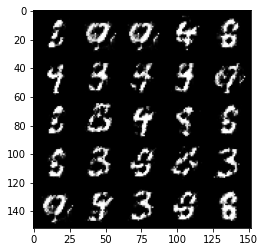

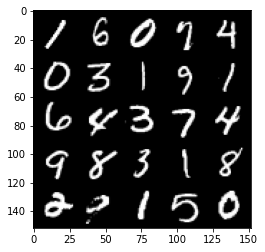

 81%|████████  | 381/469 [00:15<00:03, 24.88it/s]

Epoch 222, step 104500 -> generator loss: 0.5407407568097112, discriminator loss: 0.5711215244531634


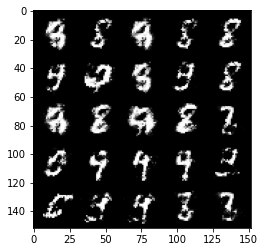

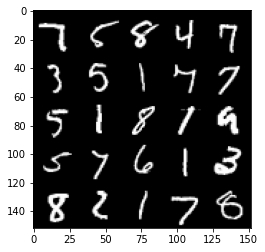

 88%|████████▊ | 412/469 [00:16<00:03, 14.45it/s]

Epoch 223, step 105000 -> generator loss: 0.546985276043415, discriminator loss: 0.5660765750408172


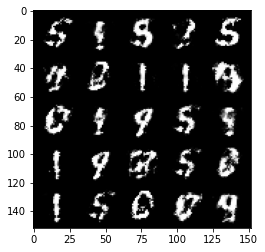

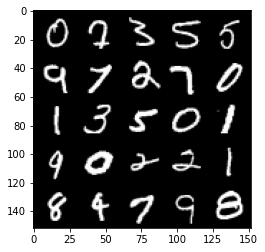

 94%|█████████▍| 443/469 [00:17<00:01, 24.25it/s]

Epoch 224, step 105500 -> generator loss: 0.5526696619987487, discriminator loss: 0.5646597183346744


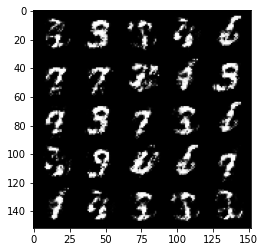

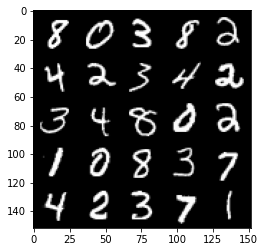

  1%|          | 4/469 [00:00<00:24, 19.04it/s]

Epoch 226, step 106000 -> generator loss: 0.5560316028594969, discriminator loss: 0.5535000115633009


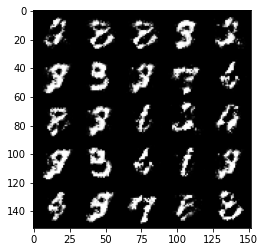

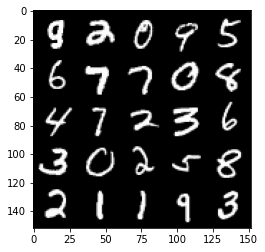

  7%|▋         | 35/469 [00:01<00:18, 23.08it/s]

Epoch 227, step 106500 -> generator loss: 0.556530065059662, discriminator loss: 0.5498635479211804


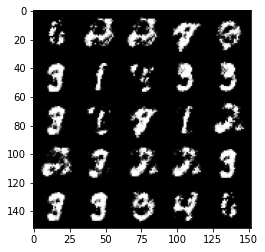

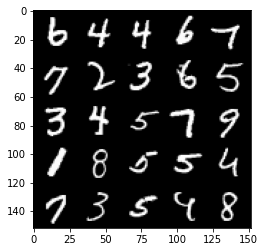

 14%|█▍        | 68/469 [00:02<00:15, 25.24it/s]

Epoch 228, step 107000 -> generator loss: 0.5512993887066837, discriminator loss: 0.5644579013586039


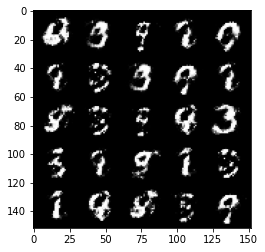

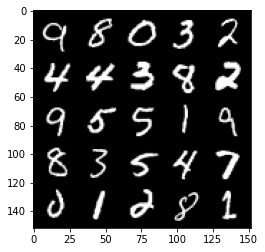

 21%|██        | 99/469 [00:03<00:14, 25.35it/s]

Epoch 229, step 107500 -> generator loss: 0.5502531997561456, discriminator loss: 0.5547504264116286


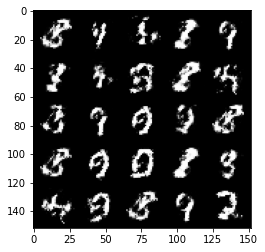

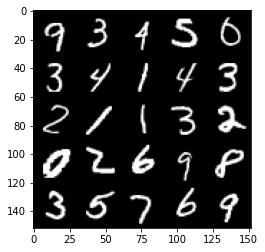

 27%|██▋       | 128/469 [00:06<00:14, 23.89it/s]

Epoch 230, step 108000 -> generator loss: 0.5600528010129926, discriminator loss: 0.5446325346231464


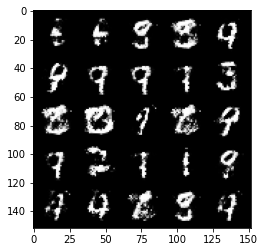

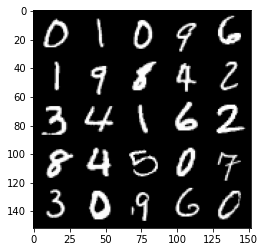

 34%|███▍      | 159/469 [00:06<00:12, 24.19it/s]

Epoch 231, step 108500 -> generator loss: 0.5476232944130902, discriminator loss: 0.5631553097963331


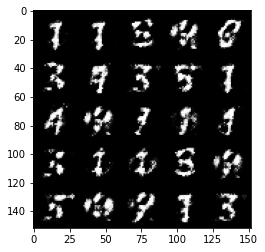

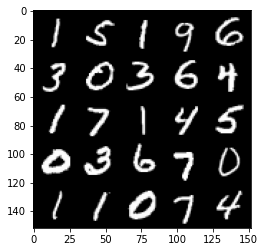

 41%|████      | 192/469 [00:07<00:11, 24.57it/s]

Epoch 232, step 109000 -> generator loss: 0.5507203227281567, discriminator loss: 0.5483098863959306


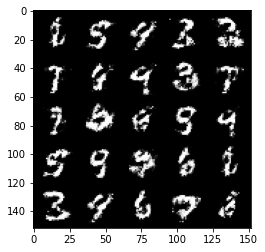

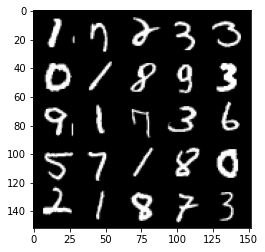

 47%|████▋     | 221/469 [00:09<00:10, 24.33it/s]

Epoch 233, step 109500 -> generator loss: 0.5548524335622785, discriminator loss: 0.5519400348067285


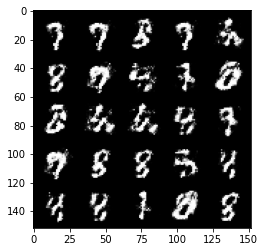

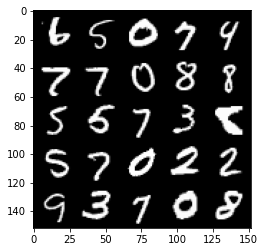

 54%|█████▎    | 252/469 [00:10<00:08, 25.43it/s]

Epoch 234, step 110000 -> generator loss: 0.5578988544940947, discriminator loss: 0.5463025585412976


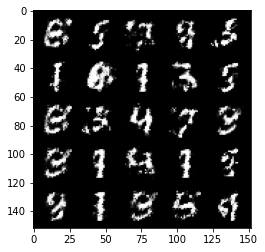

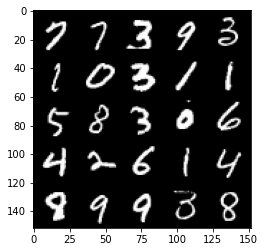

 61%|██████    | 285/469 [00:12<00:07, 24.36it/s]

Epoch 235, step 110500 -> generator loss: 0.5679724605083456, discriminator loss: 0.5353177023530014


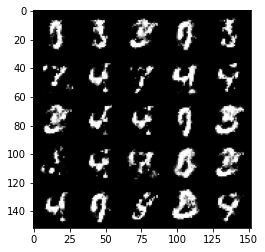

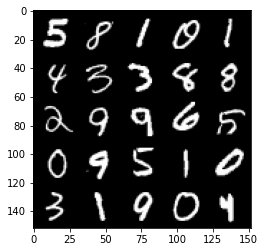

 67%|██████▋   | 315/469 [00:12<00:06, 25.55it/s]

Epoch 236, step 111000 -> generator loss: 0.5622093073129646, discriminator loss: 0.5457654562592502


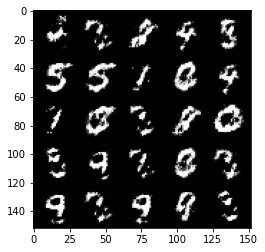

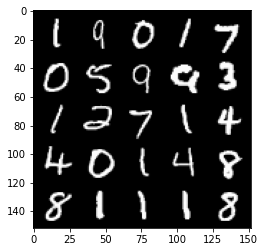

 74%|███████▍  | 347/469 [00:14<00:04, 24.49it/s]

Epoch 237, step 111500 -> generator loss: 0.5611743814349173, discriminator loss: 0.5417432830929756


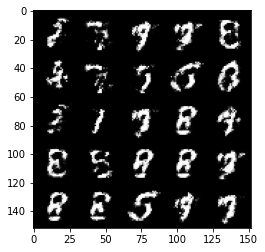

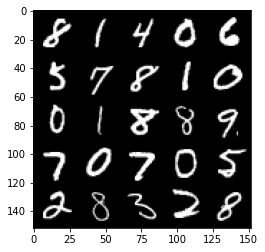

 80%|████████  | 377/469 [00:15<00:03, 25.18it/s]

Epoch 238, step 112000 -> generator loss: 0.5593472305536272, discriminator loss: 0.5428856964707374


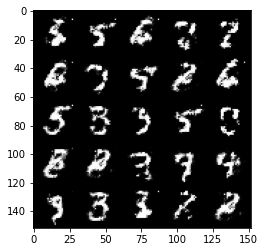

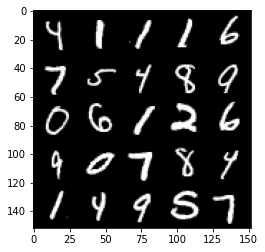

 87%|████████▋ | 408/469 [00:16<00:02, 25.28it/s]

Epoch 239, step 112500 -> generator loss: 0.5319114893674856, discriminator loss: 0.5826029225587847


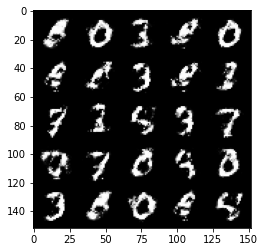

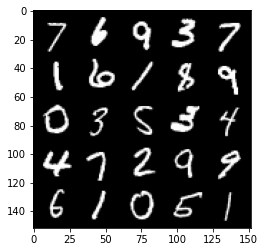

 93%|█████████▎| 438/469 [00:17<00:01, 25.17it/s]

Epoch 240, step 113000 -> generator loss: 0.5345580981373785, discriminator loss: 0.5807497129440311


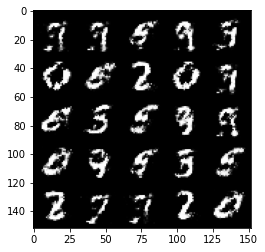

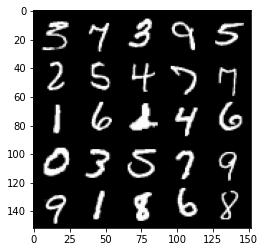

  0%|          | 2/469 [00:00<00:24, 18.92it/s]

Epoch 242, step 113500 -> generator loss: 0.5574292218089099, discriminator loss: 0.5497717275619511


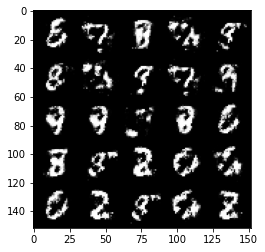

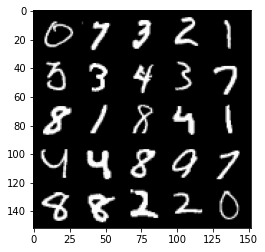

  7%|▋         | 33/469 [00:01<00:17, 25.42it/s]

Epoch 243, step 114000 -> generator loss: 0.557276256680489, discriminator loss: 0.5533220620155337


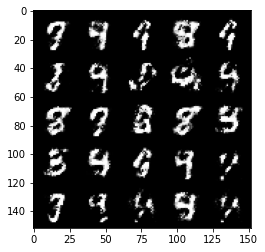

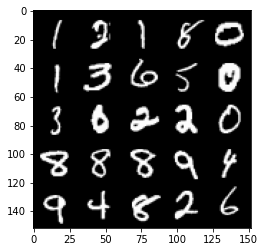

 13%|█▎        | 63/469 [00:02<00:16, 25.24it/s]

Epoch 244, step 114500 -> generator loss: 0.5349961642026901, discriminator loss: 0.584409722208977


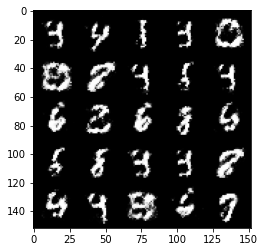

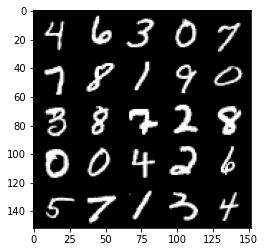

 20%|█▉        | 93/469 [00:03<00:15, 25.05it/s]

Epoch 245, step 115000 -> generator loss: 0.5620063485503201, discriminator loss: 0.5400404258966439


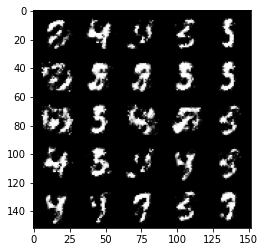

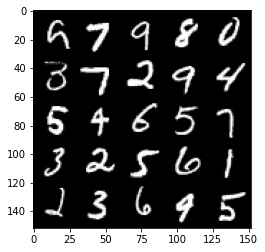

 26%|██▋       | 124/469 [00:05<00:14, 24.47it/s]

Epoch 246, step 115500 -> generator loss: 0.5540856789350509, discriminator loss: 0.553416756510735


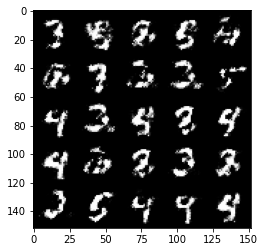

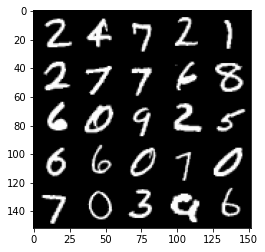

 33%|███▎      | 156/469 [00:06<00:12, 24.36it/s]

Epoch 247, step 116000 -> generator loss: 0.5417809802889818, discriminator loss: 0.5717404466271399


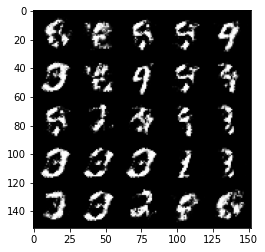

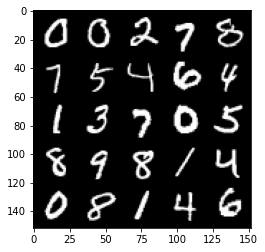

 40%|████      | 188/469 [00:07<00:11, 25.22it/s]

Epoch 248, step 116500 -> generator loss: 0.5397810890078547, discriminator loss: 0.5779144828319551


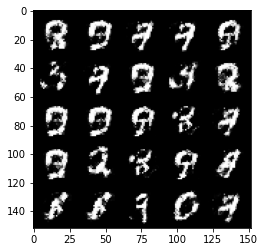

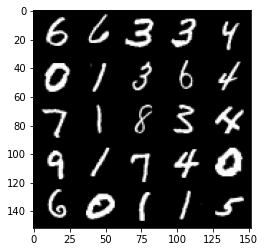

 47%|████▋     | 219/469 [00:08<00:09, 25.28it/s]

Epoch 249, step 117000 -> generator loss: 0.5324626377820969, discriminator loss: 0.5892705606222154


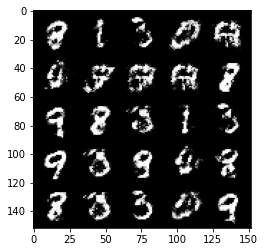

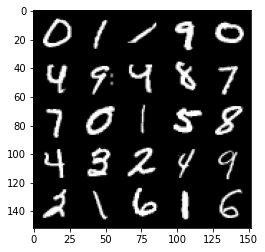

 53%|█████▎    | 250/469 [00:10<00:08, 25.18it/s]

Epoch 250, step 117500 -> generator loss: 0.5440063271522517, discriminator loss: 0.5689744830131525


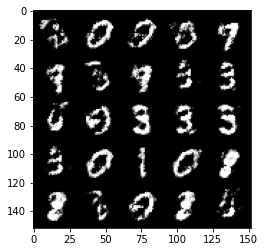

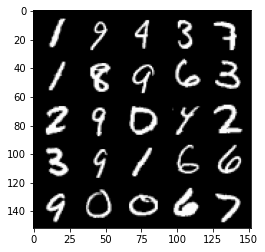

 60%|█████▉    | 281/469 [00:12<00:07, 24.59it/s]

Epoch 251, step 118000 -> generator loss: 0.5444978294968605, discriminator loss: 0.5623557512760163


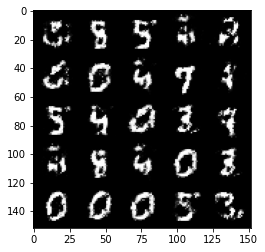

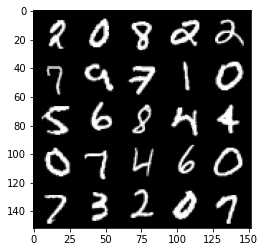

 66%|██████▋   | 311/469 [00:12<00:06, 23.95it/s]

Epoch 252, step 118500 -> generator loss: 0.532943440020085, discriminator loss: 0.5784139767885211


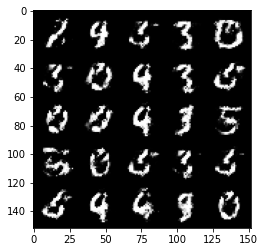

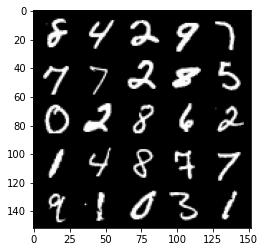

 73%|███████▎  | 342/469 [00:13<00:05, 25.00it/s]

Epoch 253, step 119000 -> generator loss: 0.5458845734000207, discriminator loss: 0.5602650437355041


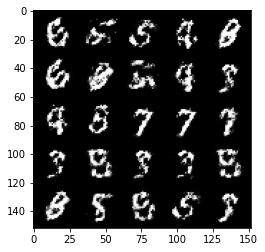

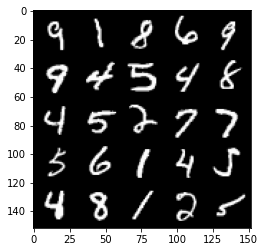

 79%|███████▉  | 372/469 [00:14<00:03, 25.37it/s]

Epoch 254, step 119500 -> generator loss: 0.5367802056074139, discriminator loss: 0.5793925222158439


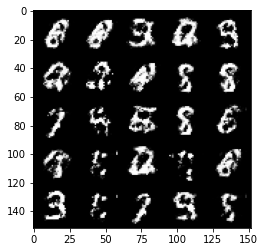

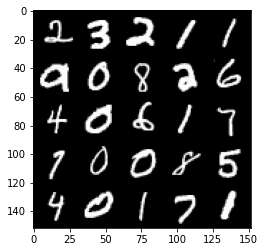

 86%|████████▌ | 404/469 [00:15<00:02, 25.08it/s]

Epoch 255, step 120000 -> generator loss: 0.5347267041206363, discriminator loss: 0.5786848217248917


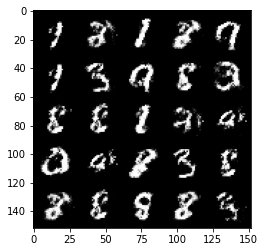

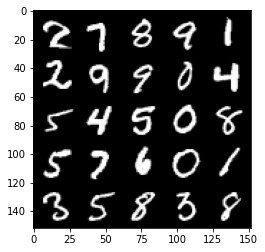

 93%|█████████▎| 435/469 [00:16<00:01, 25.31it/s]

Epoch 256, step 120500 -> generator loss: 0.5352019554376611, discriminator loss: 0.5808205029964446


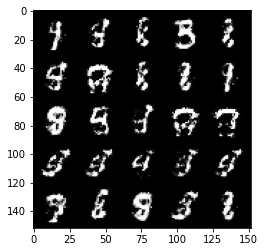

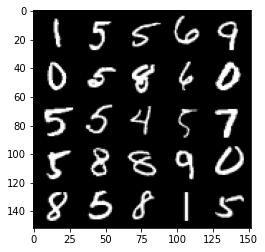

 99%|█████████▉| 465/469 [00:19<00:00, 22.26it/s]

Epoch 257, step 121000 -> generator loss: 0.53184930986166, discriminator loss: 0.5858699409961706


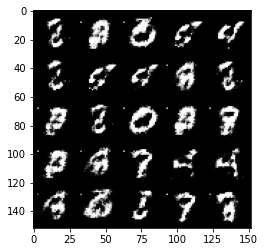

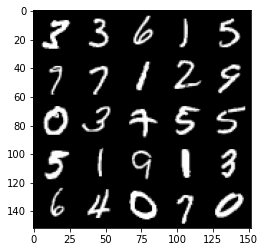

  6%|▌         | 27/469 [00:00<00:14, 29.49it/s]

Epoch 259, step 121500 -> generator loss: 0.5463772243261338, discriminator loss: 0.55707913184166


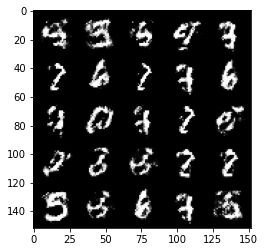

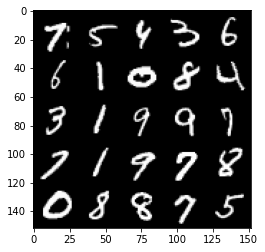

 13%|█▎        | 60/469 [00:02<00:16, 25.37it/s]

Epoch 260, step 122000 -> generator loss: 0.5418671084046365, discriminator loss: 0.5661865971088413


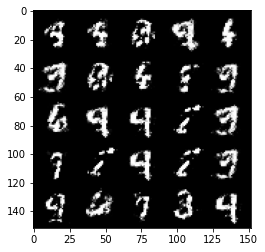

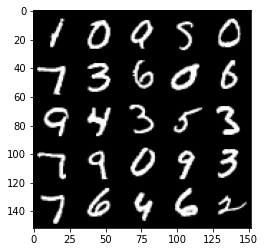

 19%|█▉        | 90/469 [00:03<00:15, 24.76it/s]

Epoch 261, step 122500 -> generator loss: 0.5543678912520401, discriminator loss: 0.5538861134052278


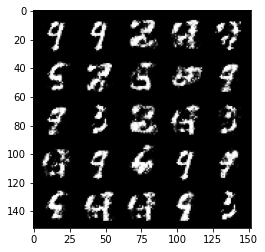

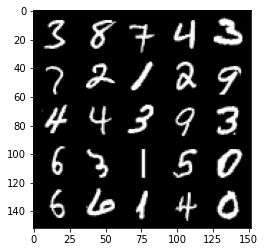

 26%|██▌       | 121/469 [00:05<00:13, 25.22it/s]

Epoch 262, step 123000 -> generator loss: 0.5497462782263759, discriminator loss: 0.5633942335844035


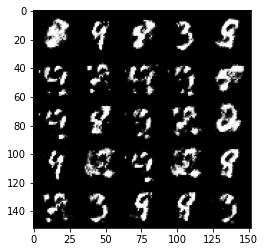

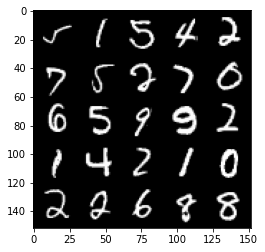

 33%|███▎      | 153/469 [00:06<00:12, 25.28it/s]

Epoch 263, step 123500 -> generator loss: 0.5686438037157052, discriminator loss: 0.5347123715877531


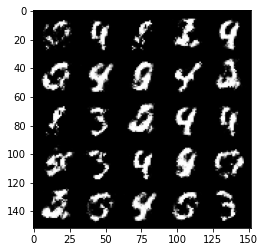

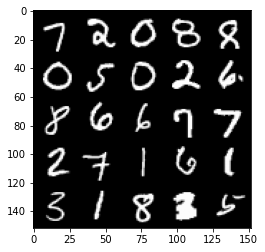

 39%|███▉      | 183/469 [00:08<00:18, 15.11it/s]

Epoch 264, step 124000 -> generator loss: 0.539848688781262, discriminator loss: 0.5751926603317261


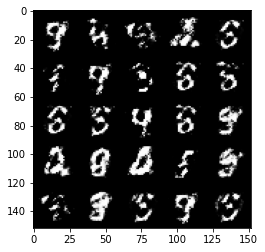

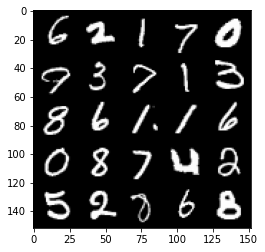

 46%|████▌     | 215/469 [00:09<00:11, 23.00it/s]

Epoch 265, step 124500 -> generator loss: 0.5457400965094563, discriminator loss: 0.5757298289537428


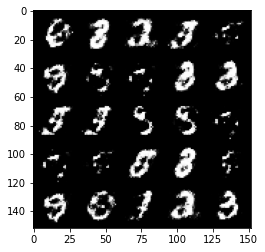

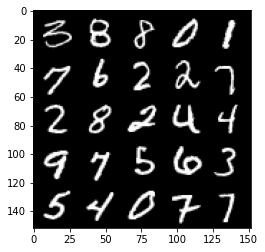

 52%|█████▏    | 244/469 [00:11<00:08, 25.02it/s]

Epoch 266, step 125000 -> generator loss: 0.549105970323086, discriminator loss: 0.5576907455921167


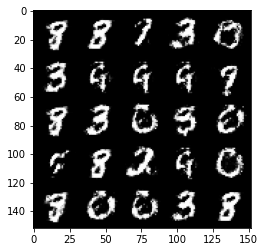

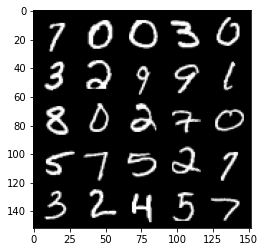

 59%|█████▊    | 275/469 [00:15<00:08, 23.35it/s]

Epoch 267, step 125500 -> generator loss: 0.5361493263840674, discriminator loss: 0.5770833212137221


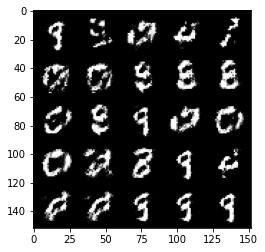

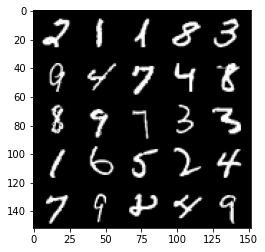

 65%|██████▌   | 306/469 [00:12<00:06, 24.75it/s]

Epoch 268, step 126000 -> generator loss: 0.5324721194505698, discriminator loss: 0.5819054971933361


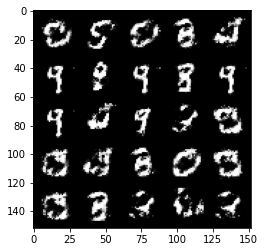

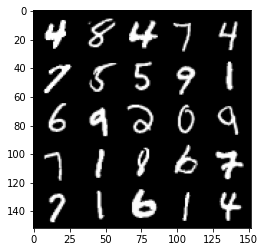

 72%|███████▏  | 337/469 [00:14<00:05, 25.21it/s]

Epoch 269, step 126500 -> generator loss: 0.5251297164559371, discriminator loss: 0.5956145226955413


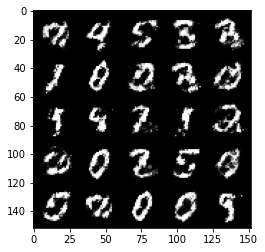

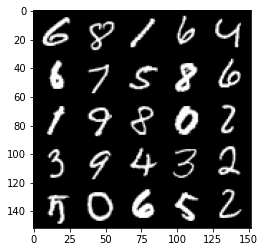

 79%|███████▉  | 370/469 [00:16<00:05, 17.56it/s]

Epoch 270, step 127000 -> generator loss: 0.5312986416816716, discriminator loss: 0.5806078774929051


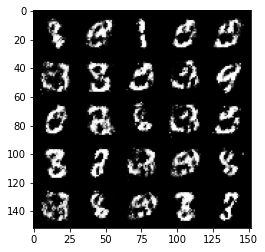

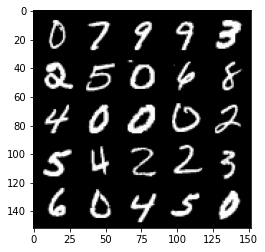

 85%|████████▌ | 399/469 [00:16<00:02, 25.01it/s]

Epoch 271, step 127500 -> generator loss: 0.5294505233168606, discriminator loss: 0.5908491655588147


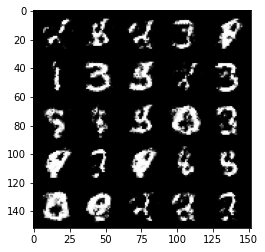

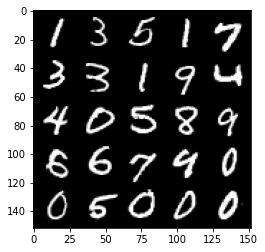

 92%|█████████▏| 432/469 [00:16<00:01, 25.18it/s]

Epoch 272, step 128000 -> generator loss: 0.5340915326476096, discriminator loss: 0.5864431242942812


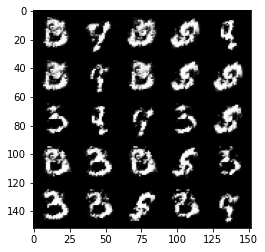

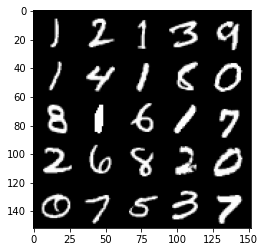

 99%|█████████▊| 462/469 [00:18<00:00, 25.33it/s]

Epoch 273, step 128500 -> generator loss: 0.5432882519960399, discriminator loss: 0.5660202831029899


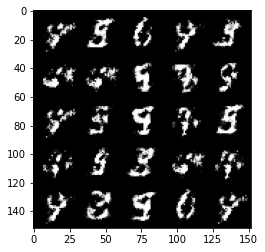

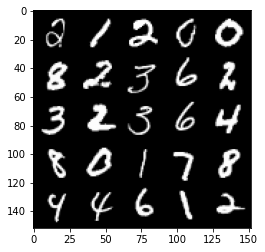

  5%|▌         | 24/469 [00:00<00:17, 25.09it/s]

Epoch 275, step 129000 -> generator loss: 0.5511652524471281, discriminator loss: 0.555823825418949


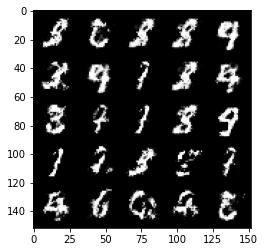

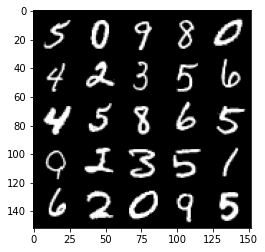

 12%|█▏        | 55/469 [00:03<00:21, 19.38it/s]

Epoch 276, step 129500 -> generator loss: 0.5485777261257172, discriminator loss: 0.561178730130196


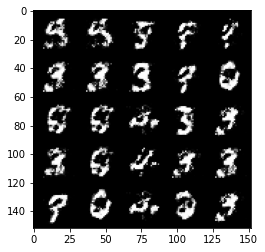

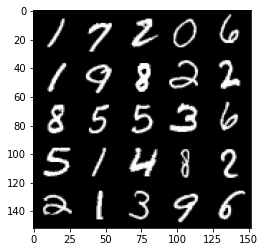

 19%|█▊        | 87/469 [00:03<00:15, 24.40it/s]

Epoch 277, step 130000 -> generator loss: 0.5431080190539358, discriminator loss: 0.5605188808441165


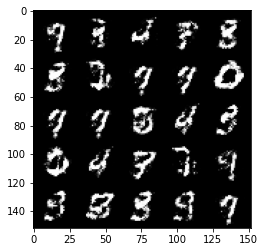

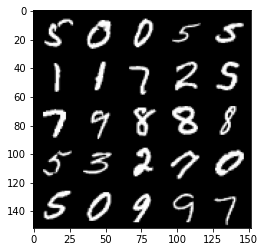

 25%|██▍       | 117/469 [00:04<00:14, 24.52it/s]

Epoch 278, step 130500 -> generator loss: 0.5519787279963493, discriminator loss: 0.548624107718468


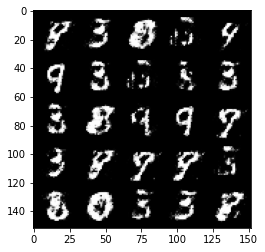

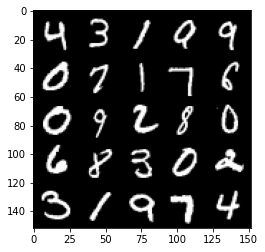

 31%|███▏      | 147/469 [00:05<00:12, 25.27it/s]

Epoch 279, step 131000 -> generator loss: 0.5439072355628007, discriminator loss: 0.5643131828308103


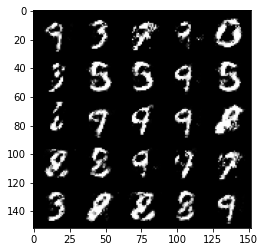

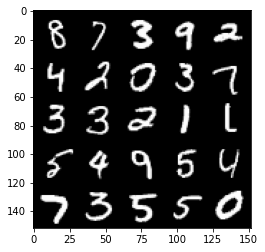

 38%|███▊      | 180/469 [00:07<00:11, 25.23it/s]

Epoch 280, step 131500 -> generator loss: 0.5505229136943817, discriminator loss: 0.5497170953750607


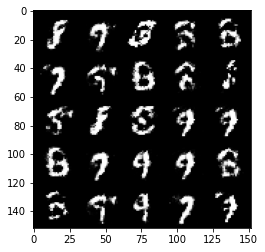

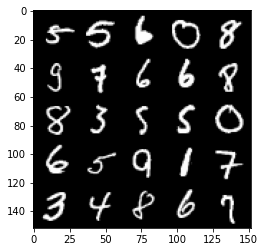

 45%|████▍     | 210/469 [00:08<00:10, 23.74it/s]

Epoch 281, step 132000 -> generator loss: 0.5422295093536376, discriminator loss: 0.5660899688005451


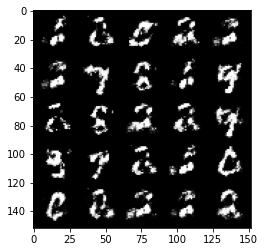

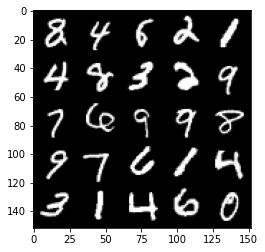

 52%|█████▏    | 242/469 [00:11<00:09, 24.83it/s]

Epoch 282, step 132500 -> generator loss: 0.5659334266185757, discriminator loss: 0.5408442133665083


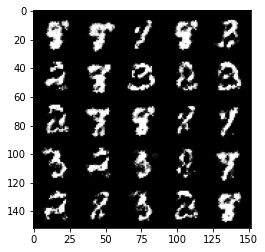

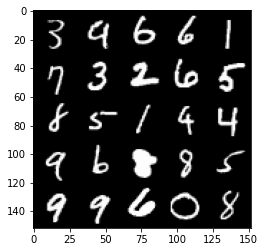

 58%|█████▊    | 273/469 [00:11<00:07, 25.00it/s]

Epoch 283, step 133000 -> generator loss: 0.5600410439968111, discriminator loss: 0.5451440935134886


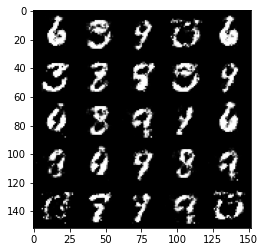

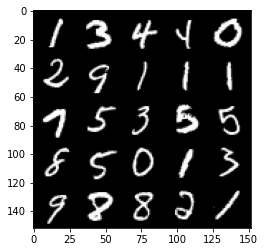

 64%|██████▍   | 302/469 [00:13<00:06, 25.39it/s]

Epoch 284, step 133500 -> generator loss: 0.549073105990887, discriminator loss: 0.5623030577898024


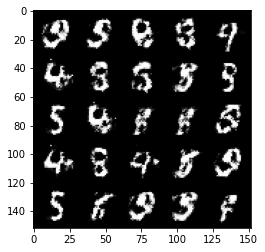

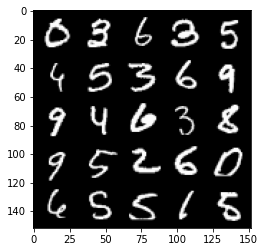

 71%|███████   | 333/469 [00:13<00:05, 25.56it/s]

Epoch 285, step 134000 -> generator loss: 0.5504924393296249, discriminator loss: 0.5549332713484764


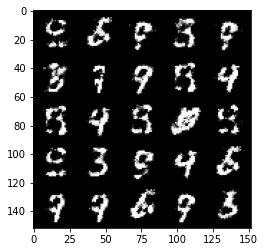

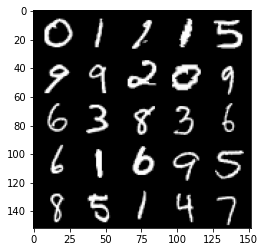

 78%|███████▊  | 366/469 [00:15<00:04, 25.43it/s]

Epoch 286, step 134500 -> generator loss: 0.5611023678779599, discriminator loss: 0.5429083484411237


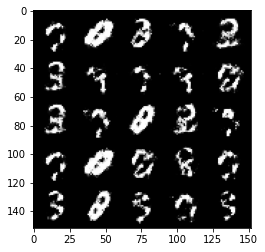

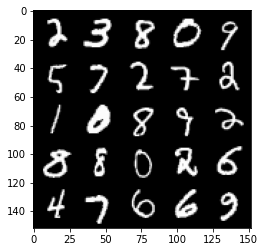

 84%|████████▍ | 396/469 [00:16<00:02, 25.26it/s]

Epoch 287, step 135000 -> generator loss: 0.5448032779097555, discriminator loss: 0.5618904910087588


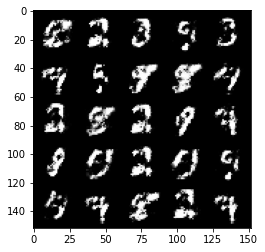

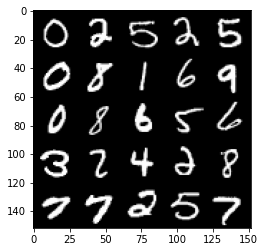

 91%|█████████▏| 428/469 [00:19<00:01, 21.71it/s]

Epoch 288, step 135500 -> generator loss: 0.5576217665076262, discriminator loss: 0.5404371132254602


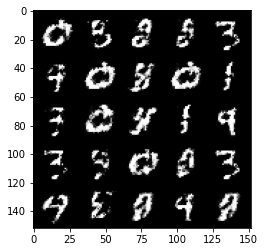

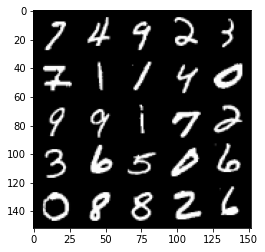

 98%|█████████▊| 459/469 [00:17<00:00, 25.28it/s]

Epoch 289, step 136000 -> generator loss: 0.5451158902049066, discriminator loss: 0.5550361180305484


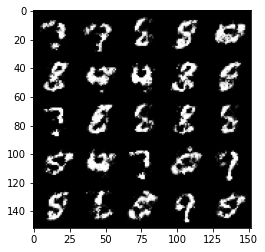

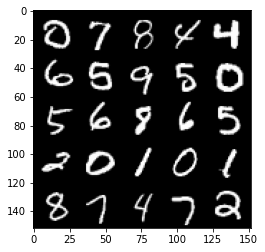

  4%|▍         | 21/469 [00:00<00:18, 23.83it/s]

Epoch 291, step 136500 -> generator loss: 0.5534443152546881, discriminator loss: 0.5517594583034516


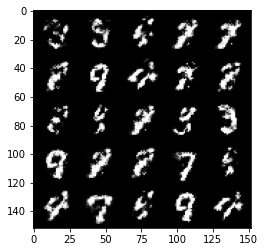

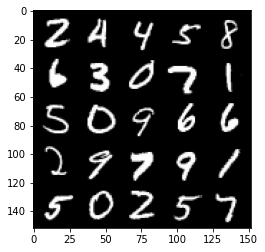

 11%|█         | 52/469 [00:02<00:16, 24.60it/s]

Epoch 292, step 137000 -> generator loss: 0.5265586971044541, discriminator loss: 0.5854964109659192


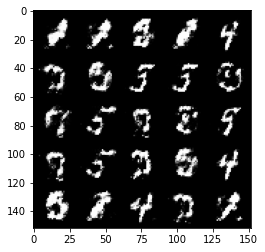

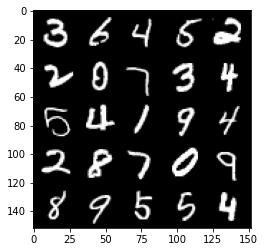

 17%|█▋        | 82/469 [00:03<00:15, 24.91it/s]

Epoch 293, step 137500 -> generator loss: 0.5457889508008963, discriminator loss: 0.5616154080629349


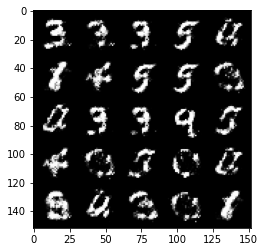

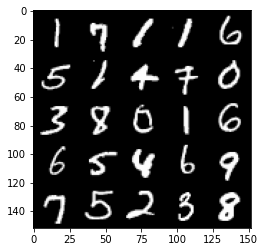

 24%|██▍       | 113/469 [00:04<00:14, 24.27it/s]

Epoch 294, step 138000 -> generator loss: 0.5445748925805092, discriminator loss: 0.5689630652666091


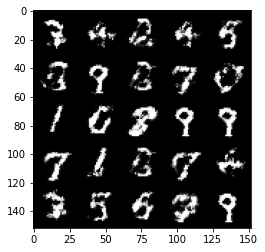

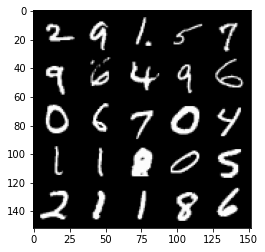

 31%|███       | 144/469 [00:05<00:12, 25.28it/s]

Epoch 295, step 138500 -> generator loss: 0.5365678876638409, discriminator loss: 0.5723565293550494


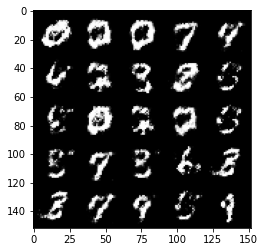

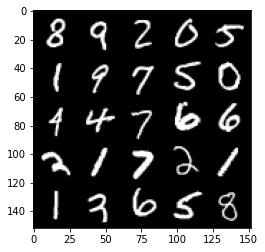

 37%|███▋      | 175/469 [00:07<00:15, 19.40it/s]

Epoch 296, step 139000 -> generator loss: 0.5371928921341897, discriminator loss: 0.5718681210279468


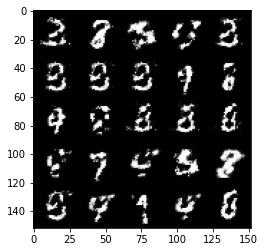

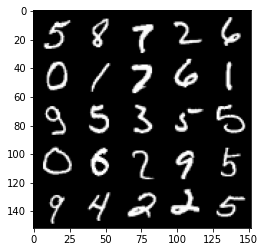

 44%|████▎     | 205/469 [00:08<00:10, 24.66it/s]

Epoch 297, step 139500 -> generator loss: 0.5462717942595482, discriminator loss: 0.5563493027687076


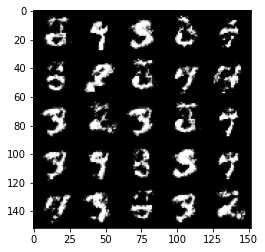

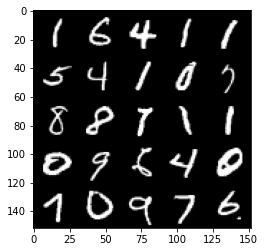

 51%|█████     | 238/469 [00:10<00:09, 25.12it/s]

Epoch 298, step 140000 -> generator loss: 0.5396581345796582, discriminator loss: 0.5685119247436522


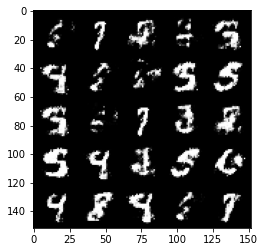

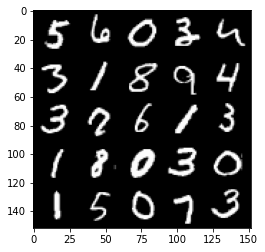

 57%|█████▋    | 269/469 [00:11<00:08, 23.64it/s]

Epoch 299, step 140500 -> generator loss: 0.5436811388731002, discriminator loss: 0.5687405321598051


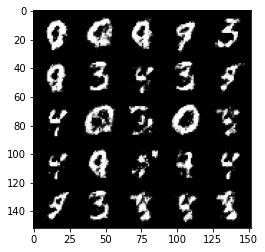

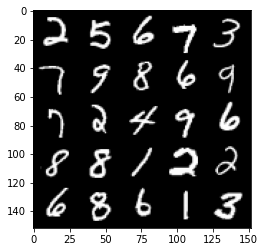

 64%|██████▍   | 299/469 [00:12<00:07, 24.00it/s]

Epoch 300, step 141000 -> generator loss: 0.5208967493176463, discriminator loss: 0.5875876282453545


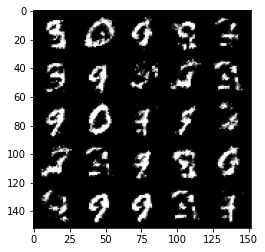

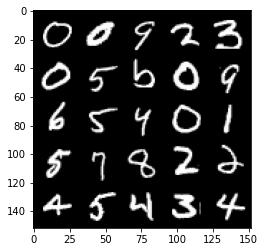

 70%|███████   | 330/469 [00:13<00:05, 24.53it/s]

Epoch 301, step 141500 -> generator loss: 0.544704530775547, discriminator loss: 0.5618725433945654


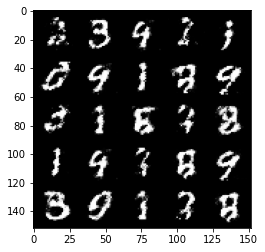

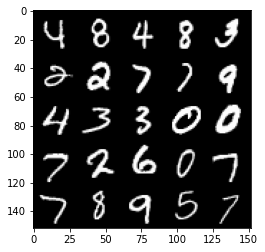

 77%|███████▋  | 362/469 [00:15<00:04, 25.01it/s]

Epoch 302, step 142000 -> generator loss: 0.5302138776779174, discriminator loss: 0.5835389786958688


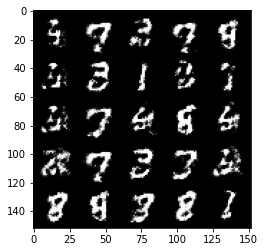

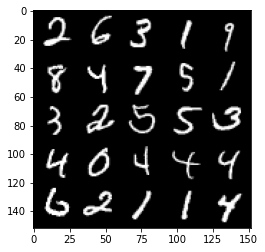

 84%|████████▎ | 392/469 [00:15<00:03, 24.94it/s]

Epoch 303, step 142500 -> generator loss: 0.5514138277769094, discriminator loss: 0.5531455101370808


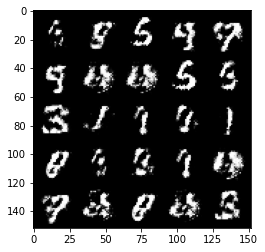

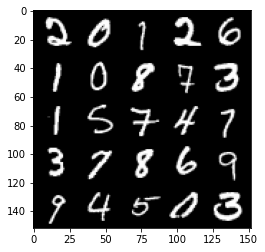

 90%|█████████ | 423/469 [00:16<00:01, 25.40it/s]

Epoch 304, step 143000 -> generator loss: 0.5487287713885307, discriminator loss: 0.5587100433111197


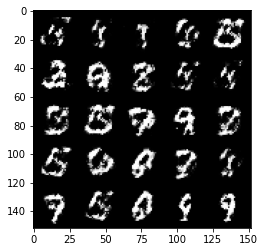

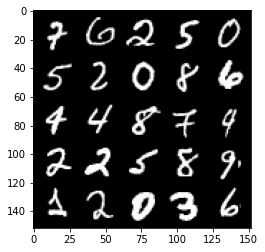

 97%|█████████▋| 453/469 [00:19<00:00, 24.90it/s]

Epoch 305, step 143500 -> generator loss: 0.5413901831507686, discriminator loss: 0.5707056186795234


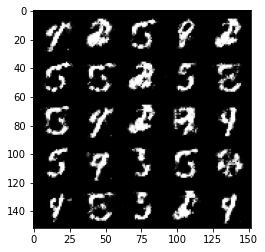

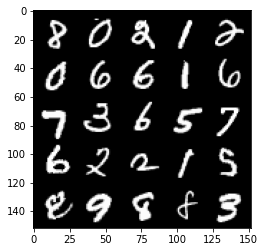

  3%|▎         | 15/469 [00:00<00:18, 24.12it/s]

Epoch 307, step 144000 -> generator loss: 0.5314533119201664, discriminator loss: 0.5829671742916105


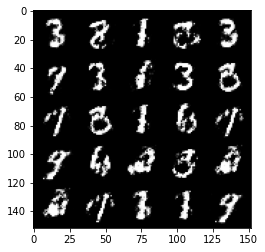

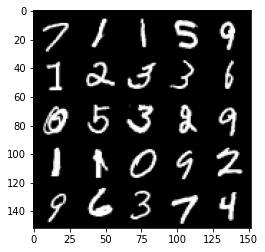

 10%|█         | 48/469 [00:01<00:16, 25.08it/s]

Epoch 308, step 144500 -> generator loss: 0.5128841370940204, discriminator loss: 0.6076468861103055


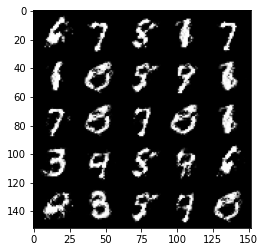

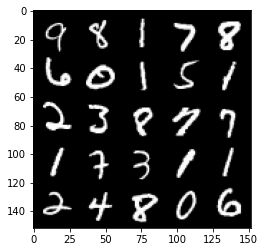

 17%|█▋        | 78/469 [00:03<00:15, 25.43it/s]

Epoch 309, step 145000 -> generator loss: 0.5316704941391944, discriminator loss: 0.5784959031343461


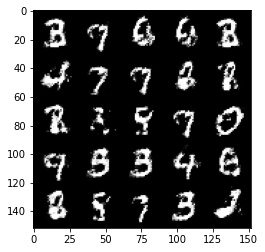

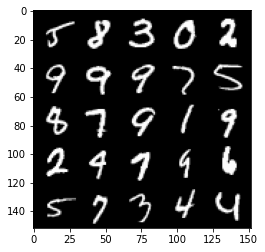

 23%|██▎       | 108/469 [00:04<00:14, 24.12it/s]

Epoch 310, step 145500 -> generator loss: 0.5379084786176682, discriminator loss: 0.5674542080760006


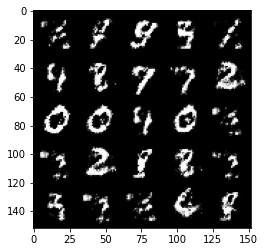

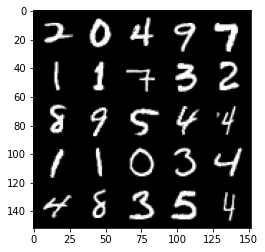

 30%|███       | 141/469 [00:05<00:13, 24.24it/s]

Epoch 311, step 146000 -> generator loss: 0.5458670145273206, discriminator loss: 0.5656004981994626


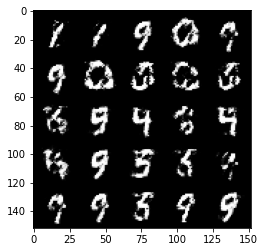

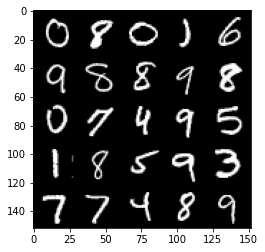

 36%|███▋      | 171/469 [00:06<00:11, 25.10it/s]

Epoch 312, step 146500 -> generator loss: 0.5319073107242581, discriminator loss: 0.5763249613046648


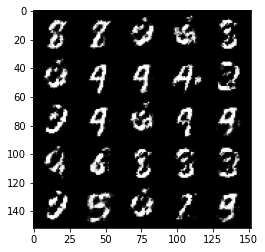

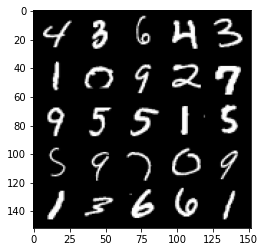

 43%|████▎     | 201/469 [00:08<00:10, 25.47it/s]

Epoch 313, step 147000 -> generator loss: 0.5488775959014889, discriminator loss: 0.5520446212291719


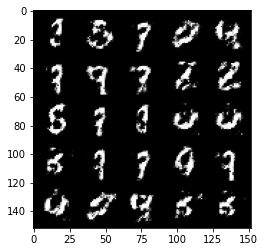

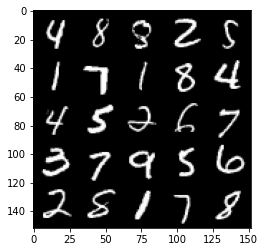

 50%|████▉     | 234/469 [00:09<00:09, 23.68it/s]

Epoch 314, step 147500 -> generator loss: 0.5444627323746679, discriminator loss: 0.5629282377958301


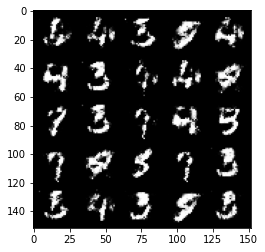

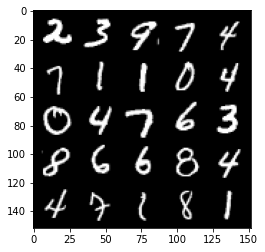

 56%|█████▋    | 264/469 [00:10<00:08, 24.68it/s]

Epoch 315, step 148000 -> generator loss: 0.5692926627397537, discriminator loss: 0.5266822968721391


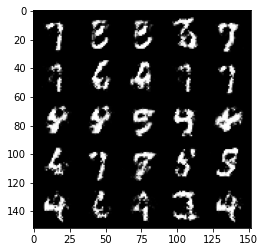

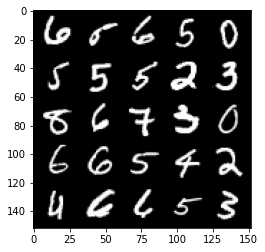

 63%|██████▎   | 294/469 [00:11<00:06, 25.11it/s]

Epoch 316, step 148500 -> generator loss: 0.5443690471053126, discriminator loss: 0.5634953787326816


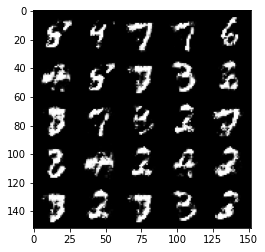

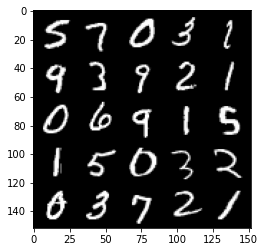

 70%|██████▉   | 326/469 [00:12<00:05, 24.69it/s]

Epoch 317, step 149000 -> generator loss: 0.5577916292548177, discriminator loss: 0.5454662649631498


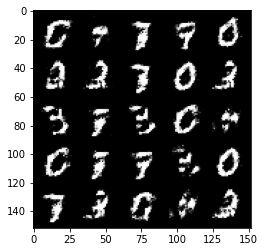

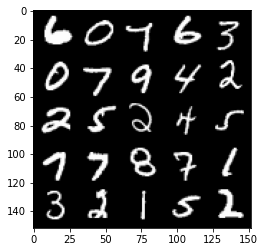

 76%|███████▌  | 357/469 [00:16<00:05, 22.09it/s]

Epoch 318, step 149500 -> generator loss: 0.5545181781649595, discriminator loss: 0.5497360696196556


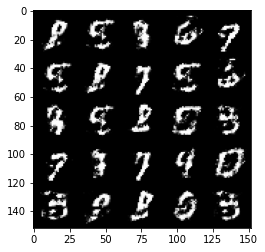

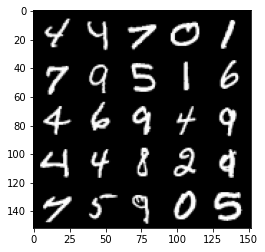

 83%|████████▎ | 388/469 [00:15<00:03, 23.80it/s]

Epoch 319, step 150000 -> generator loss: 0.5412064018845554, discriminator loss: 0.5659859991669657


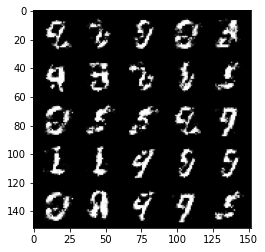

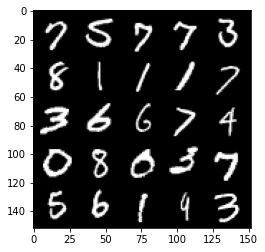

 89%|████████▉ | 419/469 [00:17<00:02, 24.12it/s]

Epoch 320, step 150500 -> generator loss: 0.5551602032780648, discriminator loss: 0.546254985451698


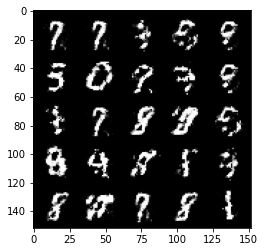

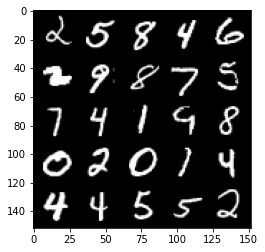

 96%|█████████▌| 449/469 [00:18<00:00, 25.00it/s]

Epoch 321, step 151000 -> generator loss: 0.5402390737533566, discriminator loss: 0.5736038784980775


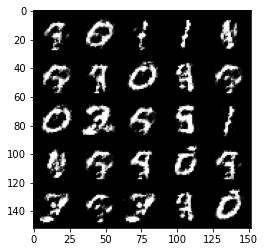

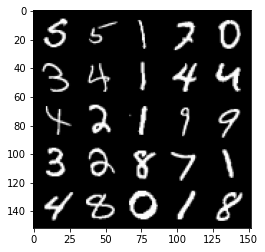

  3%|▎         | 12/469 [00:00<00:19, 23.60it/s]

Epoch 323, step 151500 -> generator loss: 0.5415101051330569, discriminator loss: 0.5708162938356401


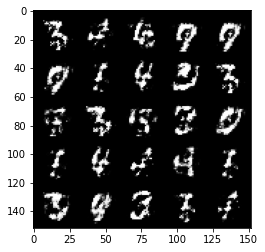

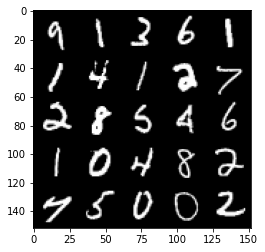

  9%|▉         | 42/469 [00:01<00:16, 25.24it/s]

Epoch 324, step 152000 -> generator loss: 0.5504029895663264, discriminator loss: 0.5566573911309247


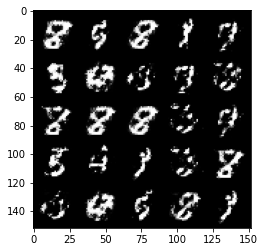

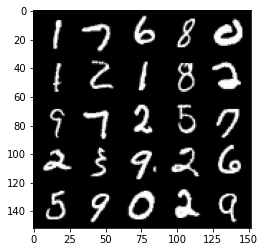

 16%|█▌        | 75/469 [00:03<00:17, 22.84it/s]

Epoch 325, step 152500 -> generator loss: 0.5594880809187892, discriminator loss: 0.5402687366008757


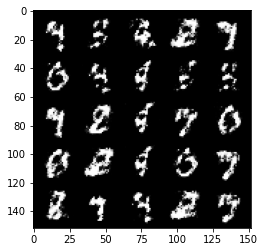

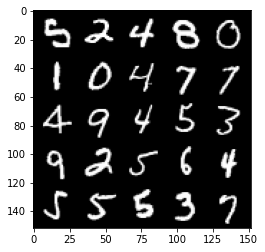

 23%|██▎       | 106/469 [00:04<00:14, 24.96it/s]

Epoch 326, step 153000 -> generator loss: 0.5396106749773028, discriminator loss: 0.5717944009304047


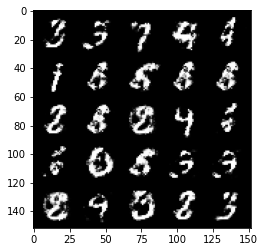

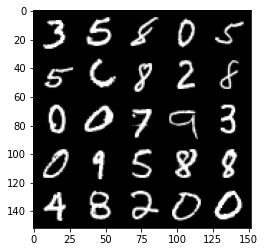

 29%|██▉       | 135/469 [00:05<00:13, 24.36it/s]

Epoch 327, step 153500 -> generator loss: 0.5318636698722838, discriminator loss: 0.5815244914293293


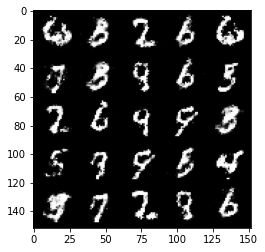

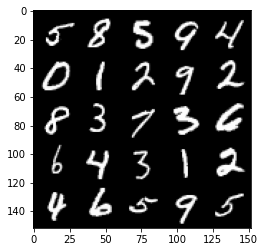

 36%|███▌      | 168/469 [00:06<00:11, 25.34it/s]

Epoch 328, step 154000 -> generator loss: 0.5265579276084897, discriminator loss: 0.5892697927951808


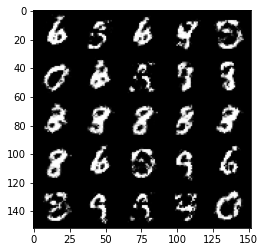

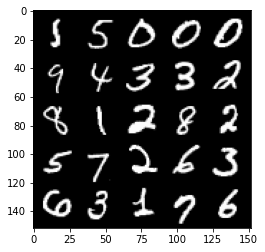

 42%|████▏     | 198/469 [00:09<00:11, 23.89it/s]

Epoch 329, step 154500 -> generator loss: 0.5378383241295812, discriminator loss: 0.565985541582107


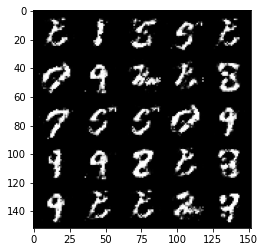

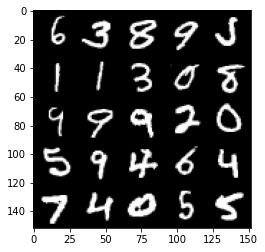

 49%|████▊     | 228/469 [00:09<00:09, 25.39it/s]

Epoch 330, step 155000 -> generator loss: 0.5390397487282755, discriminator loss: 0.5726226658821109


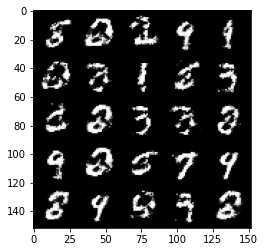

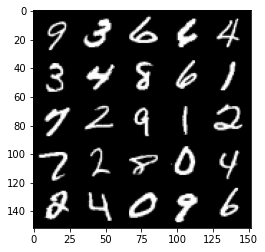

 55%|█████▌    | 260/469 [00:11<00:08, 24.88it/s]

Epoch 331, step 155500 -> generator loss: 0.5315421544909474, discriminator loss: 0.5809569661617281


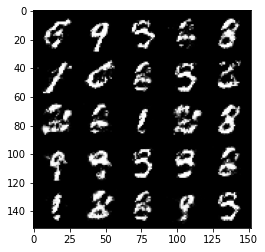

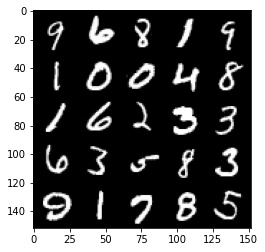

 62%|██████▏   | 291/469 [00:13<00:07, 23.65it/s]

Epoch 332, step 156000 -> generator loss: 0.5329856587052343, discriminator loss: 0.5688896932601932


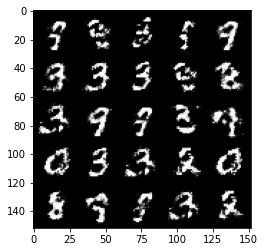

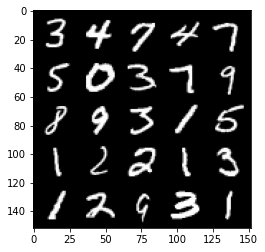

 69%|██████▉   | 323/469 [00:13<00:05, 25.37it/s]

Epoch 333, step 156500 -> generator loss: 0.5555319887995723, discriminator loss: 0.5438005215525624


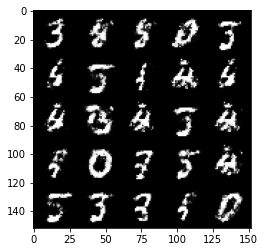

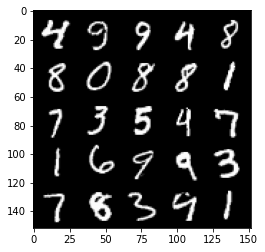

 75%|███████▌  | 354/469 [00:14<00:04, 25.05it/s]

Epoch 334, step 157000 -> generator loss: 0.5496451491713528, discriminator loss: 0.5585730906128881


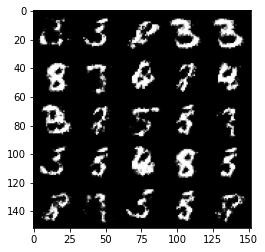

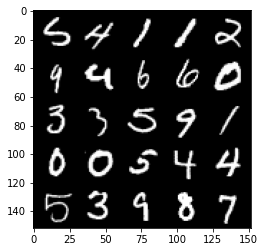

 82%|████████▏ | 383/469 [00:16<00:03, 24.95it/s]

Epoch 335, step 157500 -> generator loss: 0.5425156437754626, discriminator loss: 0.5706926528215414


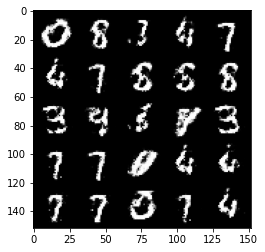

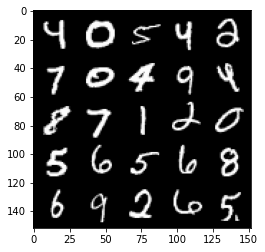

 89%|████████▊ | 416/469 [00:17<00:02, 25.34it/s]

Epoch 336, step 158000 -> generator loss: 0.5502156537771227, discriminator loss: 0.5572351930737489


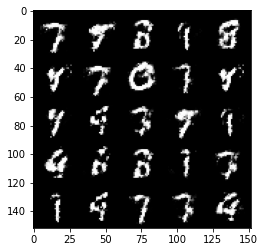

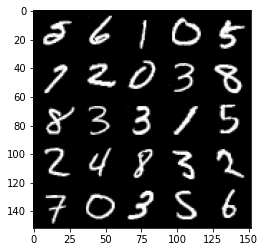

 95%|█████████▌| 447/469 [00:17<00:00, 24.41it/s]

Epoch 337, step 158500 -> generator loss: 0.544334290802479, discriminator loss: 0.5615686967372896


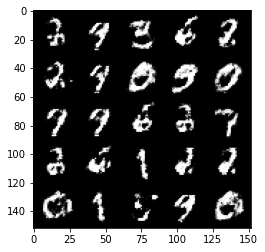

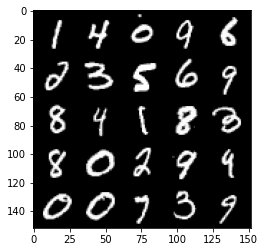

  1%|▏         | 7/469 [00:00<00:21, 21.47it/s]

Epoch 339, step 159000 -> generator loss: 0.5271688757538794, discriminator loss: 0.5797585989236834


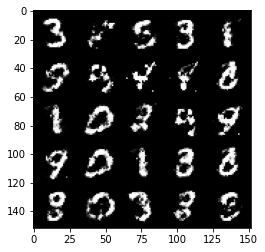

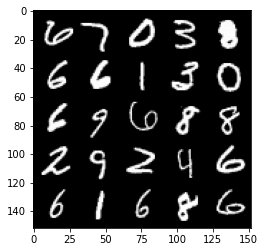

  8%|▊         | 39/469 [00:01<00:17, 24.91it/s]

Epoch 340, step 159500 -> generator loss: 0.5285474616289132, discriminator loss: 0.5843536783456807


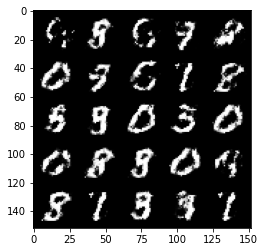

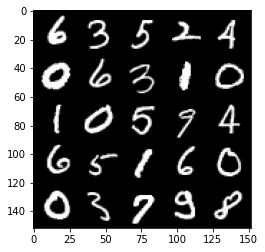

 15%|█▌        | 71/469 [00:02<00:15, 25.03it/s]

Epoch 341, step 160000 -> generator loss: 0.5322127726674077, discriminator loss: 0.5811136171817785


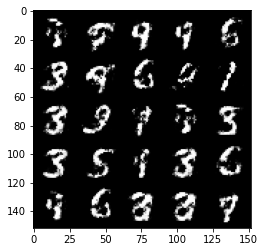

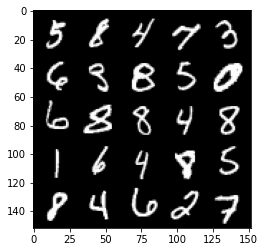

 22%|██▏       | 101/469 [00:04<00:15, 24.44it/s]

Epoch 342, step 160500 -> generator loss: 0.5090414050221443, discriminator loss: 0.6159312895536423


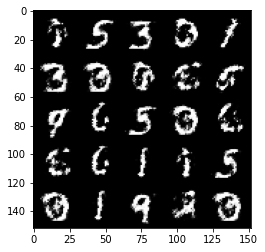

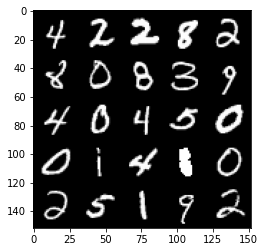

 28%|██▊       | 131/469 [00:08<00:20, 16.88it/s]

Epoch 343, step 161000 -> generator loss: 0.5164196432828904, discriminator loss: 0.6001947437524793


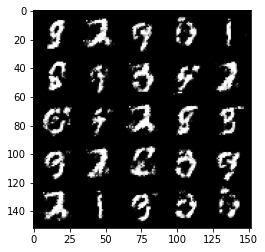

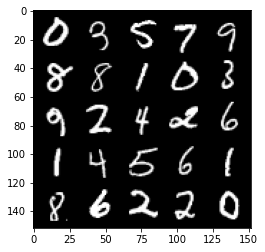

 35%|███▍      | 162/469 [00:06<00:12, 25.55it/s]

Epoch 344, step 161500 -> generator loss: 0.5264967099428178, discriminator loss: 0.5864620758295062


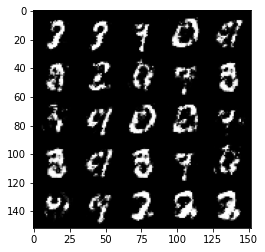

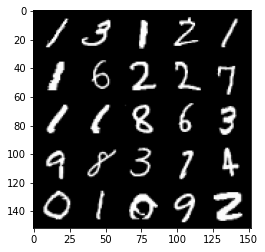

 42%|████▏     | 195/469 [00:07<00:11, 24.51it/s]

Epoch 345, step 162000 -> generator loss: 0.5277043684720989, discriminator loss: 0.5813971668481832


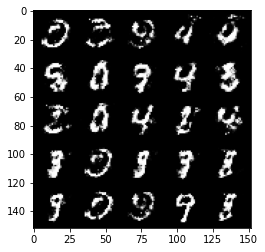

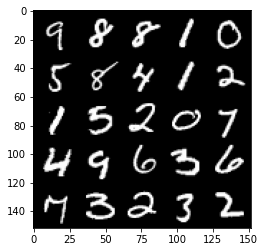

 48%|████▊     | 225/469 [00:09<00:09, 25.53it/s]

Epoch 346, step 162500 -> generator loss: 0.5531496852636336, discriminator loss: 0.5487594390511514


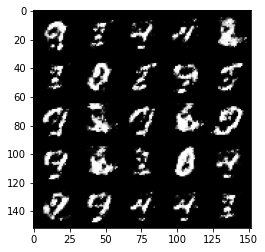

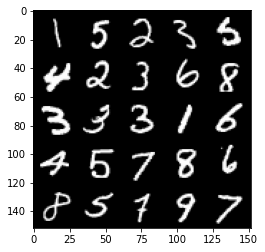

 54%|█████▍    | 255/469 [00:10<00:09, 23.03it/s]

Epoch 347, step 163000 -> generator loss: 0.5478164968490594, discriminator loss: 0.5601064493656158


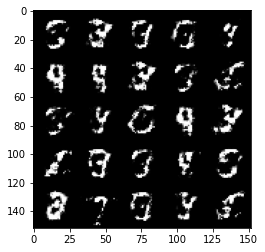

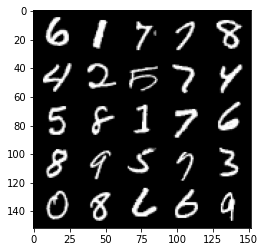

 61%|██████▏   | 288/469 [00:11<00:07, 25.33it/s]

Epoch 348, step 163500 -> generator loss: 0.5415202823877331, discriminator loss: 0.5668525533676152


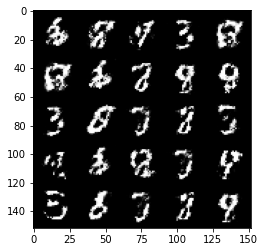

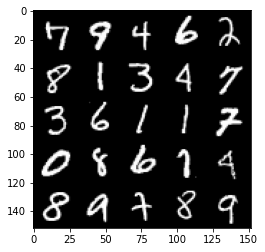

 68%|██████▊   | 319/469 [00:14<00:07, 19.92it/s]

Epoch 349, step 164000 -> generator loss: 0.548268403947353, discriminator loss: 0.5521789715290069


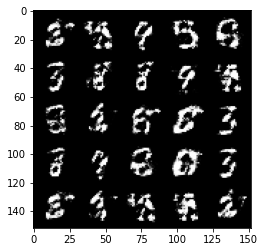

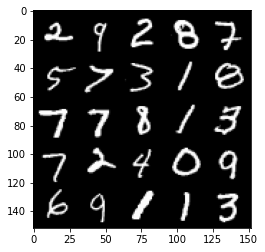

 74%|███████▍  | 349/469 [00:13<00:04, 24.59it/s]

Epoch 350, step 164500 -> generator loss: 0.5407284242510799, discriminator loss: 0.5643612567186351


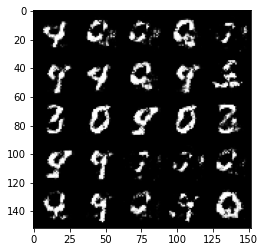

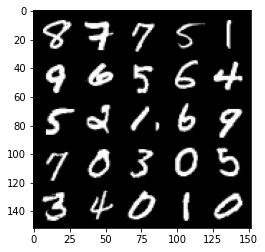

 81%|████████  | 381/469 [00:15<00:03, 25.00it/s]

Epoch 351, step 165000 -> generator loss: 0.5476446337103844, discriminator loss: 0.5559656778573989


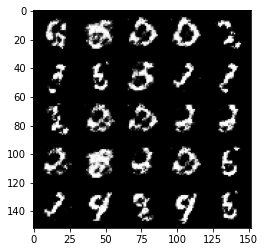

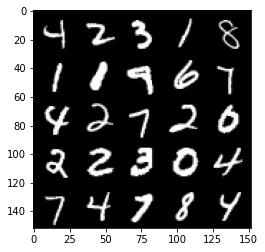

 88%|████████▊ | 412/469 [00:15<00:02, 25.17it/s]

Epoch 352, step 165500 -> generator loss: 0.5497462832331658, discriminator loss: 0.5540129100084312


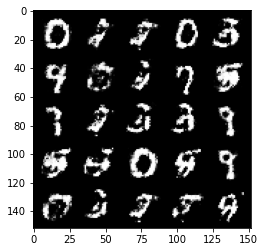

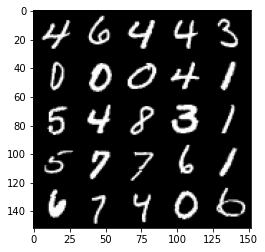

 94%|█████████▍| 441/469 [00:17<00:01, 24.29it/s]

Epoch 353, step 166000 -> generator loss: 0.5466583999991417, discriminator loss: 0.5602807004451754


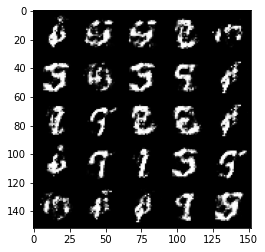

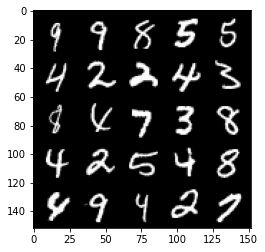

  1%|          | 3/469 [00:00<00:23, 19.79it/s]

Epoch 355, step 166500 -> generator loss: 0.5276759800314904, discriminator loss: 0.58359066927433


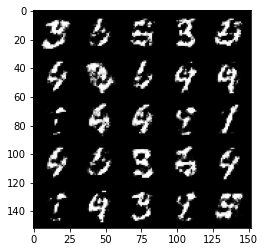

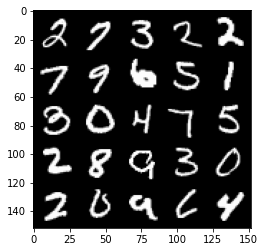

  8%|▊         | 36/469 [00:01<00:17, 24.25it/s]

Epoch 356, step 167000 -> generator loss: 0.525832727134228, discriminator loss: 0.5913794679641722


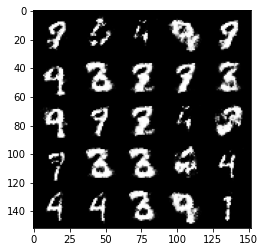

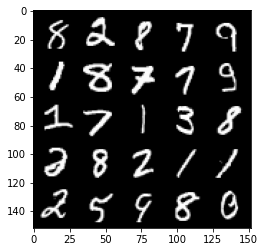

 14%|█▍        | 66/469 [00:02<00:16, 24.96it/s]

Epoch 357, step 167500 -> generator loss: 0.5334402279853819, discriminator loss: 0.5788445791006089


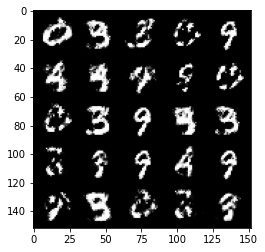

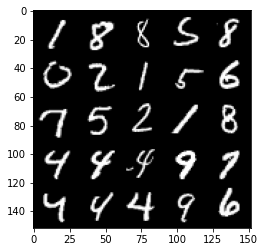

 21%|██        | 97/469 [00:04<00:14, 25.28it/s]

Epoch 358, step 168000 -> generator loss: 0.5548821970224377, discriminator loss: 0.5451862078309055


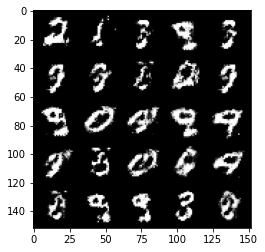

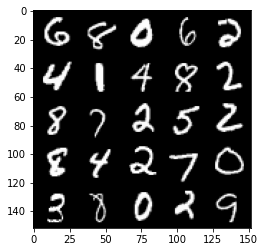

 28%|██▊       | 129/469 [00:05<00:13, 25.01it/s]

Epoch 359, step 168500 -> generator loss: 0.5457066619992256, discriminator loss: 0.5567171279788011


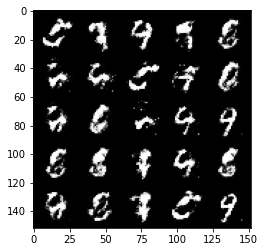

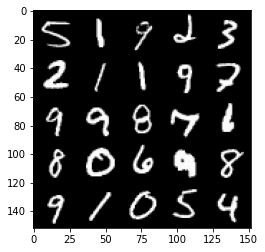

 34%|███▍      | 159/469 [00:06<00:12, 24.64it/s]

Epoch 360, step 169000 -> generator loss: 0.540671619415283, discriminator loss: 0.5655148302912713


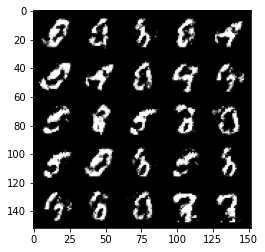

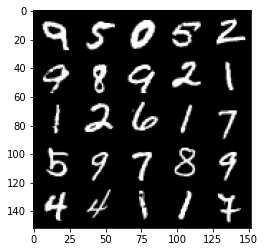

 40%|████      | 189/469 [00:07<00:11, 24.92it/s]

Epoch 361, step 169500 -> generator loss: 0.55342305958271, discriminator loss: 0.5485513513088226


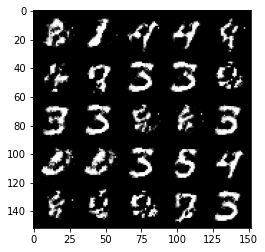

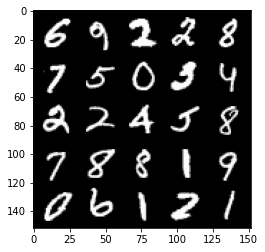

 47%|████▋     | 222/469 [00:08<00:10, 24.42it/s]

Epoch 362, step 170000 -> generator loss: 0.5490861196517943, discriminator loss: 0.5516946236491205


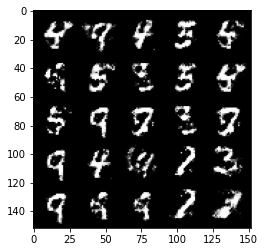

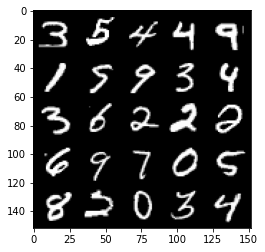

 54%|█████▎    | 252/469 [00:10<00:09, 23.82it/s]

Epoch 363, step 170500 -> generator loss: 0.542674846470356, discriminator loss: 0.5652614231705672


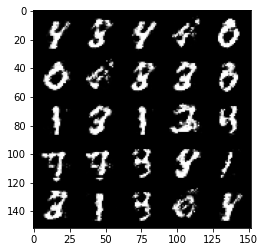

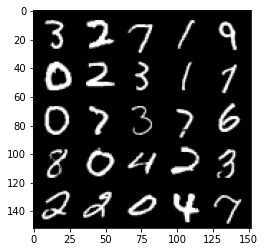

 61%|██████    | 284/469 [00:11<00:07, 25.03it/s]

Epoch 364, step 171000 -> generator loss: 0.5416753557920455, discriminator loss: 0.568213880956173


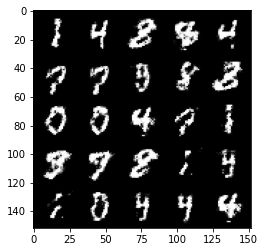

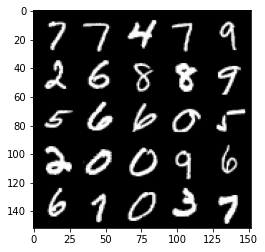

 67%|██████▋   | 315/469 [00:12<00:06, 25.30it/s]

Epoch 365, step 171500 -> generator loss: 0.5332474184632303, discriminator loss: 0.583176433324814


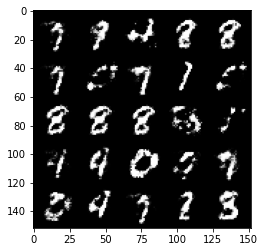

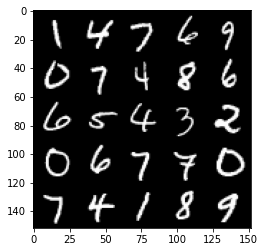

 74%|███████▎  | 345/469 [00:15<00:04, 25.38it/s]

Epoch 366, step 172000 -> generator loss: 0.5311368234753603, discriminator loss: 0.5717932673096657


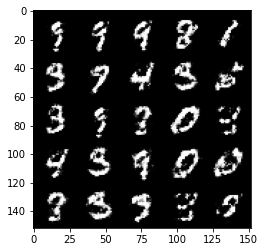

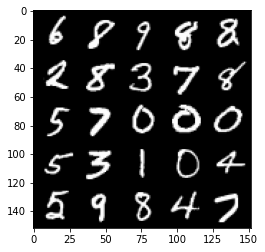

 80%|███████▉  | 375/469 [00:15<00:03, 24.95it/s]

Epoch 367, step 172500 -> generator loss: 0.521901129901409, discriminator loss: 0.595017027378082


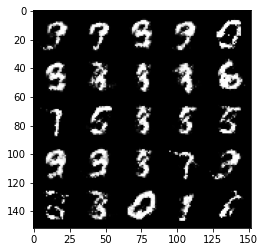

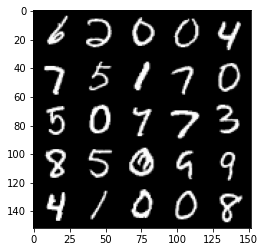

 87%|████████▋ | 408/469 [00:16<00:02, 25.67it/s]

Epoch 368, step 173000 -> generator loss: 0.5422384470701219, discriminator loss: 0.5637192143797869


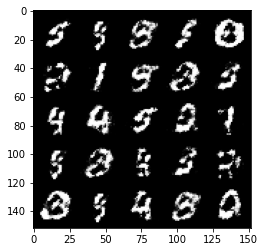

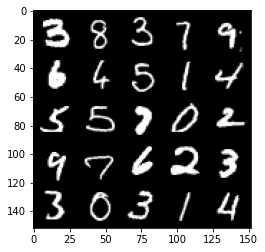

 93%|█████████▎| 437/469 [00:15<00:01, 24.47it/s]

Epoch 369, step 173500 -> generator loss: 0.5223365892171863, discriminator loss: 0.5937678748369215


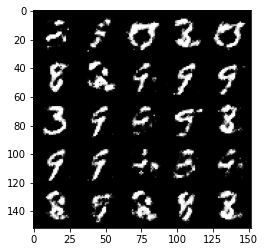

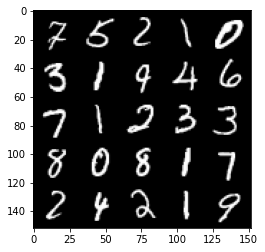

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 371, step 174000 -> generator loss: 0.5200959071516988, discriminator loss: 0.5862555434703824


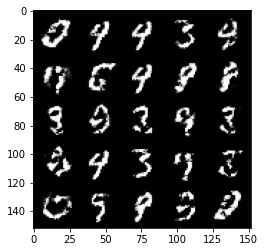

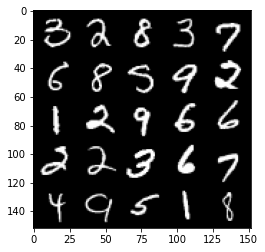

  7%|▋         | 31/469 [00:01<00:18, 24.30it/s]

Epoch 372, step 174500 -> generator loss: 0.545666950285435, discriminator loss: 0.5453774220943456


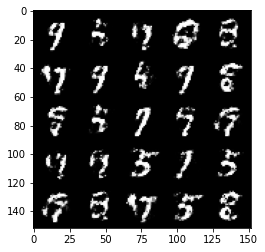

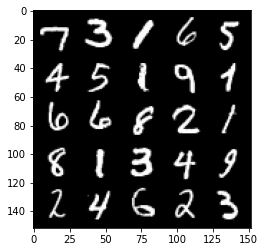

 13%|█▎        | 61/469 [00:02<00:17, 23.65it/s]

Epoch 373, step 175000 -> generator loss: 0.5364878663420674, discriminator loss: 0.5660783145427696


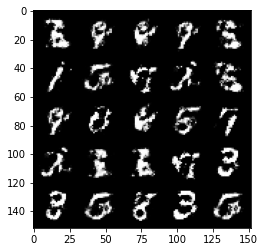

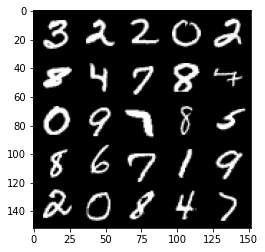

 20%|█▉        | 92/469 [00:03<00:16, 23.30it/s]

Epoch 374, step 175500 -> generator loss: 0.5503807918429372, discriminator loss: 0.5554041180014618


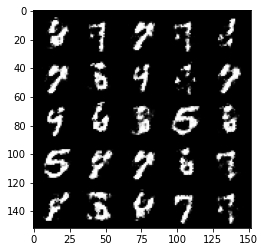

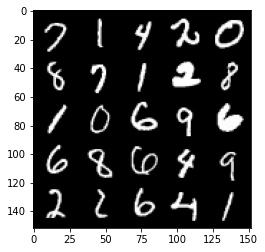

 26%|██▌       | 123/469 [00:05<00:14, 23.83it/s]

Epoch 375, step 176000 -> generator loss: 0.5316553526520731, discriminator loss: 0.5889265367984765


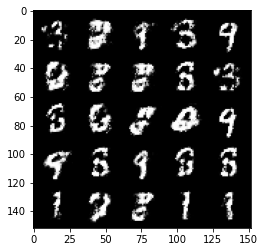

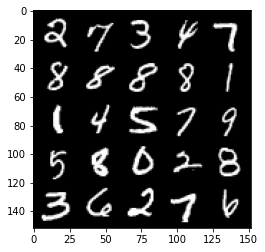

 33%|███▎      | 154/469 [00:06<00:13, 23.02it/s]

Epoch 376, step 176500 -> generator loss: 0.5272115177512166, discriminator loss: 0.5908149235248569


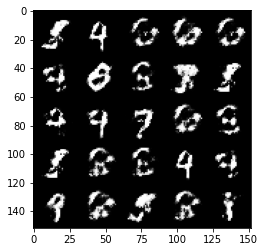

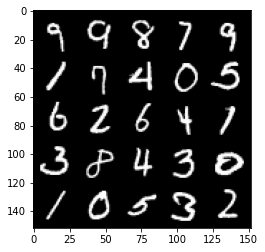

 40%|███▉      | 186/469 [00:07<00:12, 22.73it/s]

Epoch 377, step 177000 -> generator loss: 0.5354475281238555, discriminator loss: 0.5673207167387005


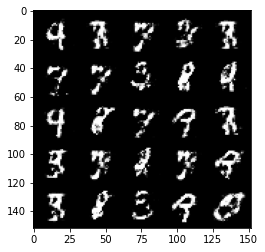

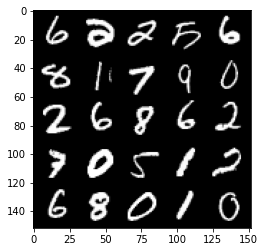

 46%|████▋     | 218/469 [00:09<00:10, 24.12it/s]

Epoch 378, step 177500 -> generator loss: 0.5306999113559717, discriminator loss: 0.5773092007637027


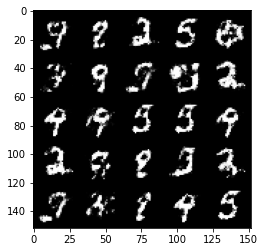

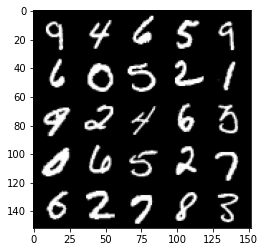

 53%|█████▎    | 248/469 [00:10<00:09, 24.35it/s]

Epoch 379, step 178000 -> generator loss: 0.5412519098520283, discriminator loss: 0.5636598166227342


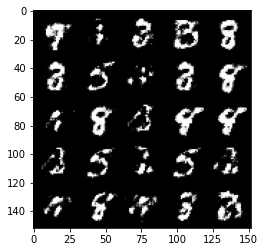

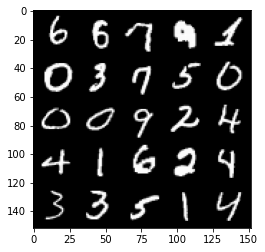

 59%|█████▉    | 279/469 [00:12<00:10, 18.58it/s]

Epoch 380, step 178500 -> generator loss: 0.5421397186517714, discriminator loss: 0.5609206528067587


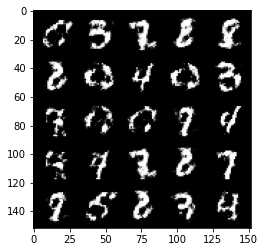

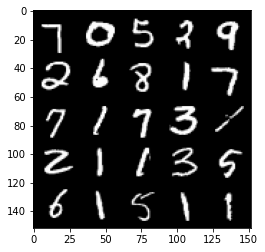

 66%|██████▌   | 309/469 [00:14<00:07, 22.49it/s]

Epoch 381, step 179000 -> generator loss: 0.5349721561670302, discriminator loss: 0.5739835419654848


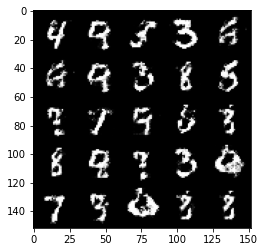

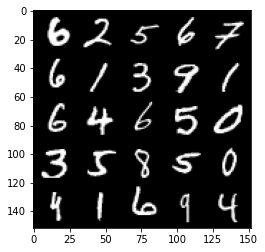

 73%|███████▎  | 341/469 [00:14<00:05, 21.92it/s]

Epoch 382, step 179500 -> generator loss: 0.5419387587308886, discriminator loss: 0.5583213467597963


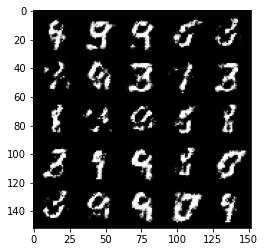

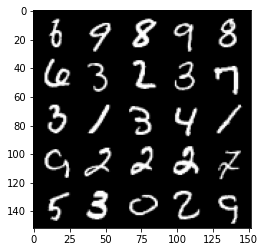

 80%|███████▉  | 373/469 [00:15<00:03, 24.47it/s]

Epoch 383, step 180000 -> generator loss: 0.5374765846729276, discriminator loss: 0.5648174732923513


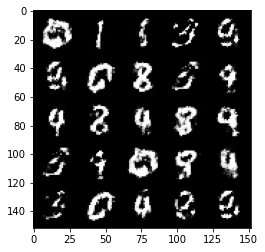

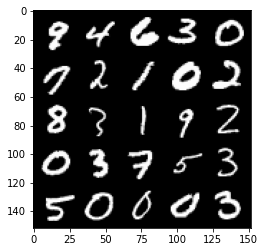

 86%|████████▌ | 404/469 [00:17<00:02, 23.90it/s]

Epoch 384, step 180500 -> generator loss: 0.5369795196652412, discriminator loss: 0.5680898531675338


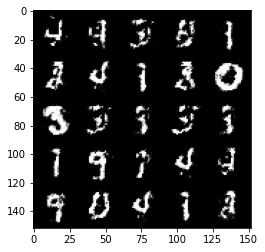

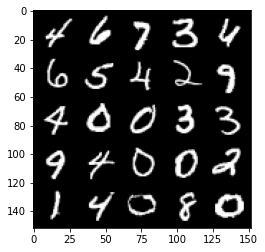

 93%|█████████▎| 434/469 [00:18<00:01, 23.27it/s]

Epoch 385, step 181000 -> generator loss: 0.5401885917782782, discriminator loss: 0.5657006535530091


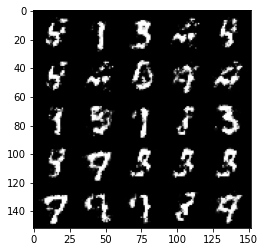

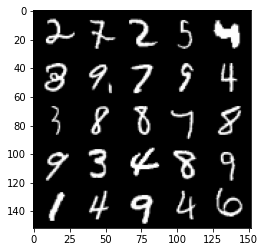

 99%|█████████▉| 466/469 [00:19<00:00, 23.89it/s]

Epoch 386, step 181500 -> generator loss: 0.5450210479497908, discriminator loss: 0.5595542315840728


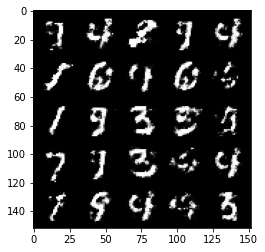

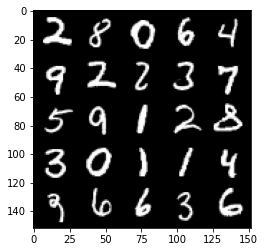

  6%|▌         | 26/469 [00:01<00:18, 23.74it/s]

Epoch 388, step 182000 -> generator loss: 0.5505160565376283, discriminator loss: 0.5530804108977315


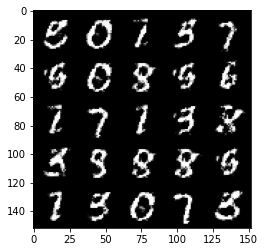

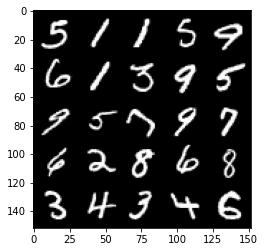

 12%|█▏        | 57/469 [00:02<00:17, 23.26it/s]

Epoch 389, step 182500 -> generator loss: 0.5408692980408671, discriminator loss: 0.5678378449678425


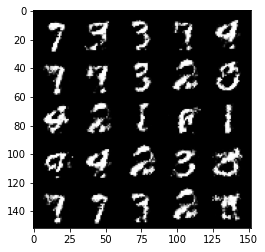

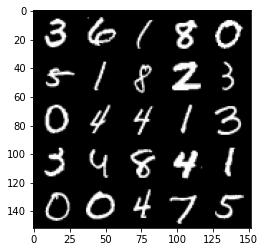

 19%|█▉        | 89/469 [00:03<00:15, 23.83it/s]

Epoch 390, step 183000 -> generator loss: 0.5426182839870451, discriminator loss: 0.5649132211208345


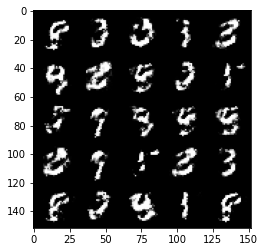

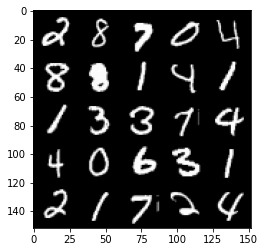

 26%|██▌       | 121/469 [00:05<00:14, 23.95it/s]

Epoch 391, step 183500 -> generator loss: 0.5502559875845903, discriminator loss: 0.551506675302983


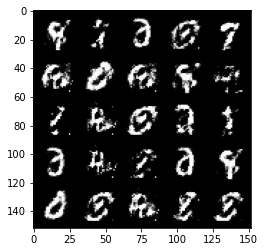

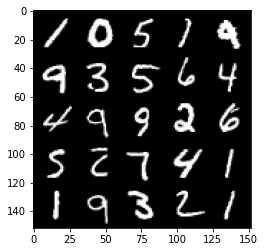

 32%|███▏      | 151/469 [00:06<00:15, 21.08it/s]

Epoch 392, step 184000 -> generator loss: 0.5456496233344081, discriminator loss: 0.5568982063531885


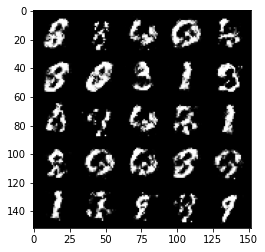

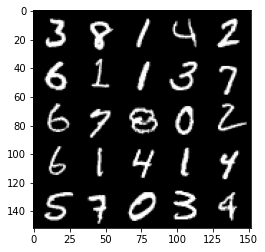

 39%|███▉      | 183/469 [00:09<00:14, 19.50it/s]

Epoch 393, step 184500 -> generator loss: 0.5477994424104687, discriminator loss: 0.5551313869953156


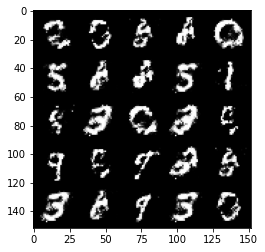

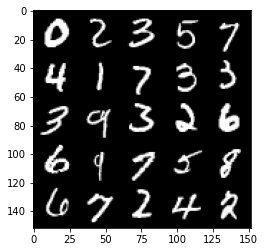

 46%|████▌     | 214/469 [00:09<00:11, 23.13it/s]

Epoch 394, step 185000 -> generator loss: 0.5401661939620974, discriminator loss: 0.5652808523178101


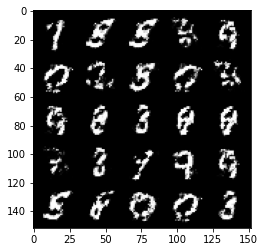

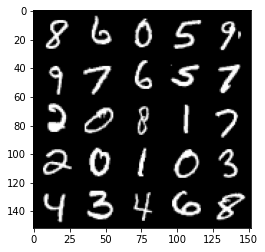

 52%|█████▏    | 245/469 [00:10<00:09, 24.15it/s]

Epoch 395, step 185500 -> generator loss: 0.5343150939941402, discriminator loss: 0.57699165558815


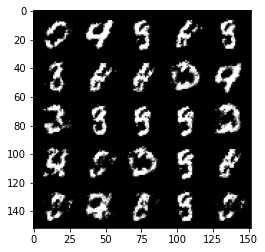

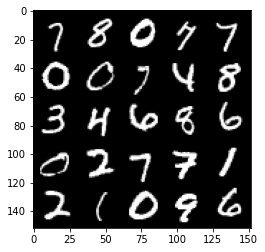

 58%|█████▊    | 274/469 [00:11<00:08, 23.25it/s]

Epoch 396, step 186000 -> generator loss: 0.5469346327185626, discriminator loss: 0.5594739544987669


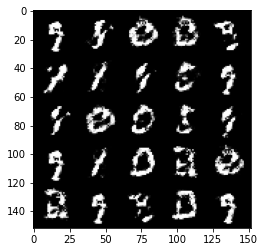

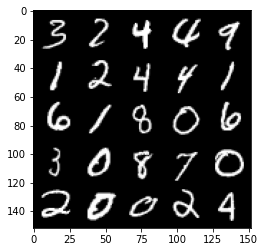

 65%|██████▌   | 307/469 [00:16<00:06, 23.26it/s]

Epoch 397, step 186500 -> generator loss: 0.5487437440156941, discriminator loss: 0.5586381236910816


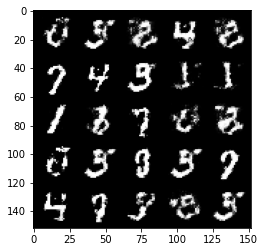

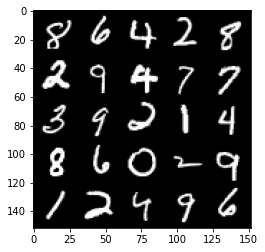

 72%|███████▏  | 338/469 [00:16<00:08, 16.22it/s]

Epoch 398, step 187000 -> generator loss: 0.5392390175461768, discriminator loss: 0.5703486711978907


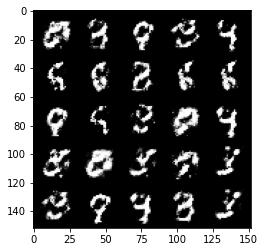

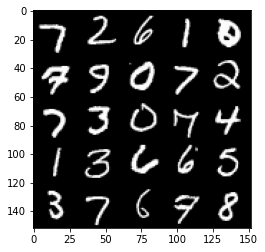

 79%|███████▊  | 369/469 [00:15<00:04, 23.85it/s]

Epoch 399, step 187500 -> generator loss: 0.5467753357291217, discriminator loss: 0.5590074895024301


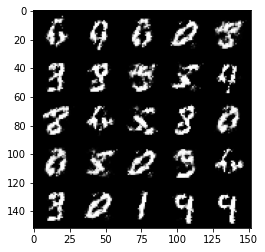

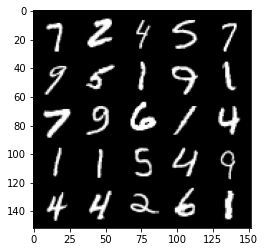

 85%|████████▌ | 400/469 [00:18<00:03, 22.55it/s]

Epoch 400, step 188000 -> generator loss: 0.5494567835927007, discriminator loss: 0.5553771690130236


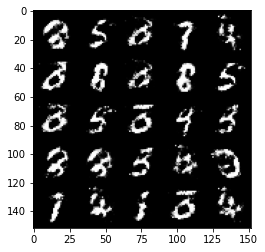

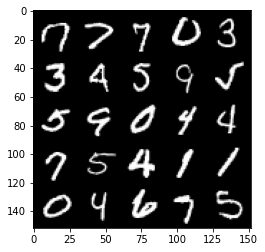

 91%|█████████▏| 429/469 [00:19<00:01, 21.76it/s]

Epoch 401, step 188500 -> generator loss: 0.5362395889759062, discriminator loss: 0.5647581282854082


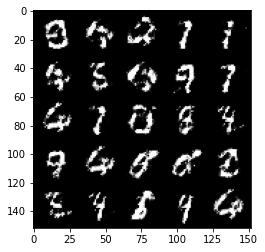

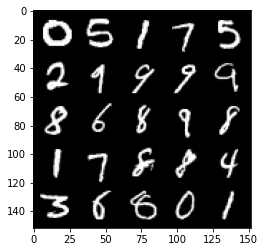

 98%|█████████▊| 460/469 [00:21<00:00, 22.21it/s]

Epoch 402, step 189000 -> generator loss: 0.5460434149503711, discriminator loss: 0.5588677561283113


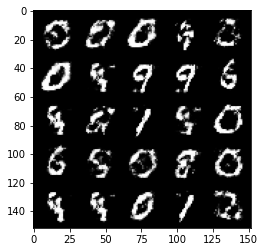

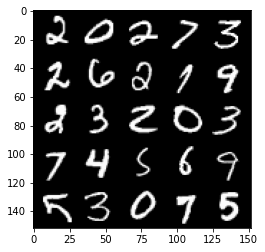

  5%|▍         | 22/469 [00:01<00:20, 21.70it/s]

Epoch 404, step 189500 -> generator loss: 0.5378079870343212, discriminator loss: 0.5662535715103153


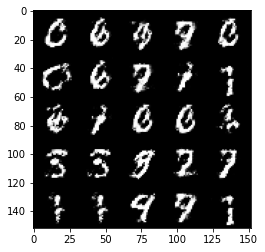

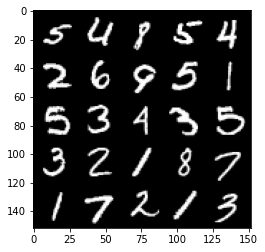

 12%|█▏        | 55/469 [00:02<00:18, 21.92it/s]

Epoch 405, step 190000 -> generator loss: 0.5252677448987961, discriminator loss: 0.5868398240804681


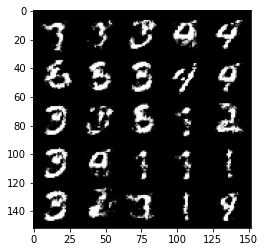

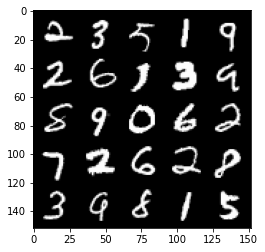

 18%|█▊        | 84/469 [00:04<00:20, 19.04it/s]

Epoch 406, step 190500 -> generator loss: 0.5467433840632435, discriminator loss: 0.5590129033327099


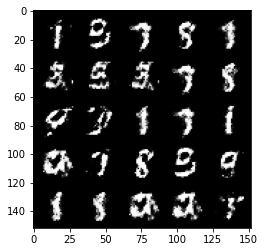

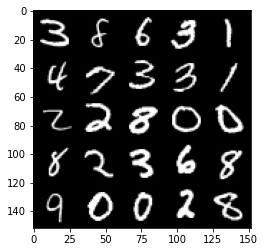

 25%|██▍       | 115/469 [00:05<00:16, 21.38it/s]

Epoch 407, step 191000 -> generator loss: 0.5315761299133297, discriminator loss: 0.5768956165313711


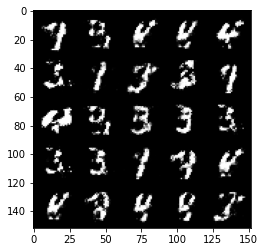

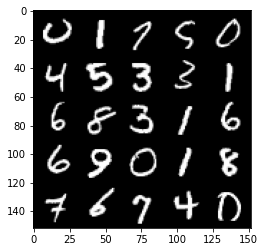

 31%|███▏      | 147/469 [00:07<00:15, 20.58it/s]

Epoch 408, step 191500 -> generator loss: 0.5453389812707905, discriminator loss: 0.5518221824765205


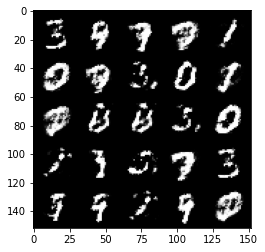

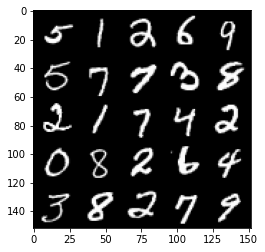

 38%|███▊      | 179/469 [00:09<00:15, 19.25it/s]

Epoch 409, step 192000 -> generator loss: 0.5492083014845849, discriminator loss: 0.5486743779182429


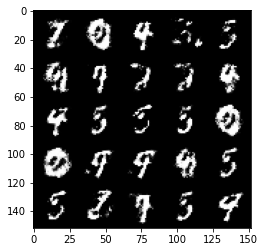

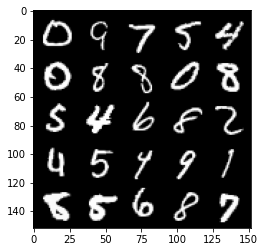

 45%|████▍     | 209/469 [00:09<00:13, 19.36it/s]

Epoch 410, step 192500 -> generator loss: 0.5696515680551528, discriminator loss: 0.5245240914821628


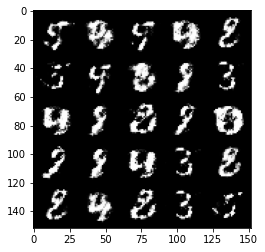

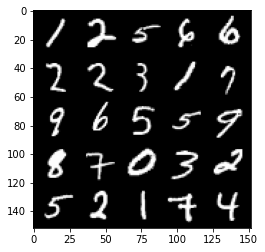

 51%|█████     | 240/469 [00:11<00:09, 22.99it/s]

Epoch 411, step 193000 -> generator loss: 0.5553645925521853, discriminator loss: 0.54115844732523


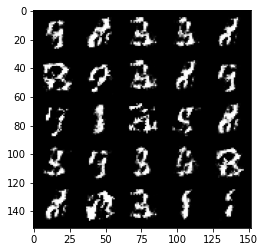

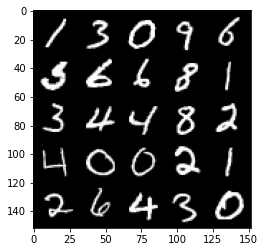

 58%|█████▊    | 271/469 [00:12<00:09, 21.82it/s]

Epoch 412, step 193500 -> generator loss: 0.5521811637282376, discriminator loss: 0.5406247956752784


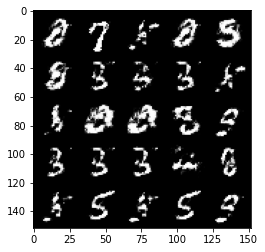

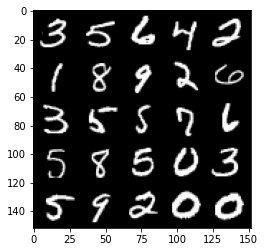

 64%|██████▍   | 301/469 [00:13<00:07, 22.29it/s]

Epoch 413, step 194000 -> generator loss: 0.5638877567052845, discriminator loss: 0.5300772745609282


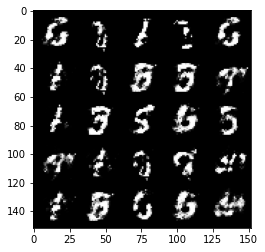

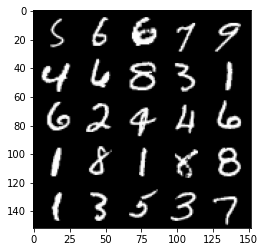

 71%|███████   | 334/469 [00:15<00:06, 19.83it/s]

Epoch 414, step 194500 -> generator loss: 0.5526465449333191, discriminator loss: 0.5482470529675479


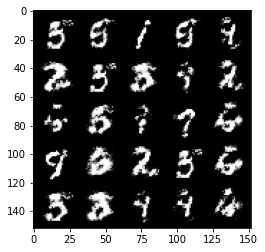

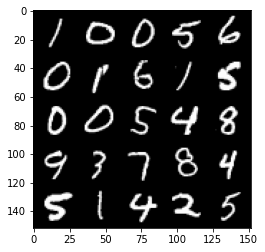

 78%|███████▊  | 365/469 [00:18<00:04, 21.77it/s]

Epoch 415, step 195000 -> generator loss: 0.5707737835645674, discriminator loss: 0.5239822154045102


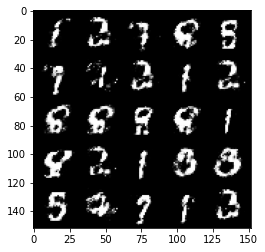

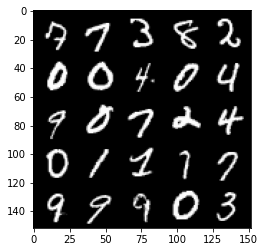

 84%|████████▍ | 395/469 [00:19<00:04, 17.66it/s]

Epoch 416, step 195500 -> generator loss: 0.5631254842877387, discriminator loss: 0.5309160472750658


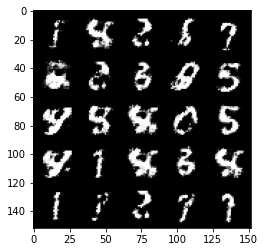

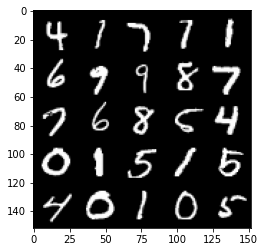

 91%|█████████ | 426/469 [00:19<00:01, 22.24it/s]

Epoch 417, step 196000 -> generator loss: 0.5388627013564113, discriminator loss: 0.5619521356821058


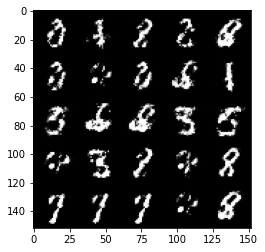

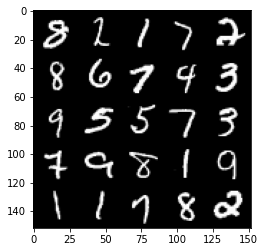

 98%|█████████▊| 458/469 [00:22<00:00, 19.78it/s]

Epoch 418, step 196500 -> generator loss: 0.5509092202782625, discriminator loss: 0.5528300840258593


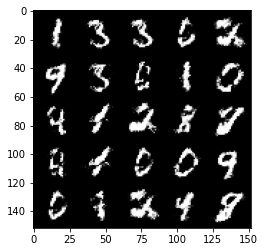

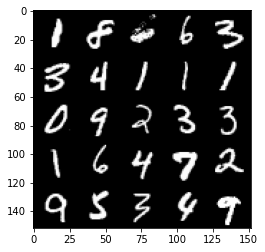

  4%|▍         | 20/469 [00:01<00:21, 20.79it/s]

Epoch 420, step 197000 -> generator loss: 0.517476930499077, discriminator loss: 0.5982145092487333


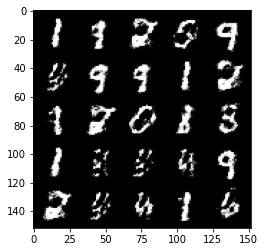

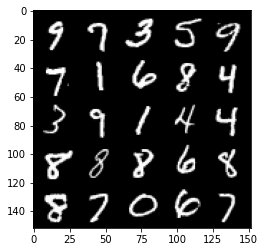

 11%|█         | 51/469 [00:02<00:18, 22.82it/s]

Epoch 421, step 197500 -> generator loss: 0.5173015471696852, discriminator loss: 0.5914052038192743


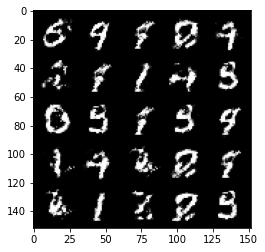

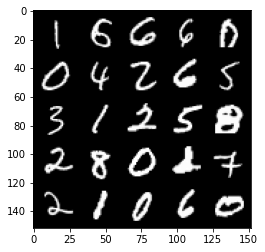

 17%|█▋        | 82/469 [00:03<00:17, 22.04it/s]

Epoch 422, step 198000 -> generator loss: 0.5139019011855126, discriminator loss: 0.5981948444843288


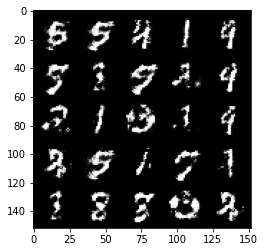

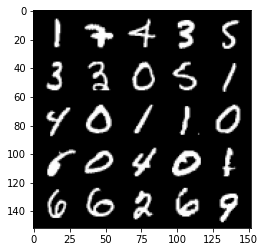

 24%|██▎       | 111/469 [00:06<00:15, 22.62it/s]

Epoch 423, step 198500 -> generator loss: 0.5293100832104677, discriminator loss: 0.5768010574579236


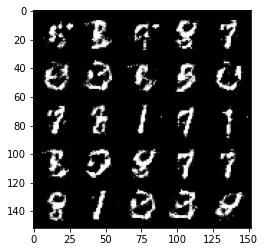

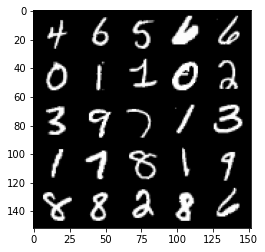

 30%|███       | 142/469 [00:07<00:13, 24.29it/s]

Epoch 424, step 199000 -> generator loss: 0.5515513747930528, discriminator loss: 0.549557220101357


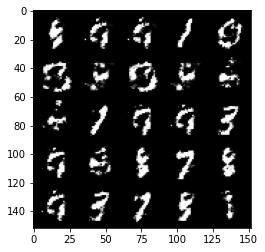

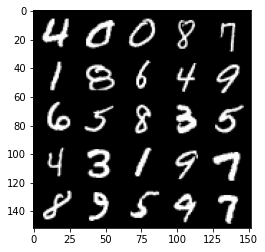

 37%|███▋      | 174/469 [00:07<00:12, 24.08it/s]

Epoch 425, step 199500 -> generator loss: 0.548674919784069, discriminator loss: 0.5531311150789261


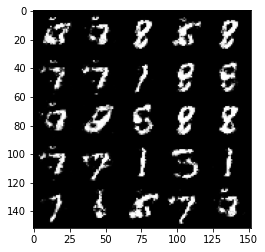

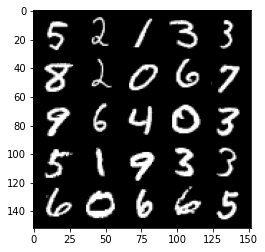

 44%|████▎     | 205/469 [00:08<00:11, 22.66it/s]

Epoch 426, step 200000 -> generator loss: 0.5314593165516859, discriminator loss: 0.580787464737892


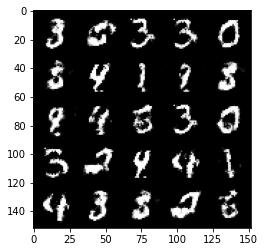

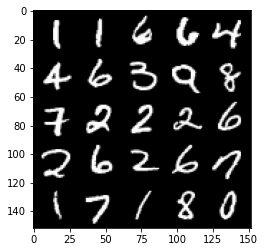

 50%|█████     | 235/469 [00:10<00:09, 23.53it/s]

Epoch 427, step 200500 -> generator loss: 0.5483900001645087, discriminator loss: 0.5558039603233336


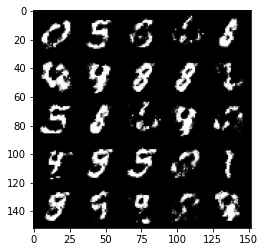

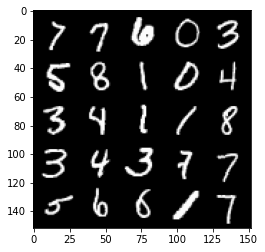

 57%|█████▋    | 268/469 [00:11<00:08, 23.35it/s]

Epoch 428, step 201000 -> generator loss: 0.5335664480924607, discriminator loss: 0.5732187216877943


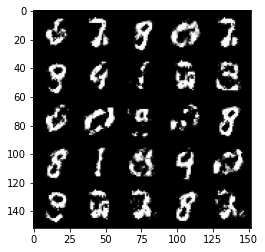

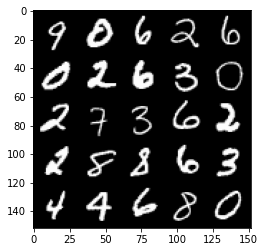

 64%|██████▍   | 299/469 [00:12<00:07, 22.66it/s]

Epoch 429, step 201500 -> generator loss: 0.5371177418828016, discriminator loss: 0.5660144774913786


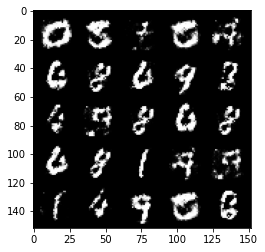

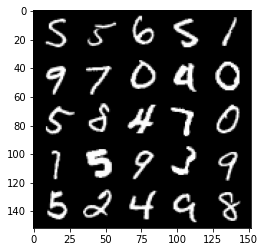

 70%|███████   | 330/469 [00:14<00:05, 24.03it/s]

Epoch 430, step 202000 -> generator loss: 0.5371998782753944, discriminator loss: 0.5635436134338369


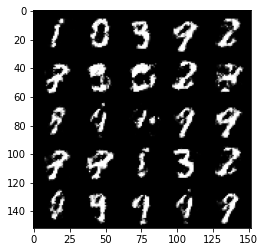

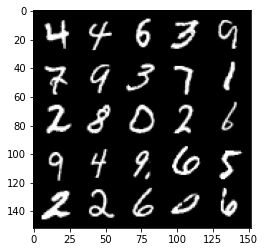

 77%|███████▋  | 359/469 [00:15<00:04, 22.52it/s]

Epoch 431, step 202500 -> generator loss: 0.5520113145709037, discriminator loss: 0.5457017332315444


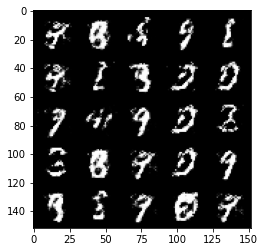

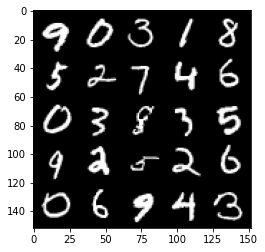

 83%|████████▎ | 391/469 [00:16<00:03, 23.82it/s]

Epoch 432, step 203000 -> generator loss: 0.5489706063270564, discriminator loss: 0.5462453402280809


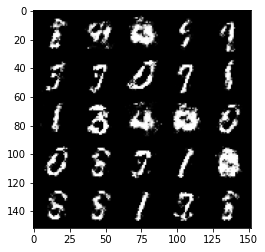

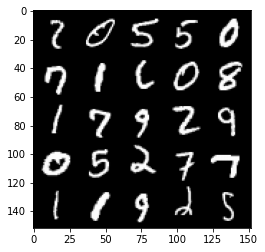

 90%|████████▉ | 422/469 [00:18<00:01, 23.92it/s]

Epoch 433, step 203500 -> generator loss: 0.5487136034965514, discriminator loss: 0.5544782109856609


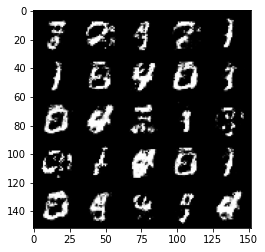

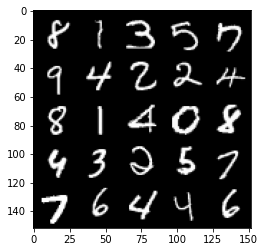

 97%|█████████▋| 454/469 [00:20<00:00, 16.94it/s]

Epoch 434, step 204000 -> generator loss: 0.5489518076777461, discriminator loss: 0.5490015590190885


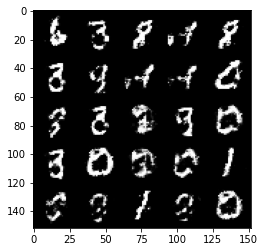

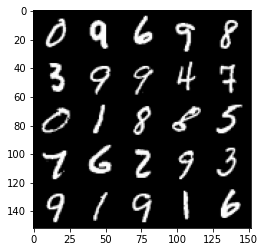

  3%|▎         | 16/469 [00:00<00:21, 20.94it/s]

Epoch 436, step 204500 -> generator loss: 0.529693460226059, discriminator loss: 0.5793949413299557


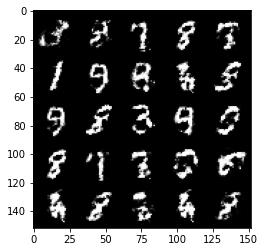

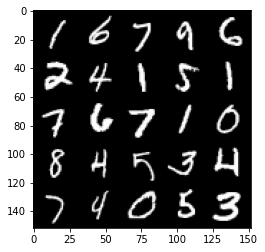

 10%|▉         | 45/469 [00:01<00:18, 22.43it/s]

Epoch 437, step 205000 -> generator loss: 0.5359975028038024, discriminator loss: 0.5679265292882921


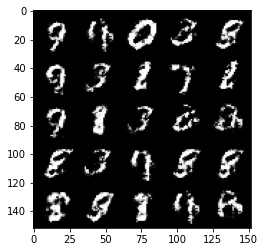

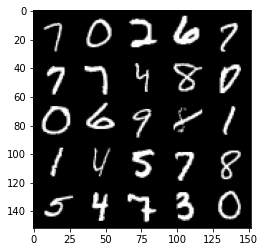

 16%|█▋        | 77/469 [00:03<00:16, 24.37it/s]

Epoch 438, step 205500 -> generator loss: 0.5264446160793304, discriminator loss: 0.5850125961303702


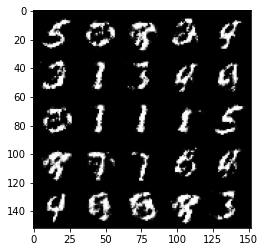

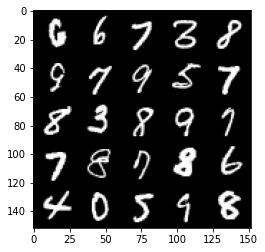

 23%|██▎       | 109/469 [00:04<00:15, 23.31it/s]

Epoch 439, step 206000 -> generator loss: 0.5325693411827092, discriminator loss: 0.5772452382445336


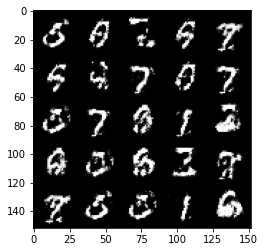

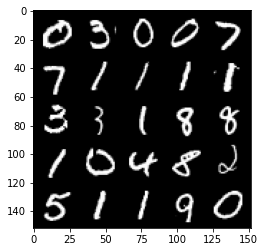

 30%|██▉       | 139/469 [00:05<00:13, 24.57it/s]

Epoch 440, step 206500 -> generator loss: 0.5443232282400128, discriminator loss: 0.5569920223951342


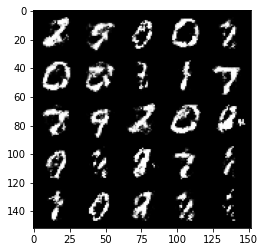

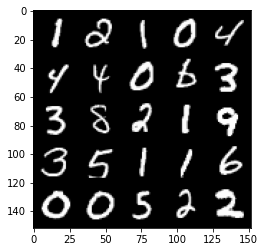

 36%|███▌      | 170/469 [00:07<00:12, 23.85it/s]

Epoch 441, step 207000 -> generator loss: 0.5400768662691119, discriminator loss: 0.5638193765282633


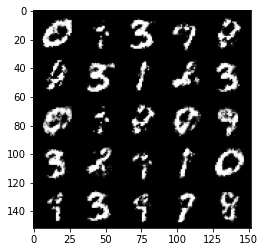

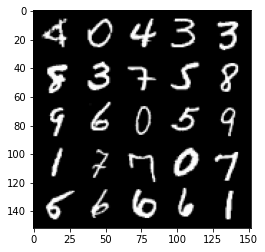

 43%|████▎     | 200/469 [00:09<00:12, 21.12it/s]

Epoch 442, step 207500 -> generator loss: 0.5080753071904185, discriminator loss: 0.612047420620918


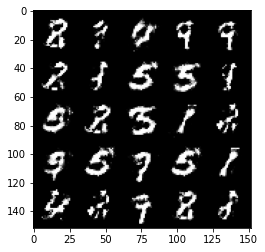

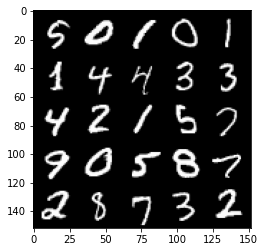

 50%|████▉     | 233/469 [00:10<00:11, 21.11it/s]

Epoch 443, step 208000 -> generator loss: 0.5241837644577031, discriminator loss: 0.5880266994237903


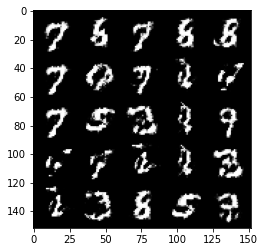

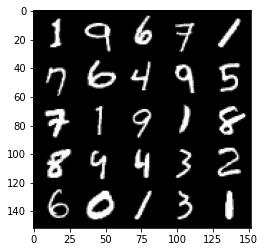

 56%|█████▋    | 264/469 [00:11<00:08, 24.36it/s]

Epoch 444, step 208500 -> generator loss: 0.5274370564222333, discriminator loss: 0.5861044538021092


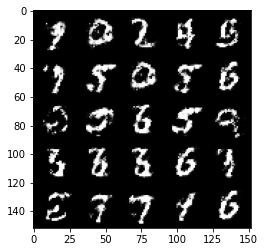

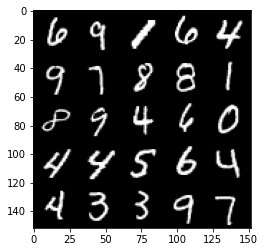

 63%|██████▎   | 294/469 [00:11<00:06, 25.16it/s]

Epoch 445, step 209000 -> generator loss: 0.5310613122582434, discriminator loss: 0.5797707761526107


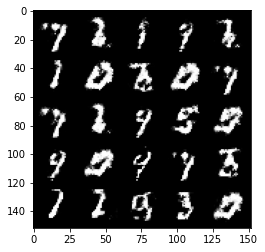

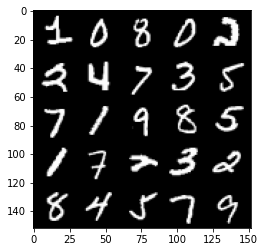

 69%|██████▉   | 324/469 [00:12<00:05, 25.52it/s]

Epoch 446, step 209500 -> generator loss: 0.5425518252849575, discriminator loss: 0.5699980389475825


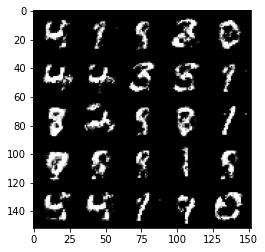

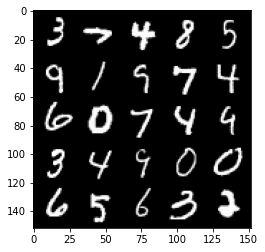

 76%|███████▌  | 356/469 [00:14<00:04, 25.25it/s]

Epoch 447, step 210000 -> generator loss: 0.5331704380512241, discriminator loss: 0.5804370800256732


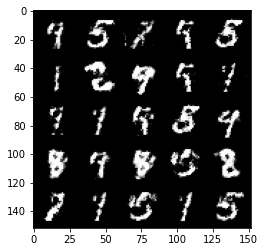

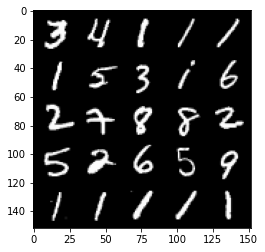

 82%|████████▏ | 386/469 [00:15<00:03, 24.60it/s]

Epoch 448, step 210500 -> generator loss: 0.5406646821498873, discriminator loss: 0.5640104519128802


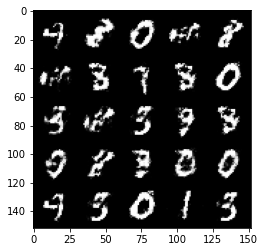

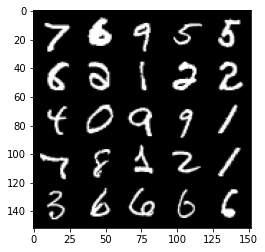

 89%|████████▉ | 417/469 [00:16<00:02, 24.98it/s]

Epoch 449, step 211000 -> generator loss: 0.5178261146545406, discriminator loss: 0.5952404904365542


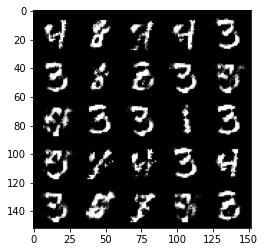

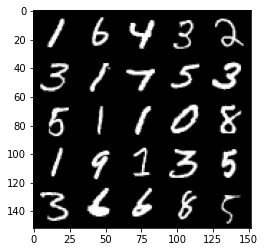

 96%|█████████▌| 450/469 [00:18<00:00, 25.48it/s]

Epoch 450, step 211500 -> generator loss: 0.5461124626398088, discriminator loss: 0.5496432034373283


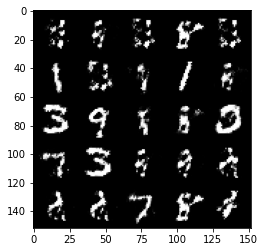

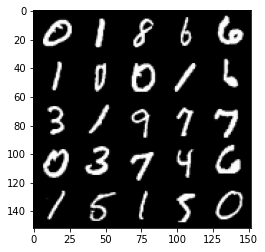

  3%|▎         | 12/469 [00:00<00:18, 24.48it/s]

Epoch 452, step 212000 -> generator loss: 0.5400641070008279, discriminator loss: 0.5642169928550715


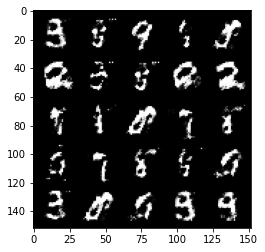

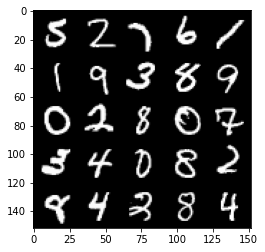

  9%|▉         | 42/469 [00:01<00:18, 23.32it/s]

Epoch 453, step 212500 -> generator loss: 0.5369150997996331, discriminator loss: 0.5679435796737674


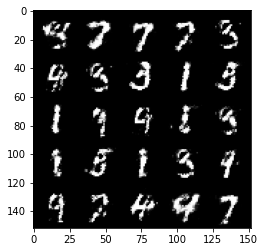

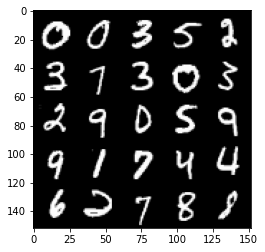

 16%|█▌        | 73/469 [00:02<00:15, 25.38it/s]

Epoch 454, step 213000 -> generator loss: 0.5254556784033776, discriminator loss: 0.5870015106201172


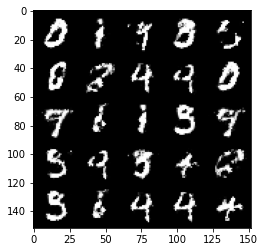

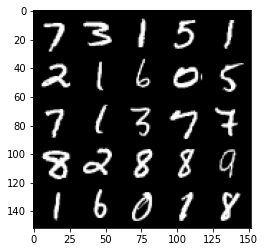

 22%|██▏       | 105/469 [00:04<00:14, 25.19it/s]

Epoch 455, step 213500 -> generator loss: 0.5365347298979755, discriminator loss: 0.5724376748800276


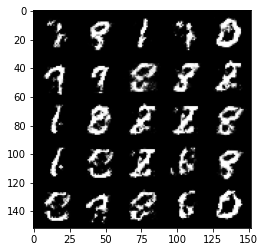

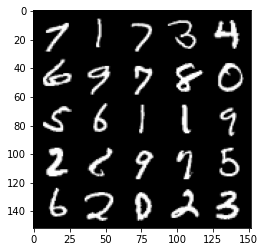

 29%|██▉       | 135/469 [00:05<00:13, 25.17it/s]

Epoch 456, step 214000 -> generator loss: 0.5240725285410881, discriminator loss: 0.585950245141983


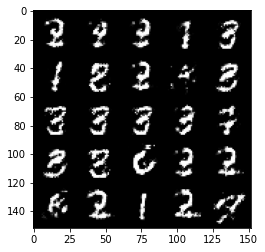

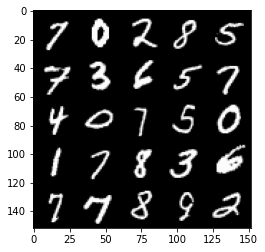

 35%|███▌      | 165/469 [00:06<00:12, 24.69it/s]

Epoch 457, step 214500 -> generator loss: 0.5344101345539094, discriminator loss: 0.569926882684231


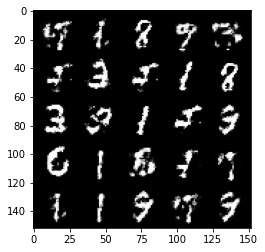

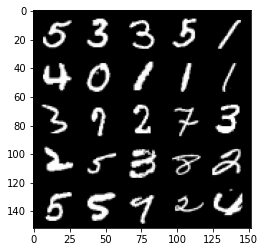

 42%|████▏     | 198/469 [00:07<00:10, 25.38it/s]

Epoch 458, step 215000 -> generator loss: 0.5478571956753729, discriminator loss: 0.5595386853218072


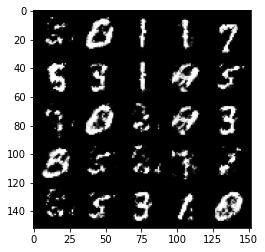

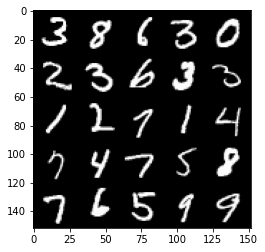

 49%|████▊     | 228/469 [00:10<00:12, 19.56it/s]

Epoch 459, step 215500 -> generator loss: 0.5236764358878132, discriminator loss: 0.5883204797506328


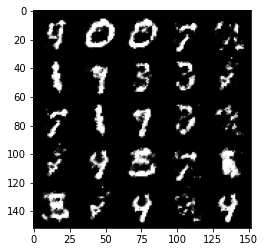

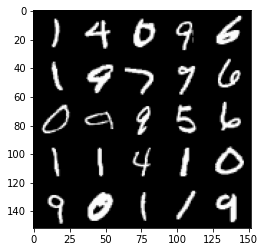

 55%|█████▌    | 259/469 [00:11<00:09, 22.56it/s]

Epoch 460, step 216000 -> generator loss: 0.5361118727922439, discriminator loss: 0.5708495724201209


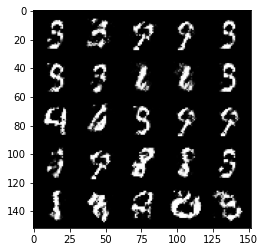

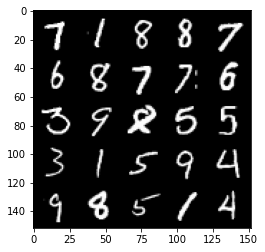

 62%|██████▏   | 289/469 [00:12<00:07, 24.20it/s]

Epoch 461, step 216500 -> generator loss: 0.528066042304039, discriminator loss: 0.5823302264213561


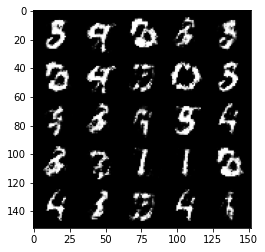

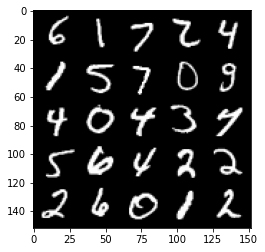

 68%|██████▊   | 321/469 [00:13<00:06, 23.77it/s]

Epoch 462, step 217000 -> generator loss: 0.532260669410229, discriminator loss: 0.5776241227388385


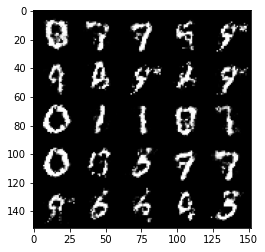

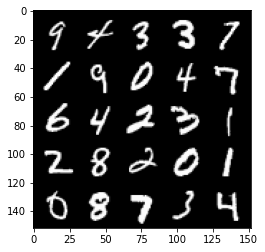

 75%|███████▍  | 351/469 [00:14<00:05, 22.61it/s]

Epoch 463, step 217500 -> generator loss: 0.5371356477141381, discriminator loss: 0.5720891985893245


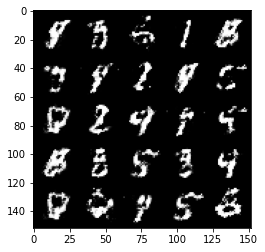

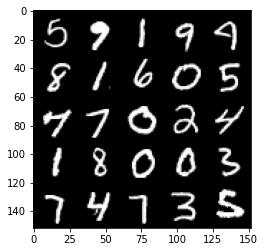

 82%|████████▏ | 383/469 [00:17<00:05, 16.19it/s]

Epoch 464, step 218000 -> generator loss: 0.5120121089220049, discriminator loss: 0.6035277470350257


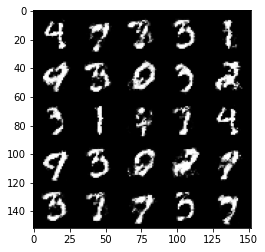

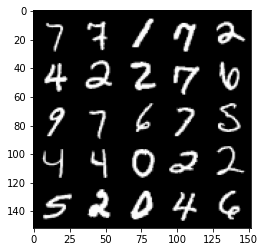

 88%|████████▊ | 413/469 [00:18<00:02, 22.55it/s]

Epoch 465, step 218500 -> generator loss: 0.5125845547914504, discriminator loss: 0.604166562080383


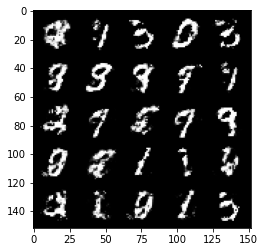

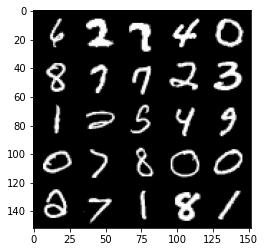

 95%|█████████▍| 445/469 [00:18<00:01, 23.47it/s]

Epoch 466, step 219000 -> generator loss: 0.5114492060542106, discriminator loss: 0.6017084455490105


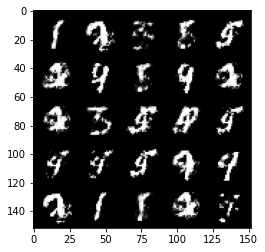

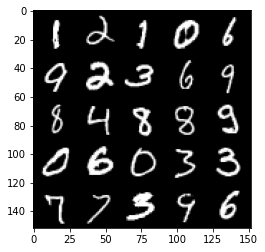

  1%|▏         | 6/469 [00:00<00:22, 20.71it/s]

Epoch 468, step 219500 -> generator loss: 0.5211166706085205, discriminator loss: 0.5834265348911282


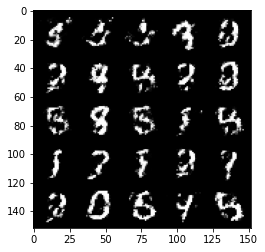

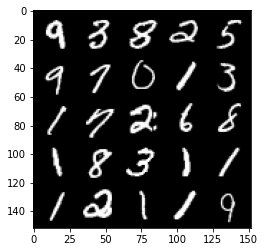

  8%|▊         | 39/469 [00:01<00:17, 24.13it/s]

Epoch 469, step 220000 -> generator loss: 0.5471779708862305, discriminator loss: 0.5529800122976304


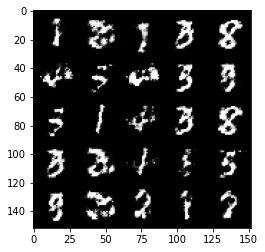

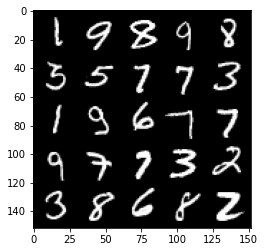

 14%|█▍        | 68/469 [00:02<00:16, 23.95it/s]

Epoch 470, step 220500 -> generator loss: 0.5298616410493855, discriminator loss: 0.5751564434766765


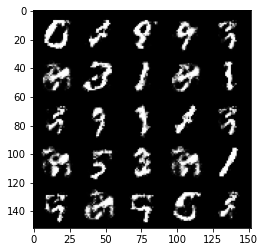

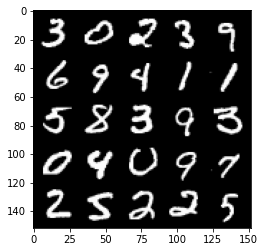

 22%|██▏       | 101/469 [00:04<00:17, 21.50it/s]

Epoch 471, step 221000 -> generator loss: 0.5367386811971665, discriminator loss: 0.5685131878852839


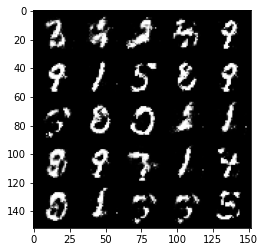

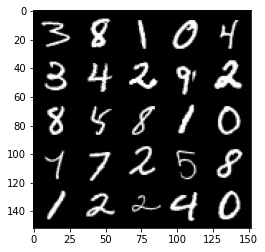

 28%|██▊       | 131/469 [00:05<00:15, 22.06it/s]

Epoch 472, step 221500 -> generator loss: 0.5285782163739202, discriminator loss: 0.583477280378342


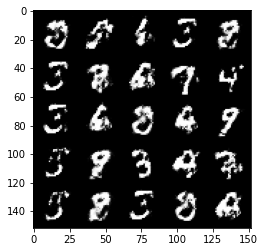

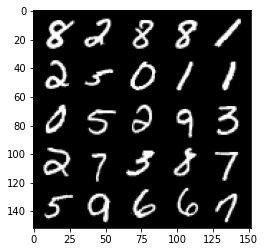

 35%|███▍      | 163/469 [00:06<00:13, 23.37it/s]

Epoch 473, step 222000 -> generator loss: 0.5288035748004916, discriminator loss: 0.5807206226587295


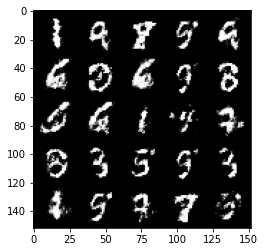

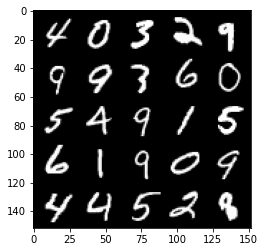

 41%|████      | 193/469 [00:08<00:12, 22.43it/s]

Epoch 474, step 222500 -> generator loss: 0.5209788200259212, discriminator loss: 0.591047739505768


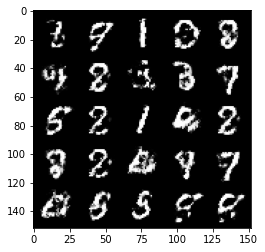

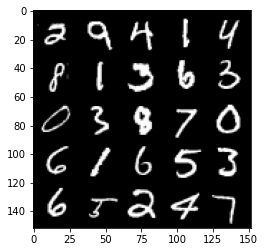

 48%|████▊     | 225/469 [00:09<00:09, 24.55it/s]

Epoch 475, step 223000 -> generator loss: 0.5120444129109382, discriminator loss: 0.6029175581932066


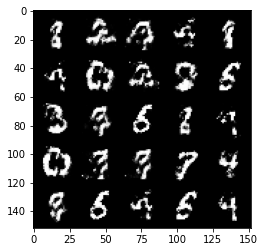

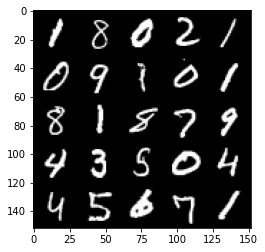

 55%|█████▍    | 256/469 [00:11<00:09, 23.56it/s]

Epoch 476, step 223500 -> generator loss: 0.516000019967556, discriminator loss: 0.5868792196512221


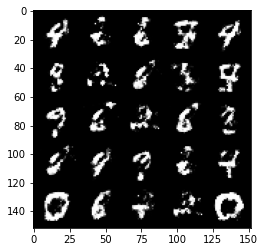

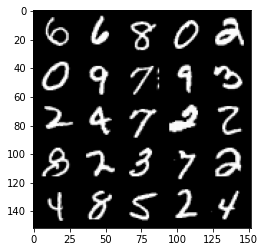

 61%|██████    | 285/469 [00:12<00:08, 22.06it/s]

Epoch 477, step 224000 -> generator loss: 0.517846421420574, discriminator loss: 0.5935229587554933


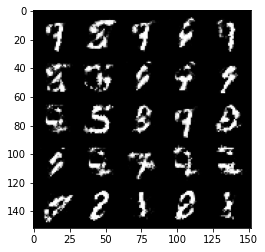

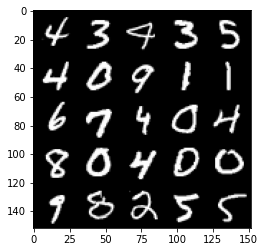

 67%|██████▋   | 316/469 [00:13<00:06, 22.70it/s]

Epoch 478, step 224500 -> generator loss: 0.5339600276350974, discriminator loss: 0.5745571695566174


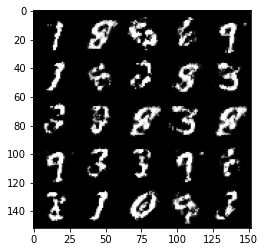

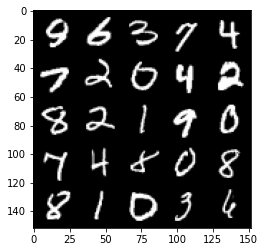

 74%|███████▍  | 349/469 [00:15<00:05, 23.73it/s]

Epoch 479, step 225000 -> generator loss: 0.53094679737091, discriminator loss: 0.578495563149452


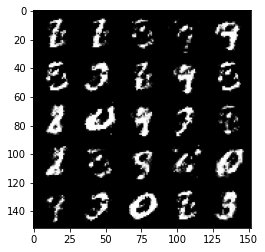

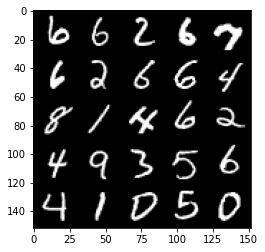

 81%|████████  | 378/469 [00:16<00:03, 22.86it/s]

Epoch 480, step 225500 -> generator loss: 0.5281391675472259, discriminator loss: 0.5827855522632602


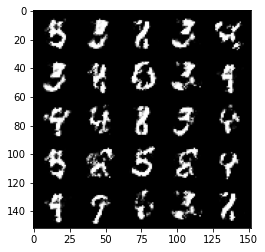

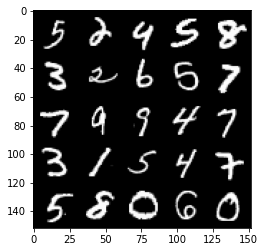

 87%|████████▋ | 409/469 [00:17<00:02, 23.11it/s]

Epoch 481, step 226000 -> generator loss: 0.5481926487684251, discriminator loss: 0.5549932614564894


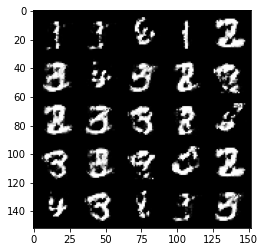

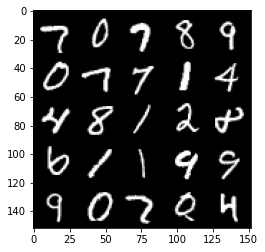

 94%|█████████▍| 442/469 [00:19<00:01, 21.61it/s]

Epoch 482, step 226500 -> generator loss: 0.5239245442748072, discriminator loss: 0.5867173788547518


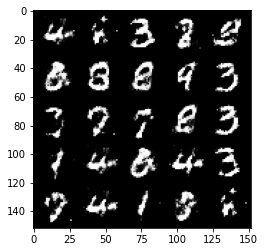

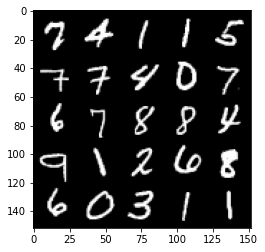

  1%|          | 4/469 [00:00<00:23, 19.55it/s]

Epoch 484, step 227000 -> generator loss: 0.5231823772192002, discriminator loss: 0.5885317049026492


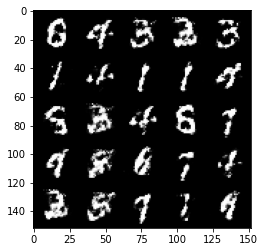

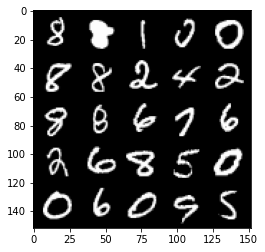

  7%|▋         | 33/469 [00:01<00:18, 23.07it/s]

Epoch 485, step 227500 -> generator loss: 0.5253863022327424, discriminator loss: 0.5830815119743347


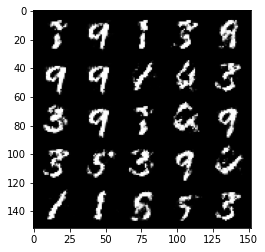

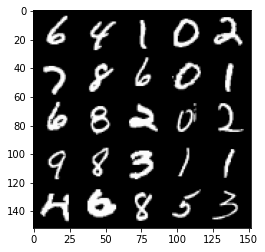

 14%|█▎        | 64/469 [00:02<00:17, 22.89it/s]

Epoch 486, step 228000 -> generator loss: 0.5089383565783501, discriminator loss: 0.6090408413410188


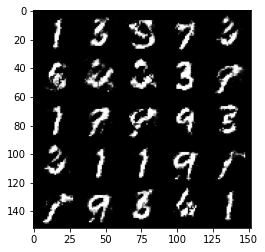

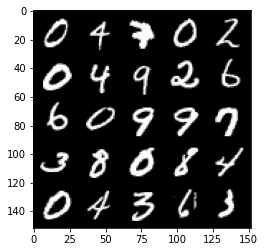

 20%|██        | 96/469 [00:04<00:15, 24.40it/s]

Epoch 487, step 228500 -> generator loss: 0.5164769535064699, discriminator loss: 0.6007175728082647


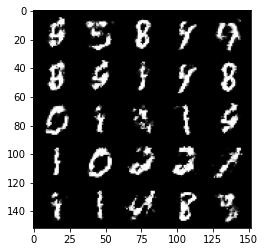

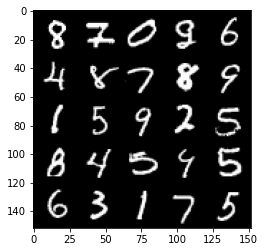

 27%|██▋       | 128/469 [00:05<00:14, 23.19it/s]

Epoch 488, step 229000 -> generator loss: 0.5253730642795561, discriminator loss: 0.5806553847789758


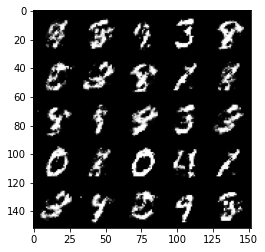

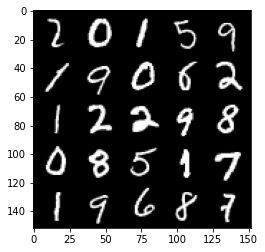

 34%|███▍      | 159/469 [00:06<00:12, 25.51it/s]

Epoch 489, step 229500 -> generator loss: 0.5129512679576878, discriminator loss: 0.6010463703870774


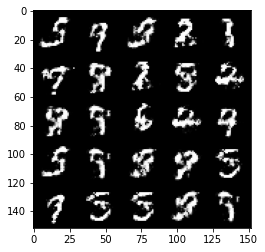

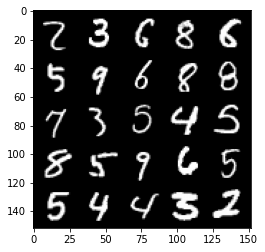

 40%|████      | 188/469 [00:07<00:11, 25.18it/s]

Epoch 490, step 230000 -> generator loss: 0.5174884469509122, discriminator loss: 0.594366363763809


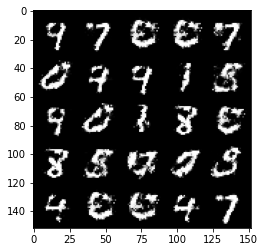

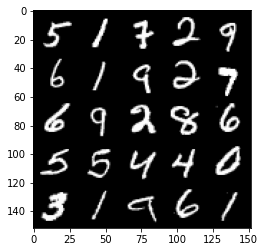

 47%|████▋     | 221/469 [00:08<00:09, 25.54it/s]

Epoch 491, step 230500 -> generator loss: 0.5095548689365386, discriminator loss: 0.6083090436458584


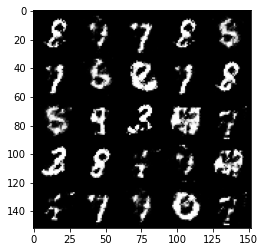

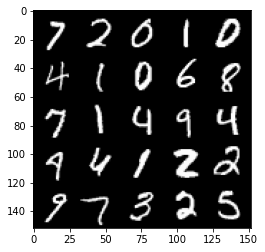

 54%|█████▎    | 251/469 [00:10<00:08, 24.36it/s]

Epoch 492, step 231000 -> generator loss: 0.5403029987215991, discriminator loss: 0.559872725129127


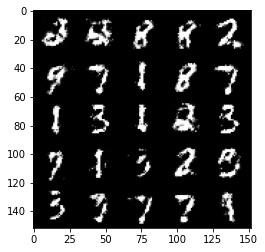

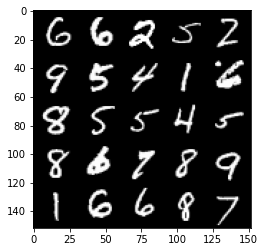

 60%|██████    | 283/469 [00:11<00:07, 25.06it/s]

Epoch 493, step 231500 -> generator loss: 0.5309104581475262, discriminator loss: 0.566813296079635


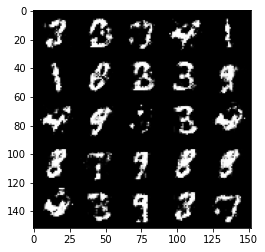

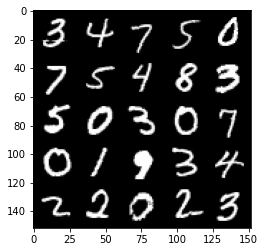

 67%|██████▋   | 313/469 [00:13<00:06, 23.27it/s]

Epoch 494, step 232000 -> generator loss: 0.5462665719985959, discriminator loss: 0.5509794823527336


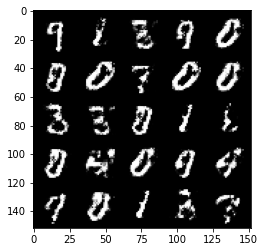

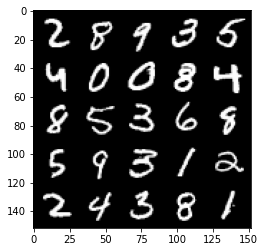

 73%|███████▎  | 344/469 [00:13<00:04, 25.24it/s]

Epoch 495, step 232500 -> generator loss: 0.5343962062597274, discriminator loss: 0.5632051171064377


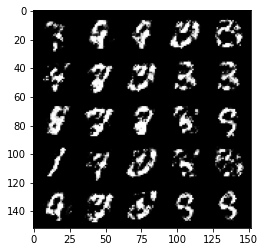

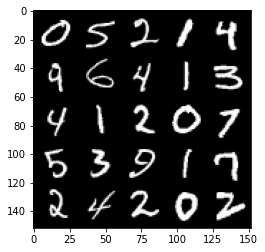

 80%|████████  | 376/469 [00:15<00:03, 24.39it/s]

Epoch 496, step 233000 -> generator loss: 0.5565155498385431, discriminator loss: 0.5407210062146188


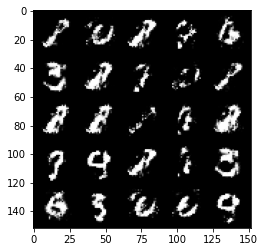

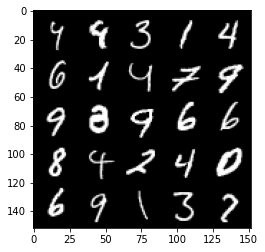

 87%|████████▋ | 406/469 [00:17<00:02, 21.37it/s]

Epoch 497, step 233500 -> generator loss: 0.5181400052905082, discriminator loss: 0.5908206974267959


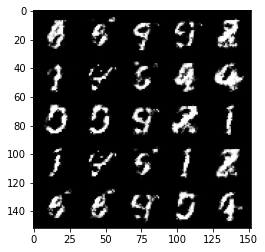

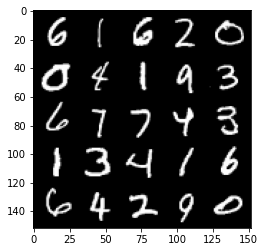

 93%|█████████▎| 437/469 [00:23<00:01, 17.27it/s]

Epoch 498, step 234000 -> generator loss: 0.5213083369135852, discriminator loss: 0.583090411067009


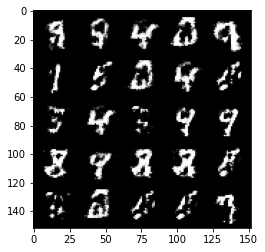

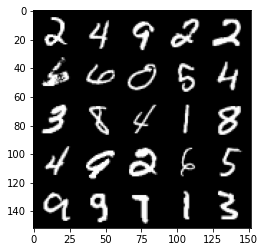

100%|██████████| 469/469 [00:22<00:00, 20.55it/s]


In [9]:
cur_step = 0
mean_generator_loss = 0
mean_discriminator_loss = 0
generator_loss = False
for epoch in range(n_epochs):

    # data loader return the batches
    for org, _ in tqdm(dataloader):
        cur_batch_size = len(org)
        # flattening batch of org images from dataset
        org = org.view(cur_batch_size, -1).to(device)

        ## updating discriminator ##
        # zeroing gradients before back prop
        disc_opt.zero_grad()
        discriminator_loss = disc_loss(gen, disc, criterion, org, cur_batch_size, noise_dim, device)
        # update gradients
        discriminator_loss.backward(retain_graph=True)
        # update optimizer
        disc_opt.step()
        
        ## updating generator ##
        gen_opt.zero_grad()
        generator_loss = gen_loss(gen, disc, criterion, cur_batch_size, noise_dim, device)
        generator_loss.backward(retain_graph=True)
        gen_opt.step()
        disc_opt.step()

        # calculating average discriminator and generator loss
        mean_discriminator_loss += discriminator_loss.item() / display_step
        mean_generator_loss += generator_loss.item() / display_step

        # visualization
        if cur_step % display_step == 0 and cur_step > 0:
            print(f'Epoch {epoch}, step {cur_step} -> generator loss: {mean_generator_loss}, discriminator loss: {mean_discriminator_loss}')
            gen_noise = get_noise(cur_batch_size, noise_dim, device=device)
            generated = gen(gen_noise)
            show_tensor_images(generated)
            show_tensor_images(org)
            mean_generator_loss = 0
            mean_discriminator_loss = 0
        cur_step += 1





## Saving the model

In this step we will save this trained model for further usage and avoid spending 160+ minutes for training it.

In [10]:
torch.save(gen.state_Adict(), 'models/MNIST-Gen-v1.0.pth')
torch.save(disc.state_dict(), 'models/MNIST-Disc-v1.0.pth')

## Checking the quality of GAN

Lets generated 25 samples of images based on MNIST dataset trained with a very simple and shallow GAN.

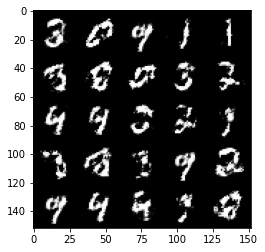

In [27]:
test_noise = get_noise(25, 64, device='cuda')
generated_test = gen(test_noise)
show_tensor_images(generated_test)

--------
# Ramin F. - @SimplyRamin